In [1]:
%load_ext autoreload
%autoreload 2
%matplotlib inline
from experiment_train import *
from experiment_datasets import *
from helpers import *
import scipy.stats as st
import matplotlib
import pickle
import scipy
from scipy.optimize import curve_fit
from derivative_decay import *

Using TensorFlow backend.


Initialized TensorFlow


In [2]:
# dimensions to try
Ns = [int(t) for t in np.linspace(50, 1500, 10)]

# how much repetitions for each experiment are needed?
repetitions = 10

print('Sizes', Ns)
print('Repetitions', repetitions)
print('Total runs', len(Ns) * repetitions)

Sizes [50, 211, 372, 533, 694, 855, 1016, 1177, 1338, 1500]
Repetitions 10
Total runs 100


In [3]:
def fault_tolerance_var_delta(exp):
    """ Compute variance of the error """
    # obtaining data points
    #data = exp.get_inputs(len(exp.x_train) + len(exp.x_test))
    data = exp.x_train[0:1]

    # obtaining errors and bounds for data points
    rmean, rstd = exp.run(data, repetitions = 50000)

    return {'var_delta': np.mean(rstd['experiment'] ** 2)}

In [4]:
# parameters for each experiment
parameters = {'reg_spec': {'continuous': [1e-4, 1e-2],
                           'vardelta': {'p': 0.01, 'lambda': 0.001}},
              'do_print': 'plot', 'epochs': 30, 'p': 0.01}

# what to measure?
to_run = [show_neurons_1, dataset_metrics, show_W_profile, W_inf_norm, mean_dLdy, mean_d2Ldy2, fault_tolerance_var_delta]

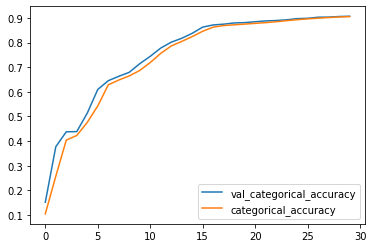

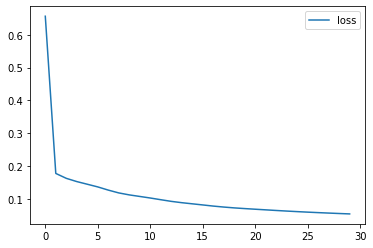

In [5]:
# obtaining an experiment
# scale
exp = experiment_for_N(10, parameters)

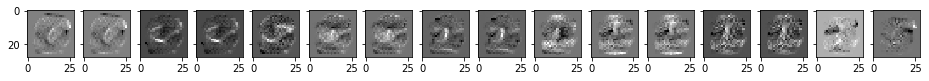

{'val_acc': 0.9072000026702881, 'train_acc': 0.9056166658798853, 'val_loss': 0.053906594216823575, 'train_loss': 0.05493064615875483}
Layer 0


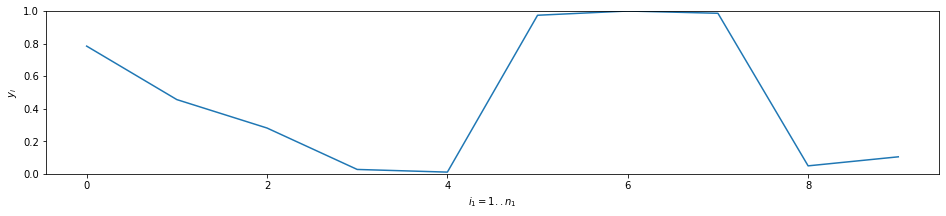

IntDer, Conv {'derivative': 51.39113, 'smoothness': 0.0}
Layer 1


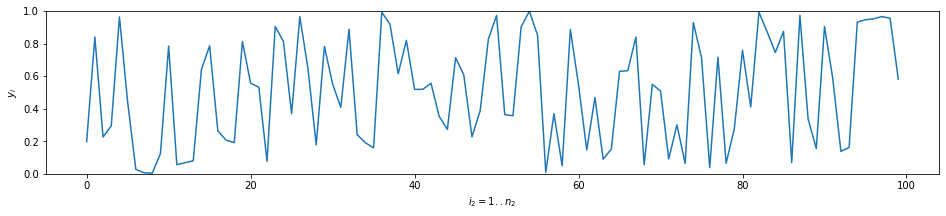

IntDer, Conv {'derivative': 143.82243, 'smoothness': 0.8272133}
Layer 2


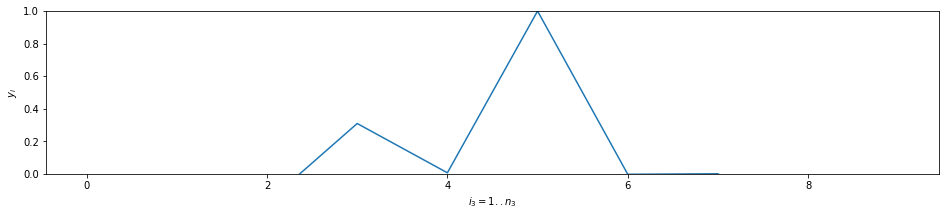

IntDer, Conv {'derivative': 83.952774, 'smoothness': 0.0}
True ans #0 5


{'val_acc': 0.9072000026702881,
 'train_acc': 0.9056166658798853,
 'val_loss': 0.053906594216823575,
 'train_loss': 0.05493064615875483,
 'act_0': array([0.7842115 , 0.45623475, 0.28190255, 0.02792948, 0.01156635,
        0.9734471 , 0.99949753, 0.98555934, 0.04995207, 0.10537577],
       dtype=float32),
 'act_1': array([0.19856015, 0.8399778 , 0.22646087, 0.2956832 , 0.9631239 ,
        0.4407999 , 0.02837138, 0.00744118, 0.00508209, 0.12542403,
        0.7842838 , 0.05710279, 0.06935681, 0.08085264, 0.64038557,
        0.78632724, 0.26465702, 0.20775962, 0.19224915, 0.81227565,
        0.557174  , 0.5321249 , 0.07781268, 0.9044887 , 0.81271213,
        0.36997953, 0.96500176, 0.6439156 , 0.17855513, 0.78234375,
        0.55242306, 0.40892863, 0.8872935 , 0.24097595, 0.19161619,
        0.16005145, 0.9920238 , 0.9176621 , 0.6146683 , 0.8191031 ,
        0.51872224, 0.51913613, 0.55636925, 0.35305077, 0.27331522,
        0.7127413 , 0.60833055, 0.22818874, 0.38801938, 0.8272913 ,
     

In [6]:
get_metrics(exp, to_run)

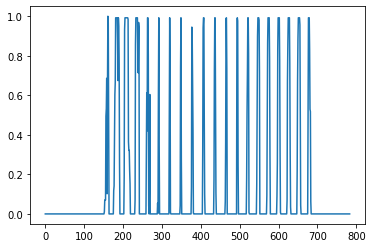

In [5]:
# does x have continuous limit?
# no, not really - it has ~28 discontinuities by construction
# need 2D?
plt.plot(exp.x_train[0])

  0%|          | 0/10 [00:00<?, ?it/s]findfont: Font family ['normal'] not found. Falling back to DejaVu Sans.


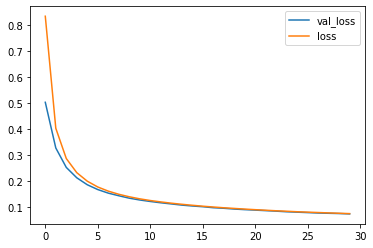

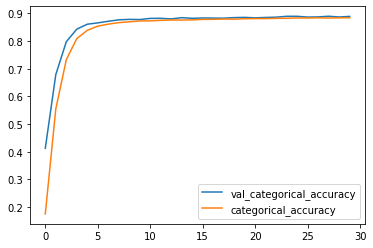

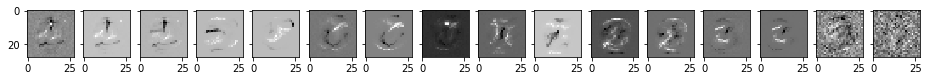

{'val_acc': 0.8894000053405762, 'train_acc': 0.8845333307981491, 'val_loss': 0.07243616208434105, 'train_loss': 0.07359804374476274}
Layer 0


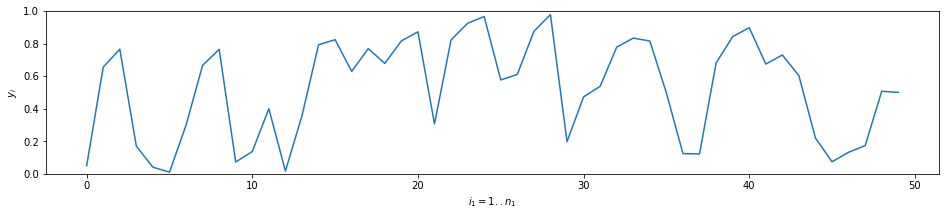

IntDer, Conv {'derivative': 47.29538, 'smoothness': 0.901911}
Layer 1


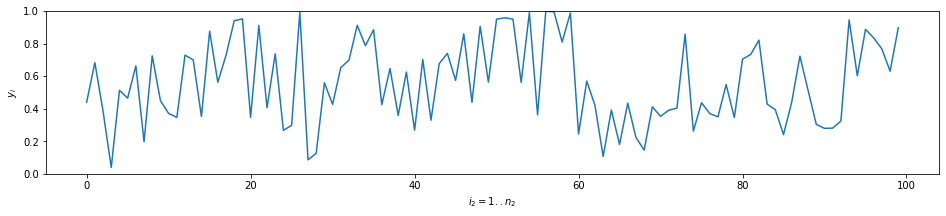

IntDer, Conv {'derivative': 137.09956, 'smoothness': 0.7379279}
Layer 2


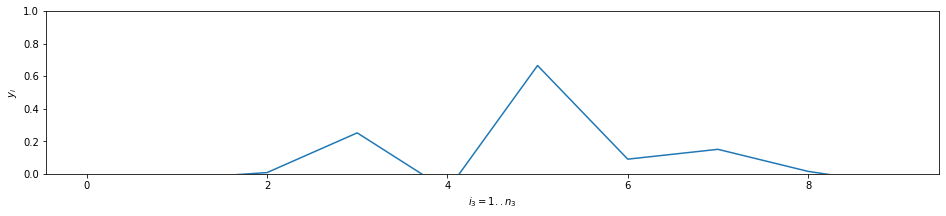

IntDer, Conv {'derivative': 84.87819, 'smoothness': 0.0}
True ans #0 5


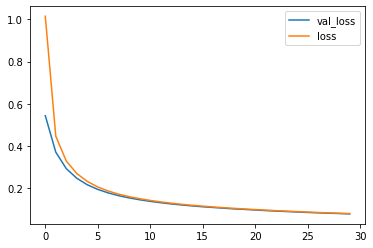

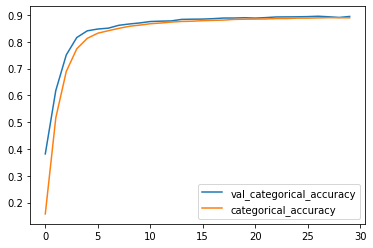

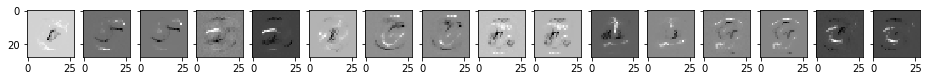

{'val_acc': 0.8943999946117401, 'train_acc': 0.8893333305915196, 'val_loss': 0.07712962105870247, 'train_loss': 0.07879847461978594}
Layer 0


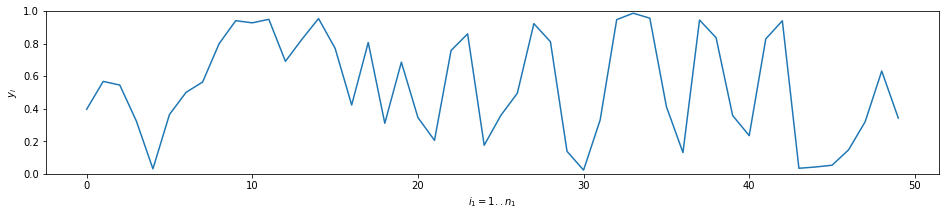

IntDer, Conv {'derivative': 45.467834, 'smoothness': 0.91917694}
Layer 1


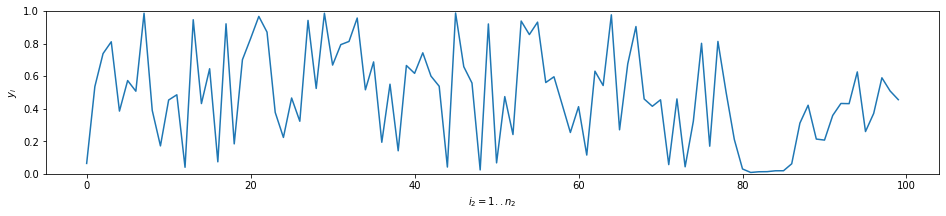

IntDer, Conv {'derivative': 164.4556, 'smoothness': 0.9014051}
Layer 2


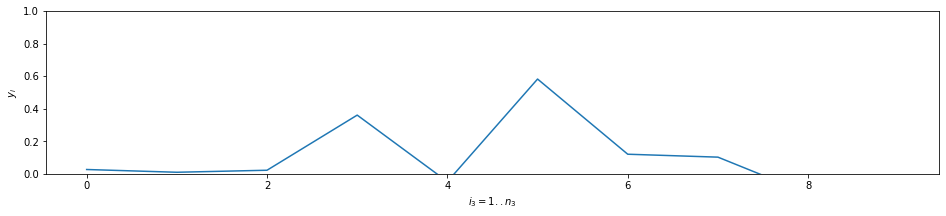

IntDer, Conv {'derivative': 83.1408, 'smoothness': 0.0}
True ans #0 5


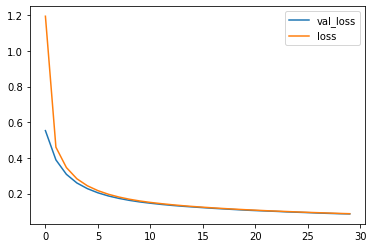

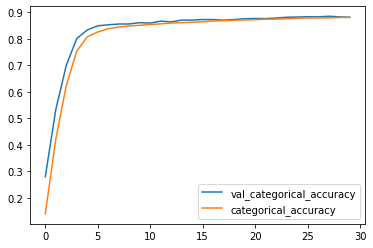

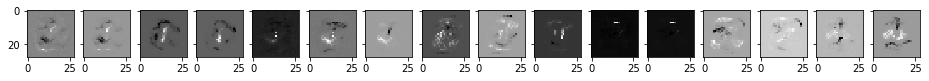

{'val_acc': 0.8821000039577485, 'train_acc': 0.8813666621843974, 'val_loss': 0.0857105404138565, 'train_loss': 0.08690497900048892}
Layer 0


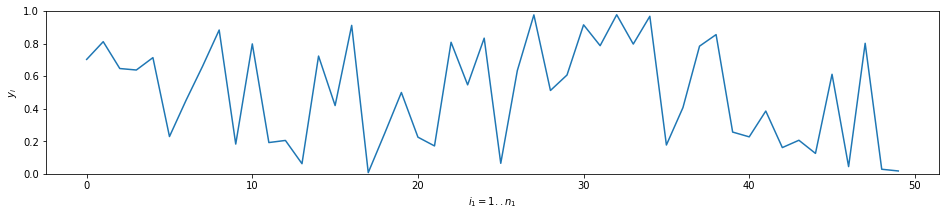

IntDer, Conv {'derivative': 42.755623, 'smoothness': 0.88603014}
Layer 1


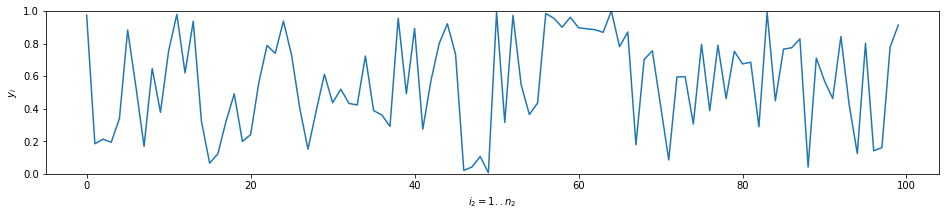

IntDer, Conv {'derivative': 189.46654, 'smoothness': 1.0358591}
Layer 2


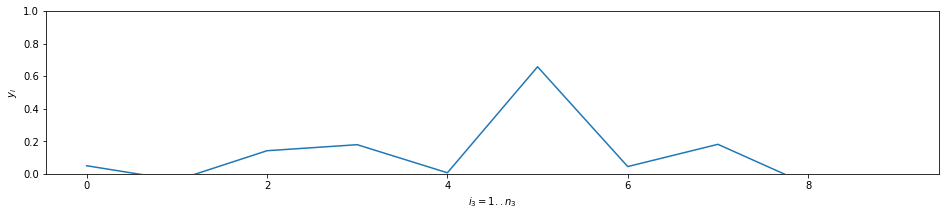

IntDer, Conv {'derivative': 85.38336, 'smoothness': 0.0}
True ans #0 5


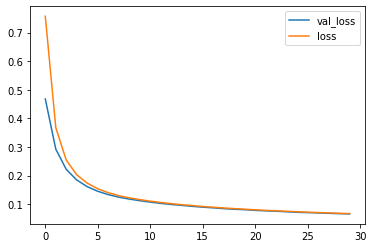

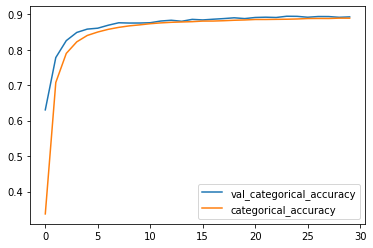

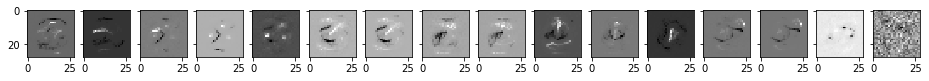

{'val_acc': 0.8927000045776368, 'train_acc': 0.8890333374341329, 'val_loss': 0.06589367873966694, 'train_loss': 0.06712538239856561}
Layer 0


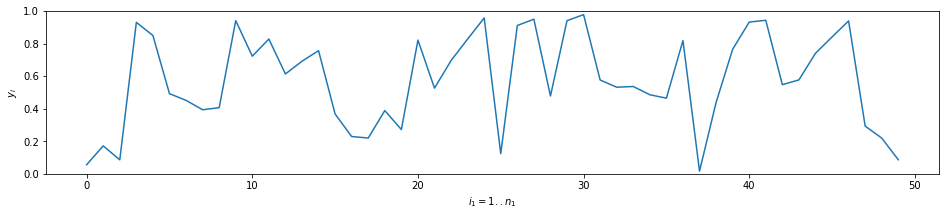

IntDer, Conv {'derivative': 43.58732, 'smoothness': 0.903685}
Layer 1


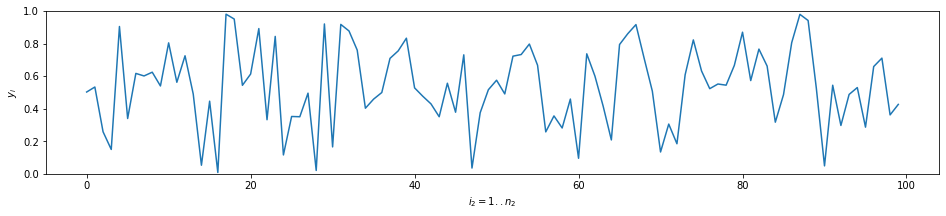

IntDer, Conv {'derivative': 105.169205, 'smoothness': 0.54815364}
Layer 2


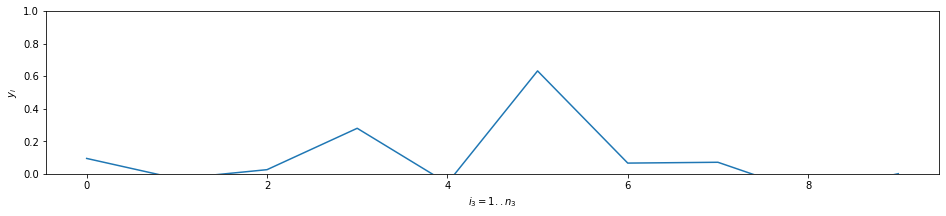

IntDer, Conv {'derivative': 85.36114, 'smoothness': 0.0}
True ans #0 5


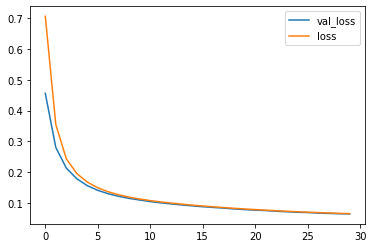

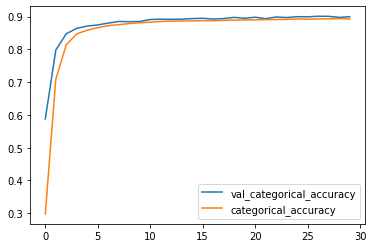

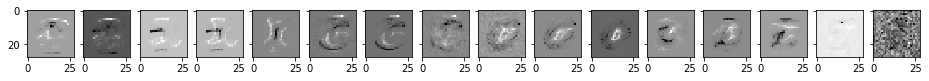

{'val_acc': 0.8994000136852265, 'train_acc': 0.8927166690429051, 'val_loss': 0.06449520066380501, 'train_loss': 0.06539222759505113}
Layer 0


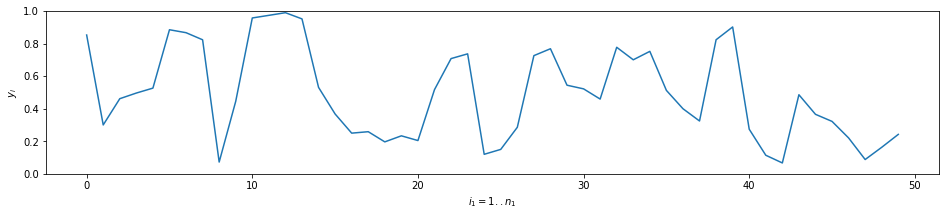

IntDer, Conv {'derivative': 44.73631, 'smoothness': 0.8681414}
Layer 1


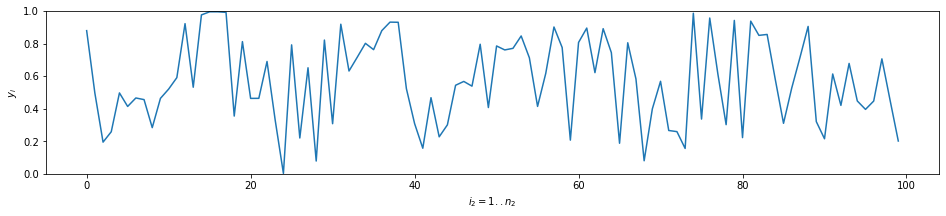

IntDer, Conv {'derivative': 105.496155, 'smoothness': 0.55705}
Layer 2


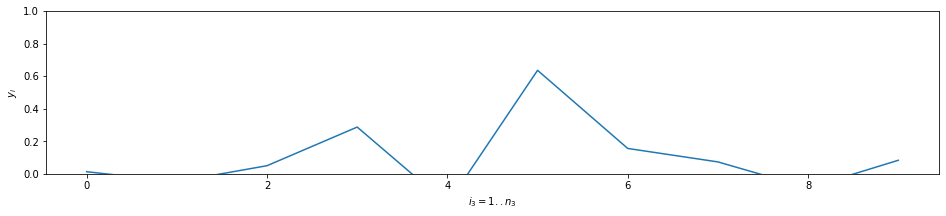

IntDer, Conv {'derivative': 86.47405, 'smoothness': 0.0}
True ans #0 5


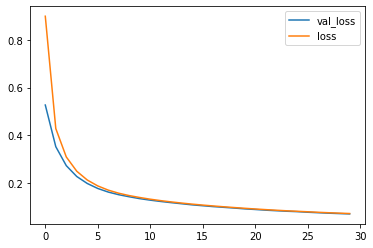

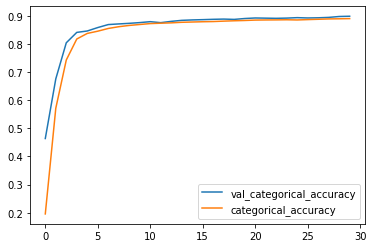

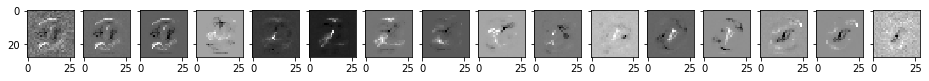

{'val_acc': 0.8983999967575074, 'train_acc': 0.8899999966224035, 'val_loss': 0.0690271120518446, 'train_loss': 0.07064656876027584}
Layer 0


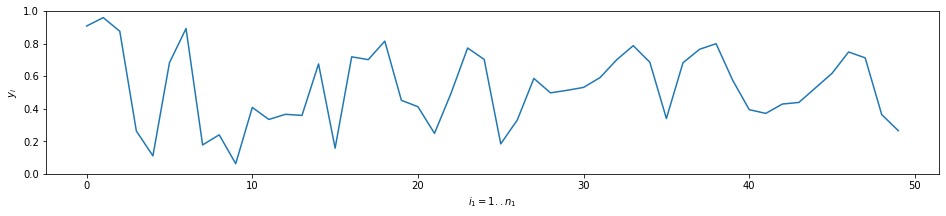

IntDer, Conv {'derivative': 41.313255, 'smoothness': 0.85280216}
Layer 1


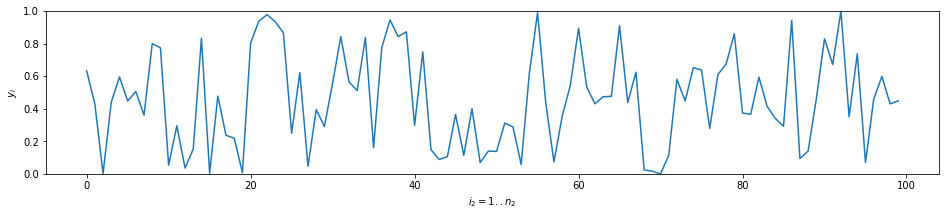

IntDer, Conv {'derivative': 140.91028, 'smoothness': 0.7460057}
Layer 2


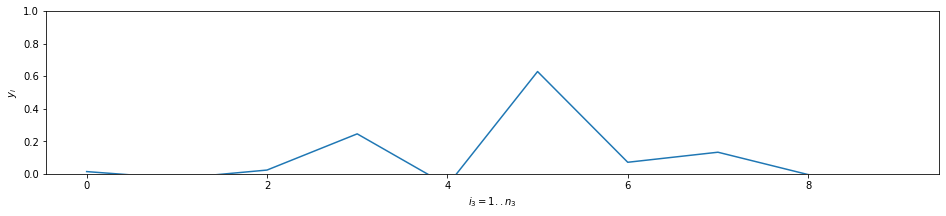

IntDer, Conv {'derivative': 82.35504, 'smoothness': 0.0}
True ans #0 5


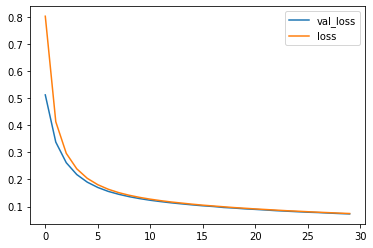

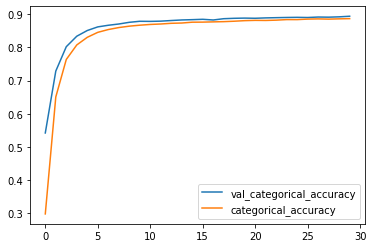

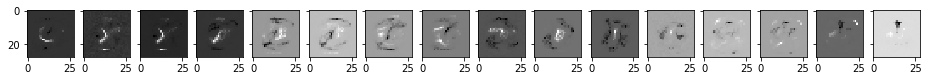

{'val_acc': 0.8939999997615814, 'train_acc': 0.8867833316326141, 'val_loss': 0.0731426604092121, 'train_loss': 0.07458909600973129}
Layer 0


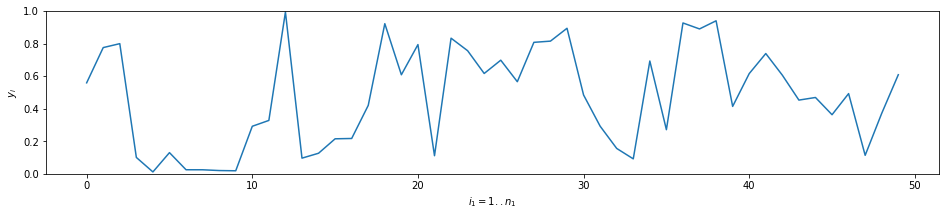

IntDer, Conv {'derivative': 42.412174, 'smoothness': 0.94960254}
Layer 1


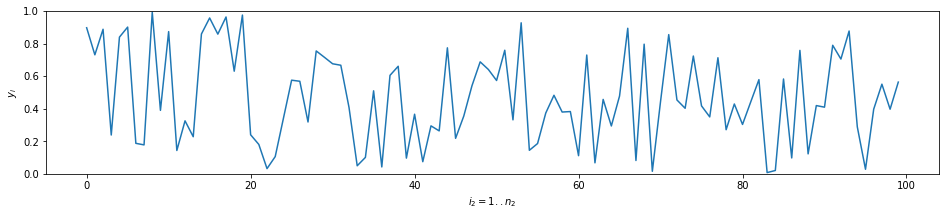

IntDer, Conv {'derivative': 137.5988, 'smoothness': 0.72684175}
Layer 2


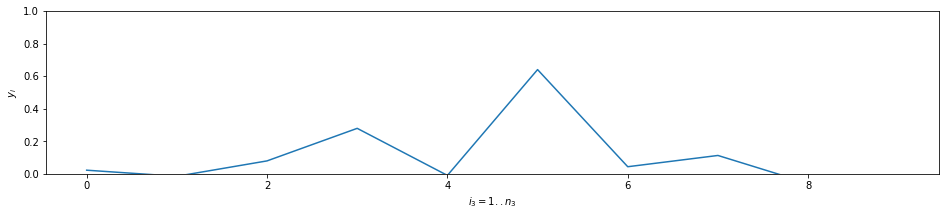

IntDer, Conv {'derivative': 83.70598, 'smoothness': 0.0}
True ans #0 5


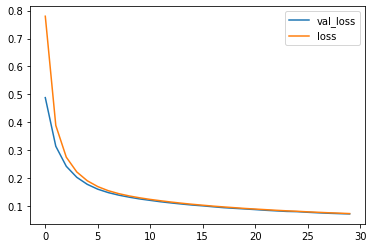

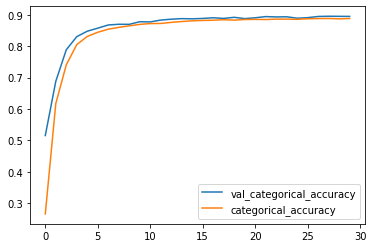

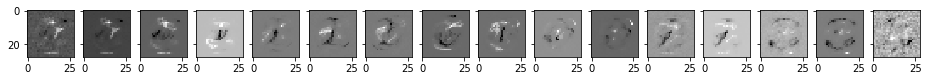

{'val_acc': 0.8950999975204468, 'train_acc': 0.8883666664361953, 'val_loss': 0.07255872562527657, 'train_loss': 0.07373585055271785}
Layer 0


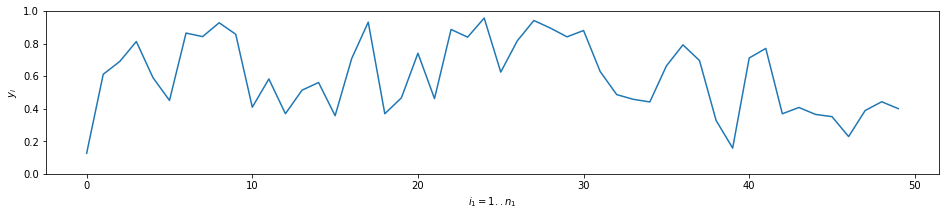

IntDer, Conv {'derivative': 43.308483, 'smoothness': 0.928408}
Layer 1


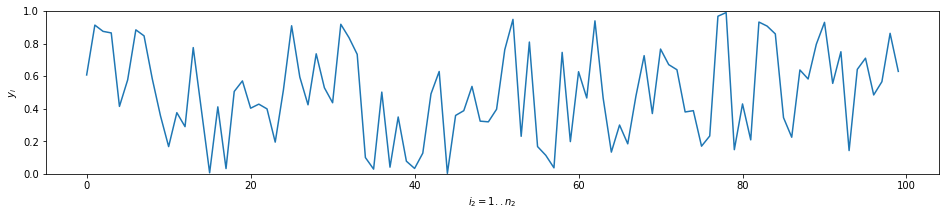

IntDer, Conv {'derivative': 142.1308, 'smoothness': 0.7718754}
Layer 2


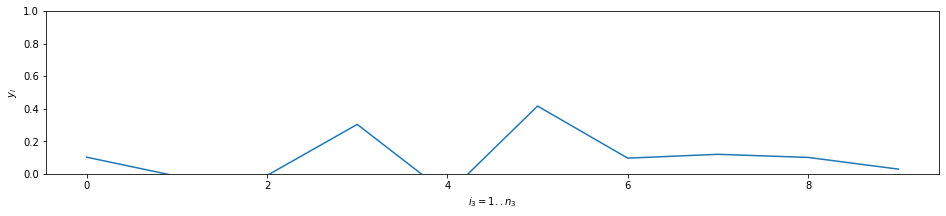

IntDer, Conv {'derivative': 85.17417, 'smoothness': 0.0}
True ans #0 5


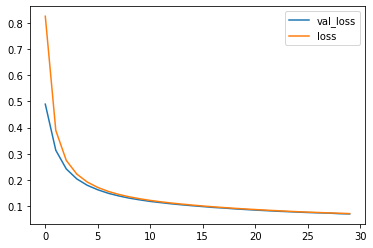

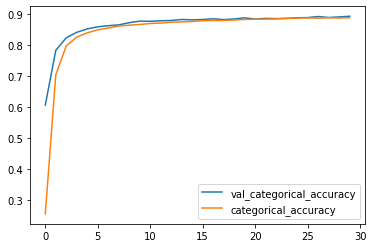

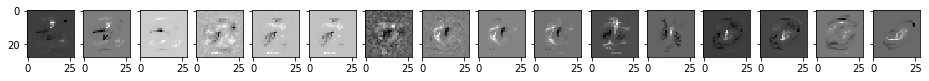

{'val_acc': 0.8936999917030335, 'train_acc': 0.8889499992132187, 'val_loss': 0.06937683336436748, 'train_loss': 0.07053190941611925}
Layer 0


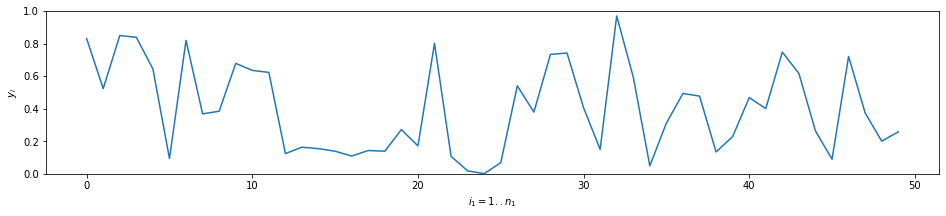

IntDer, Conv {'derivative': 44.35488, 'smoothness': 0.919694}
Layer 1


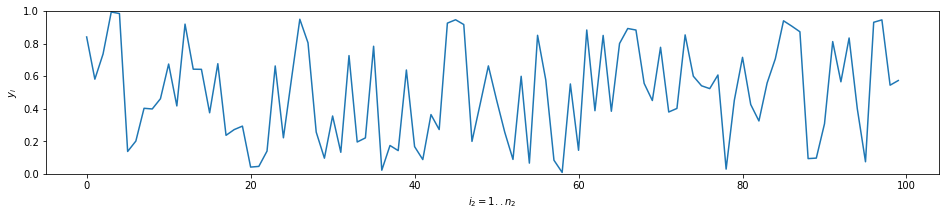

IntDer, Conv {'derivative': 117.87292, 'smoothness': 0.63323665}
Layer 2


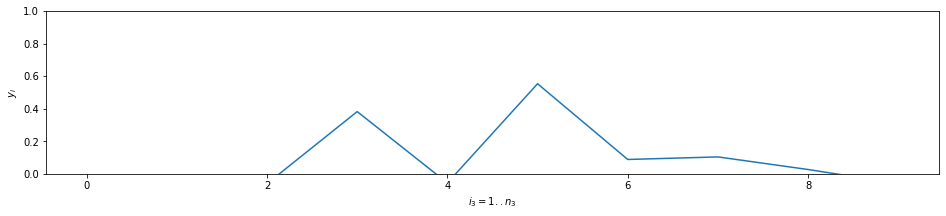

IntDer, Conv {'derivative': 88.94582, 'smoothness': 0.0}
True ans #0 5


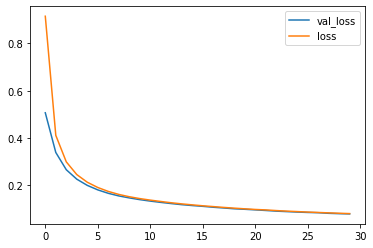

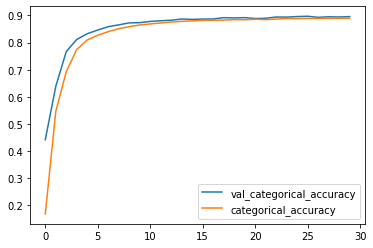

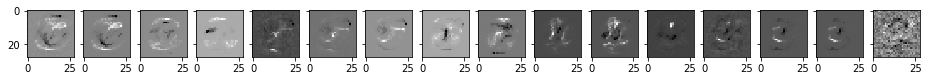

{'val_acc': 0.8958000004291534, 'train_acc': 0.8895500034093857, 'val_loss': 0.07975904047489166, 'train_loss': 0.08112424400945505}
Layer 0


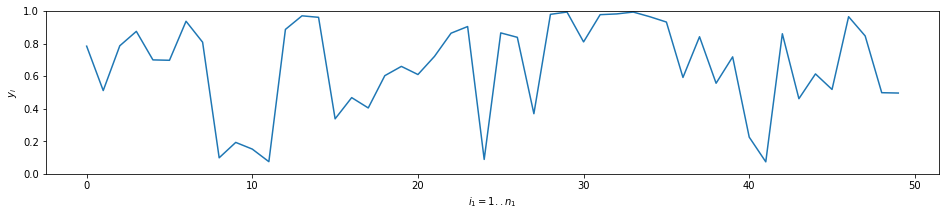

IntDer, Conv {'derivative': 45.168045, 'smoothness': 0.9325212}
Layer 1


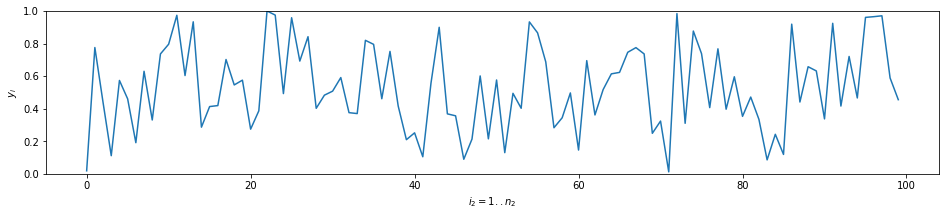

IntDer, Conv {'derivative': 167.0876, 'smoothness': 0.9233312}
Layer 2


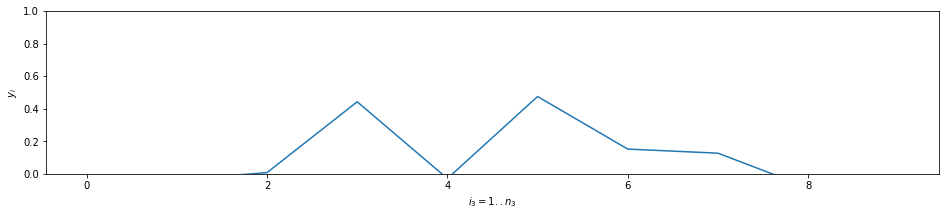

IntDer, Conv {'derivative': 87.59939, 'smoothness': 0.0}
True ans #0 5


 10%|█         | 1/10 [03:18<29:48, 198.71s/it]

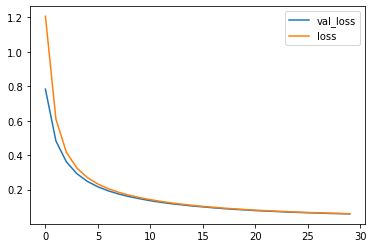

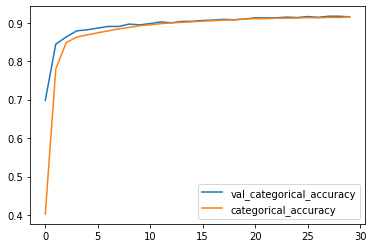

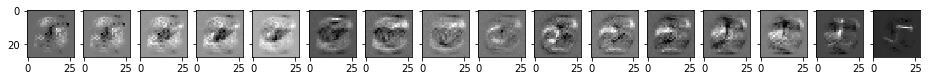

{'val_acc': 0.9151000022888184, 'train_acc': 0.9155166665712993, 'val_loss': 0.05902030952274799, 'train_loss': 0.060050950323541956}
Layer 0


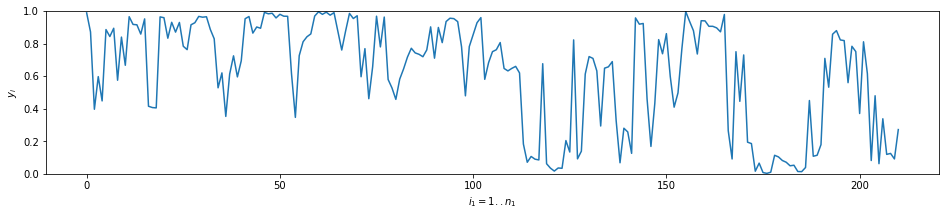

IntDer, Conv {'derivative': 67.56085, 'smoothness': 0.26398382}
Layer 1


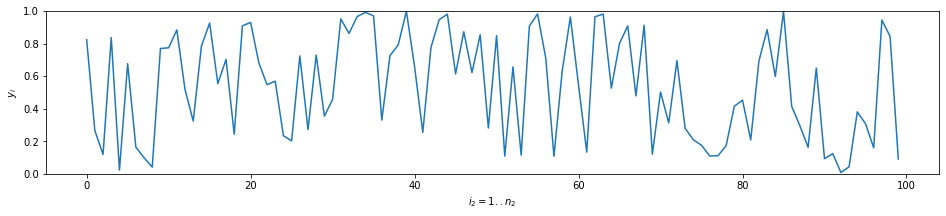

IntDer, Conv {'derivative': 103.46743, 'smoothness': 0.5187503}
Layer 2


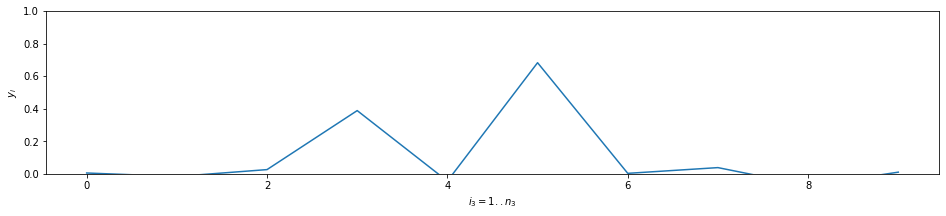

IntDer, Conv {'derivative': 78.51891, 'smoothness': 0.0}
True ans #0 5


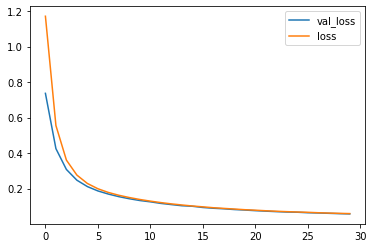

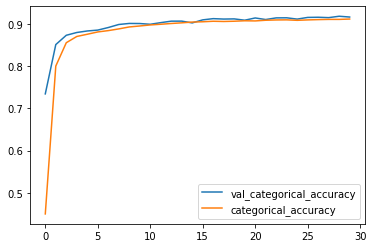

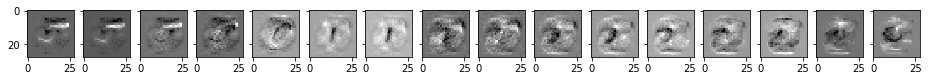

{'val_acc': 0.9171999931335449, 'train_acc': 0.9124666670958201, 'val_loss': 0.05735748186707497, 'train_loss': 0.059194618836045265}
Layer 0


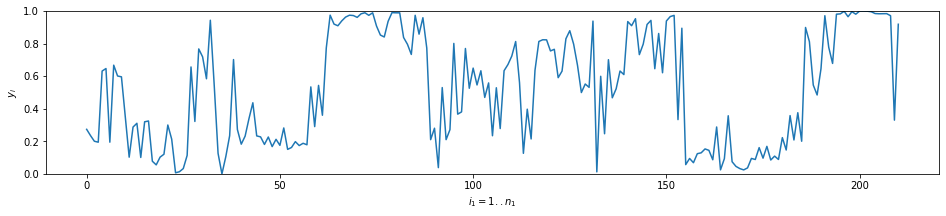

IntDer, Conv {'derivative': 70.30786, 'smoothness': 0.2651221}
Layer 1


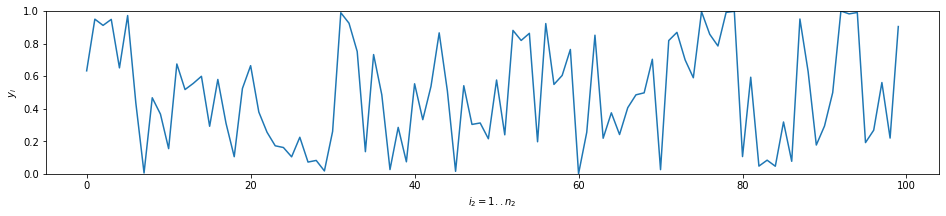

IntDer, Conv {'derivative': 91.115944, 'smoothness': 0.45507702}
Layer 2


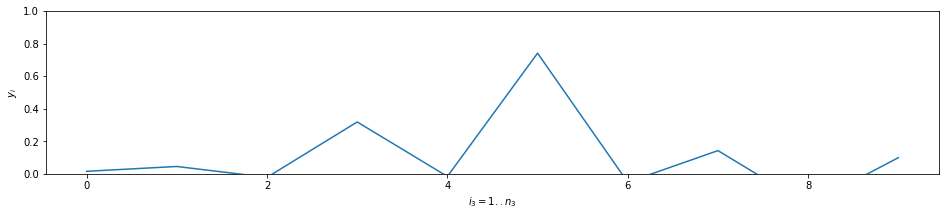

IntDer, Conv {'derivative': 81.01332, 'smoothness': 0.0}
True ans #0 5


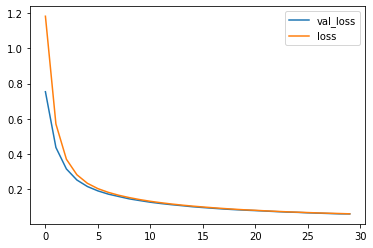

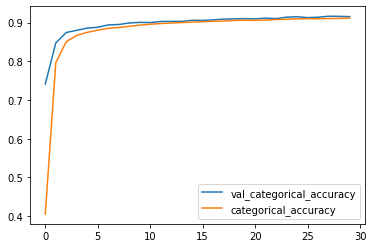

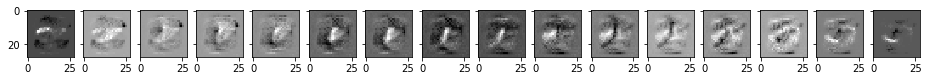

{'val_acc': 0.9152000069618225, 'train_acc': 0.9113499979178111, 'val_loss': 0.05916363224387169, 'train_loss': 0.05971054130544265}
Layer 0


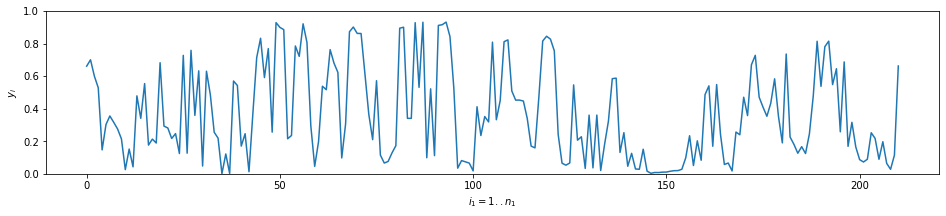

IntDer, Conv {'derivative': 66.815926, 'smoothness': 0.24944513}
Layer 1


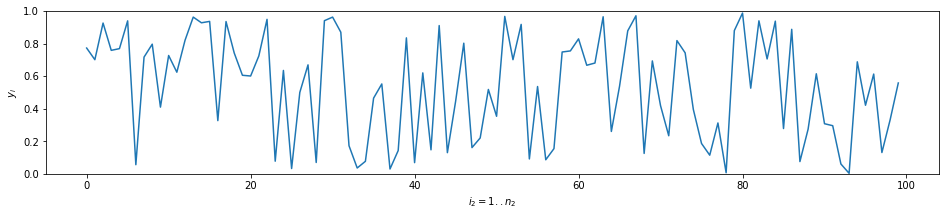

IntDer, Conv {'derivative': 93.19562, 'smoothness': 0.4601888}
Layer 2


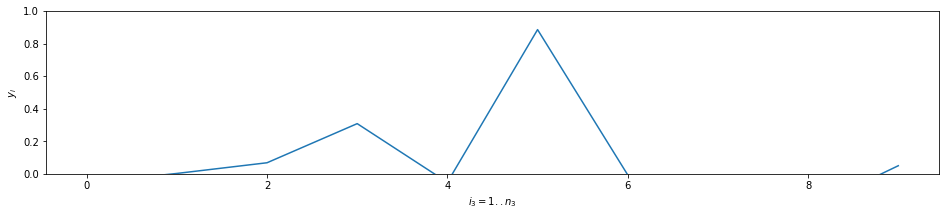

IntDer, Conv {'derivative': 78.79024, 'smoothness': 0.0}
True ans #0 5


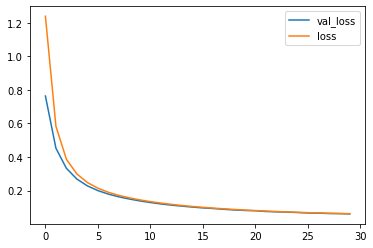

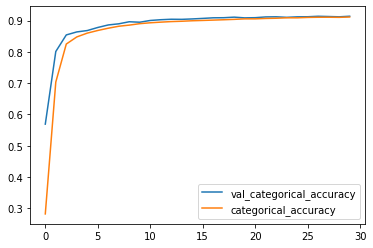

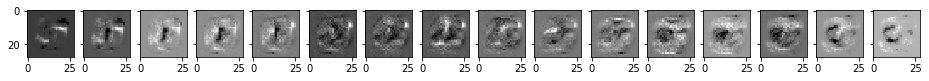

{'val_acc': 0.9138000011444092, 'train_acc': 0.9113166650136312, 'val_loss': 0.06085379794239998, 'train_loss': 0.062193222095568976}
Layer 0


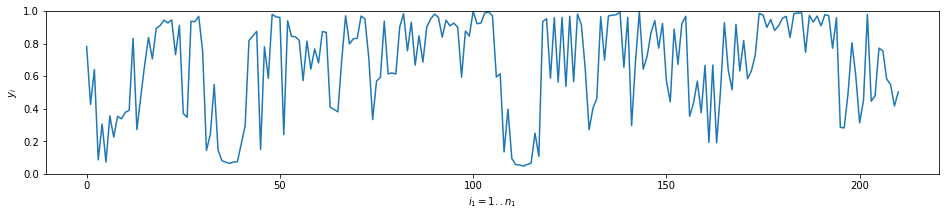

IntDer, Conv {'derivative': 73.10663, 'smoothness': 0.29667926}
Layer 1


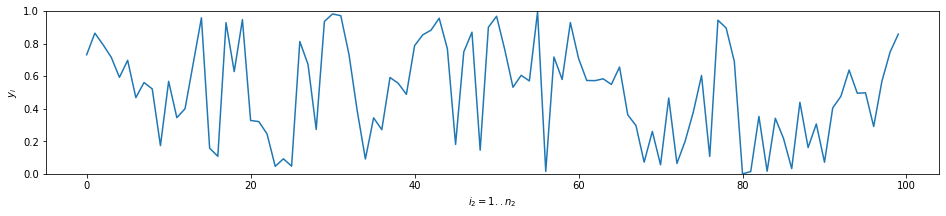

IntDer, Conv {'derivative': 105.631195, 'smoothness': 0.512524}
Layer 2


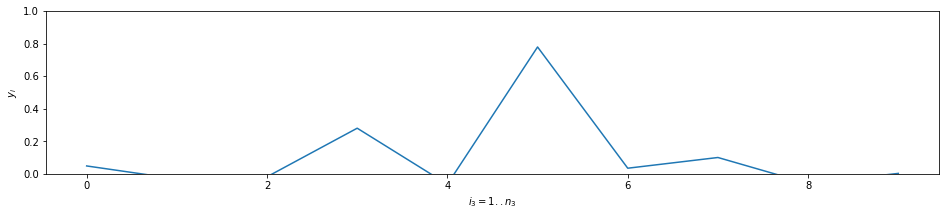

IntDer, Conv {'derivative': 71.136604, 'smoothness': 0.0}
True ans #0 5


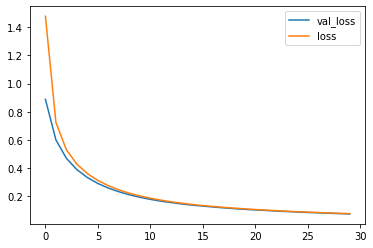

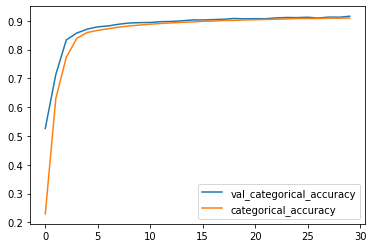

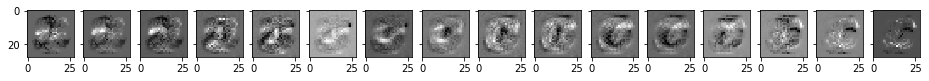

{'val_acc': 0.9160999953746796, 'train_acc': 0.9097166647513707, 'val_loss': 0.07445146813988686, 'train_loss': 0.0764922338227431}
Layer 0


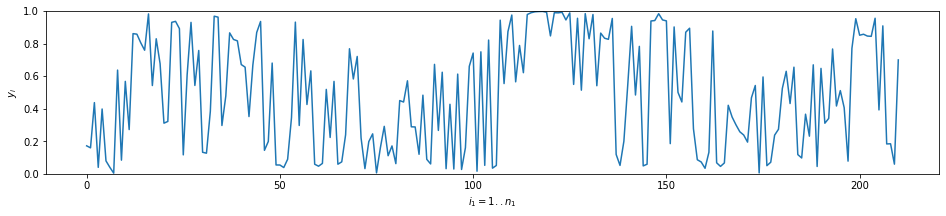

IntDer, Conv {'derivative': 68.773094, 'smoothness': 0.25757533}
Layer 1


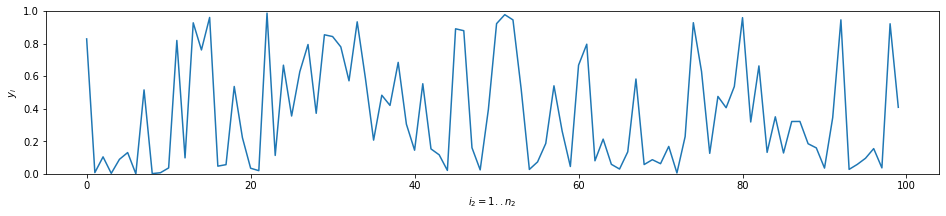

IntDer, Conv {'derivative': 183.18044, 'smoothness': 0.97023696}
Layer 2


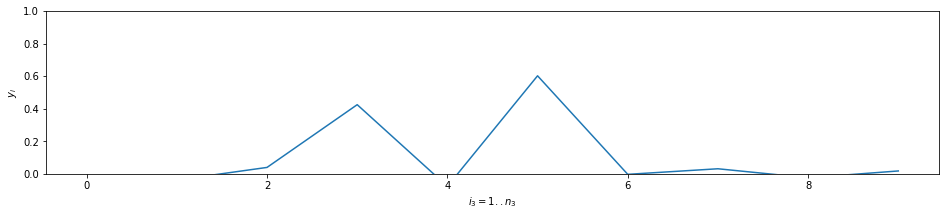

IntDer, Conv {'derivative': 78.1224, 'smoothness': 0.0}
True ans #0 5


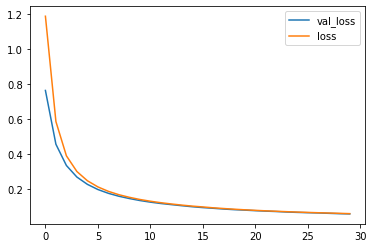

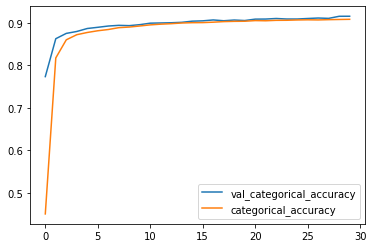

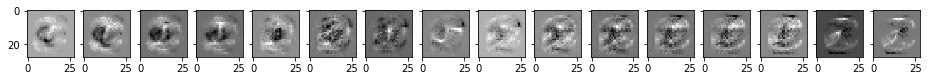

{'val_acc': 0.915500009059906, 'train_acc': 0.9082833349704742, 'val_loss': 0.058658471703529357, 'train_loss': 0.06023284619053205}
Layer 0


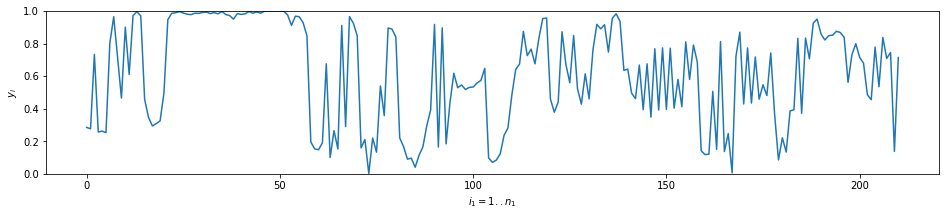

IntDer, Conv {'derivative': 67.7497, 'smoothness': 0.26235208}
Layer 1


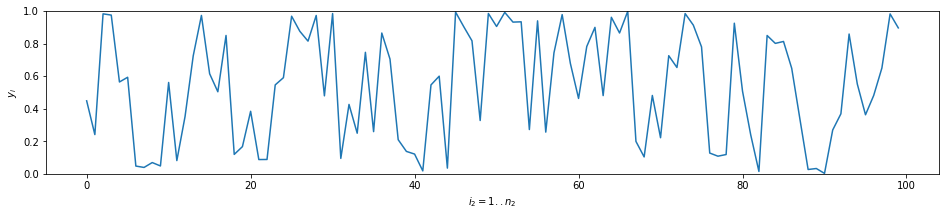

IntDer, Conv {'derivative': 98.58282, 'smoothness': 0.49100867}
Layer 2


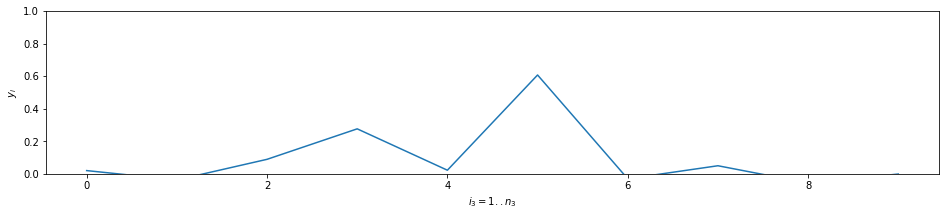

IntDer, Conv {'derivative': 78.421745, 'smoothness': 0.0}
True ans #0 5


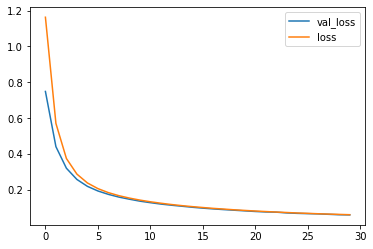

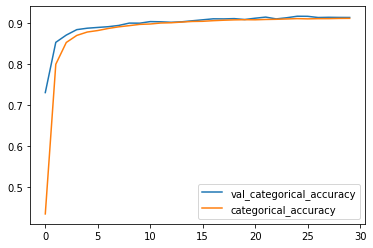

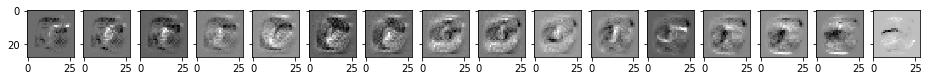

{'val_acc': 0.9145000040531158, 'train_acc': 0.9123333344856898, 'val_loss': 0.059107893332839015, 'train_loss': 0.06030072874079148}
Layer 0


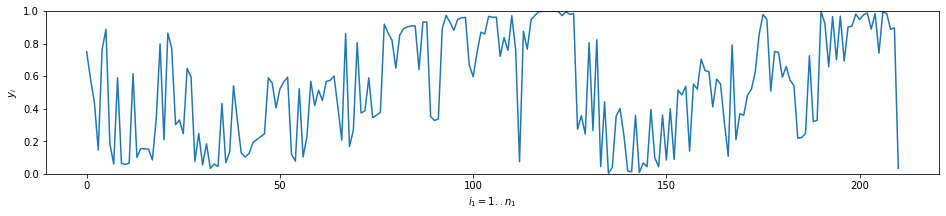

IntDer, Conv {'derivative': 69.59149, 'smoothness': 0.26318553}
Layer 1


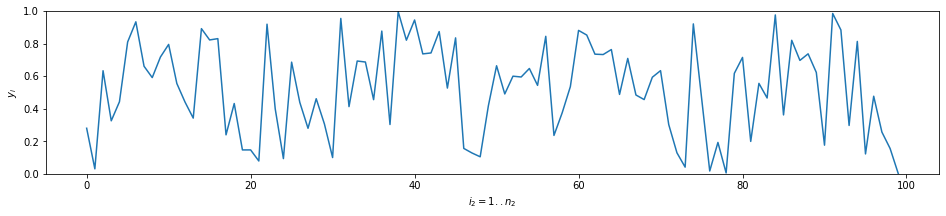

IntDer, Conv {'derivative': 100.85567, 'smoothness': 0.5000752}
Layer 2


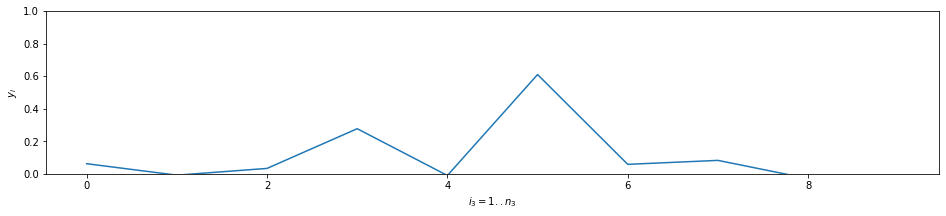

IntDer, Conv {'derivative': 75.806244, 'smoothness': 0.0}
True ans #0 5


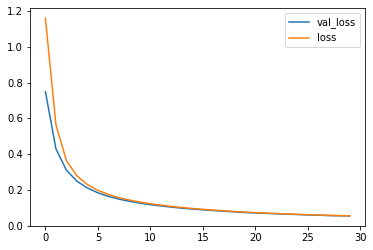

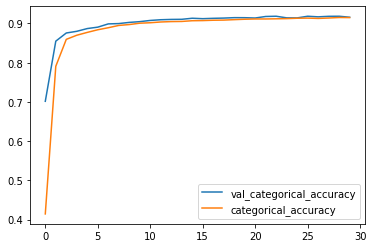

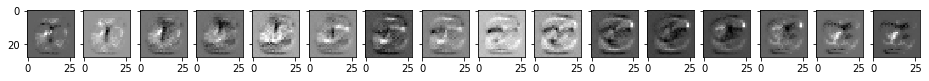

{'val_acc': 0.9158999919891357, 'train_acc': 0.9149666637182235, 'val_loss': 0.05396887734532356, 'train_loss': 0.054510804389913875}
Layer 0


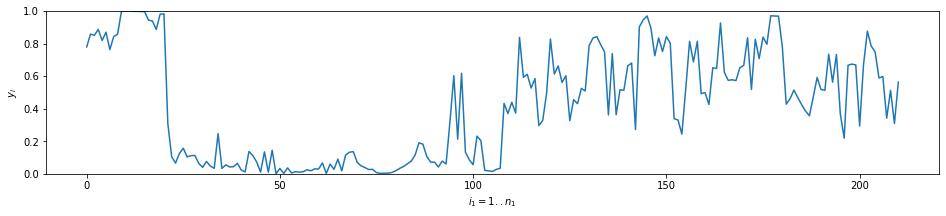

IntDer, Conv {'derivative': 64.28873, 'smoothness': 0.23440716}
Layer 1


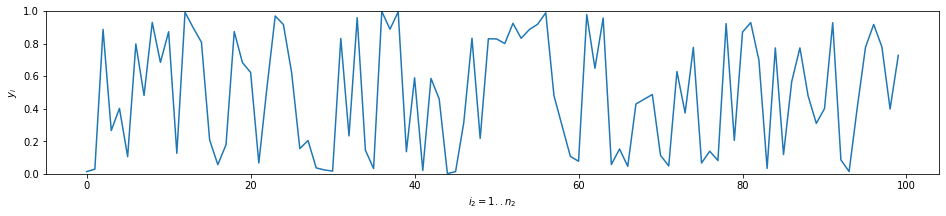

IntDer, Conv {'derivative': 83.44643, 'smoothness': 0.40811217}
Layer 2


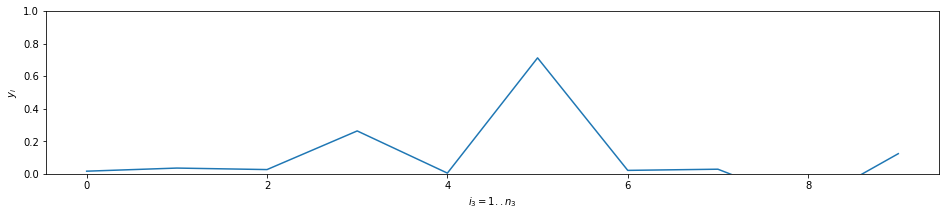

IntDer, Conv {'derivative': 79.408264, 'smoothness': 0.0}
True ans #0 5


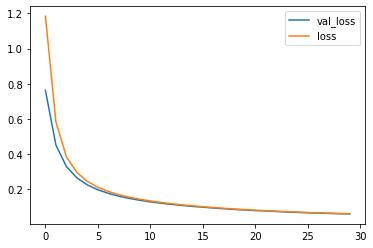

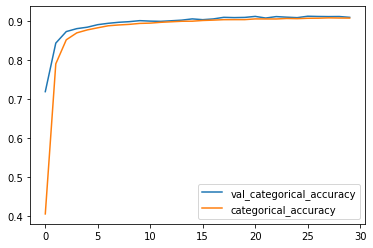

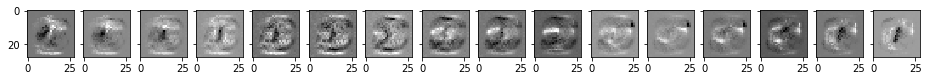

{'val_acc': 0.9099000036716461, 'train_acc': 0.9079666664203008, 'val_loss': 0.058122359216213226, 'train_loss': 0.059193540426592035}
Layer 0


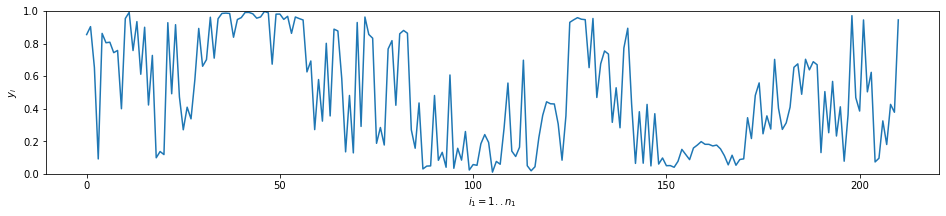

IntDer, Conv {'derivative': 67.10965, 'smoothness': 0.23834786}
Layer 1


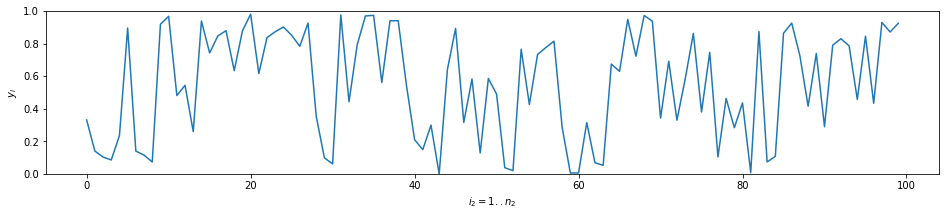

IntDer, Conv {'derivative': 95.44143, 'smoothness': 0.47221386}
Layer 2


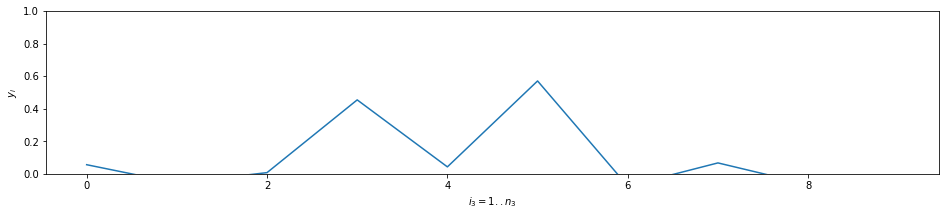

IntDer, Conv {'derivative': 77.617874, 'smoothness': 0.0}
True ans #0 5


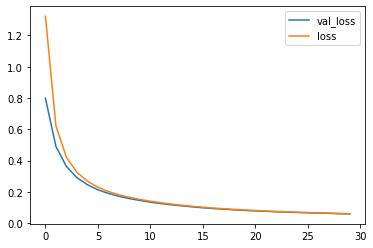

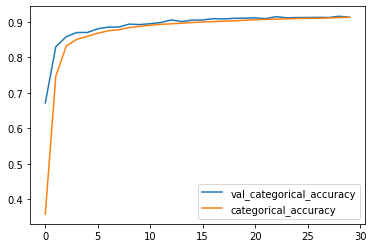

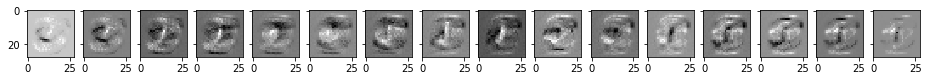

{'val_acc': 0.913400000333786, 'train_acc': 0.9134000013271968, 'val_loss': 0.059634552150964734, 'train_loss': 0.060643596264223255}
Layer 0


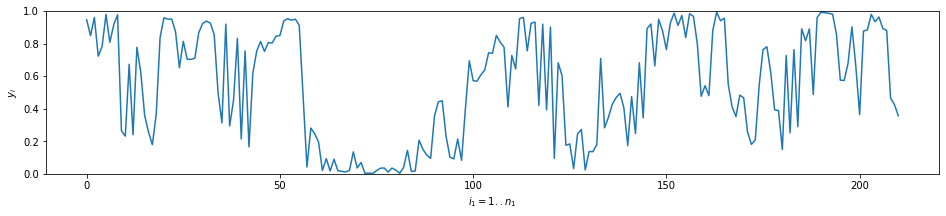

IntDer, Conv {'derivative': 66.88914, 'smoothness': 0.26381594}
Layer 1


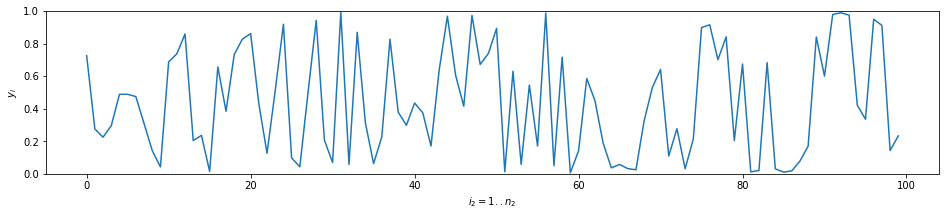

IntDer, Conv {'derivative': 102.13729, 'smoothness': 0.50817704}
Layer 2


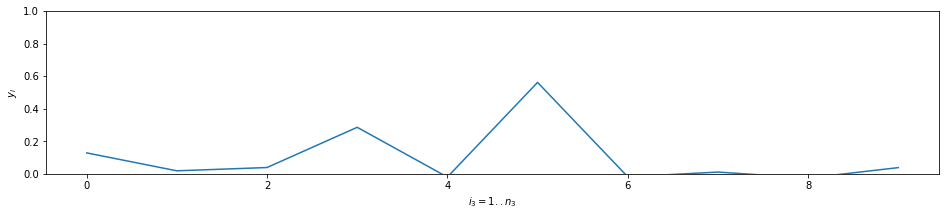

IntDer, Conv {'derivative': 77.31148, 'smoothness': 0.0}
True ans #0 5


 20%|██        | 2/10 [06:58<27:20, 205.08s/it]

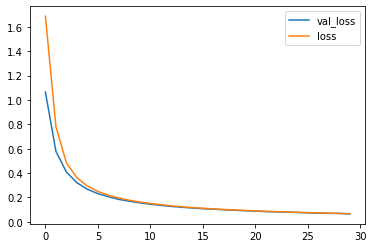

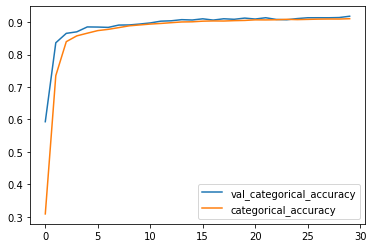

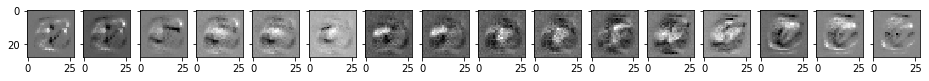

{'val_acc': 0.9178999900817871, 'train_acc': 0.9103166689475377, 'val_loss': 0.06442340835928917, 'train_loss': 0.06669359418253104}
Layer 0


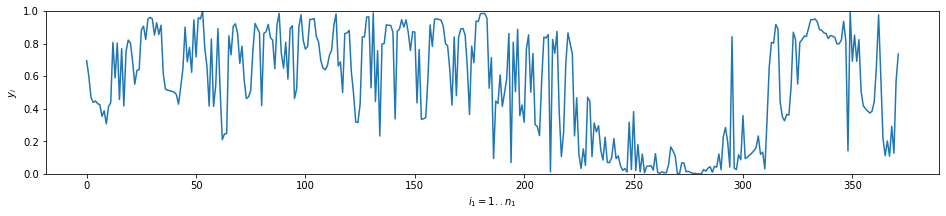

IntDer, Conv {'derivative': 80.467575, 'smoothness': 0.2516142}
Layer 1


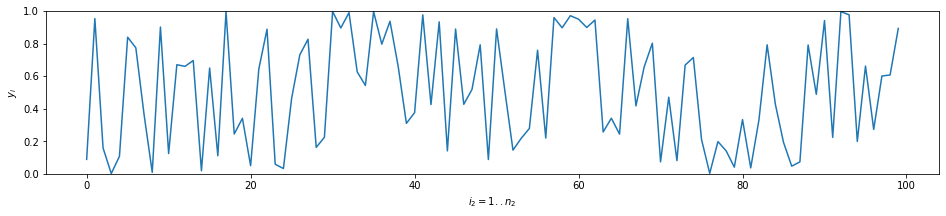

IntDer, Conv {'derivative': 97.016205, 'smoothness': 0.4705812}
Layer 2


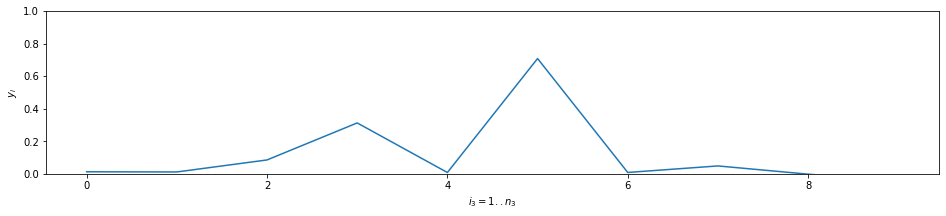

IntDer, Conv {'derivative': 77.64429, 'smoothness': 0.0}
True ans #0 5


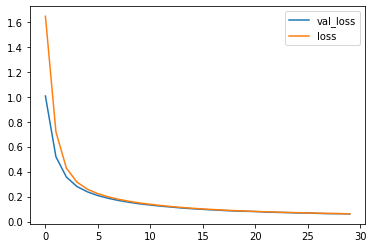

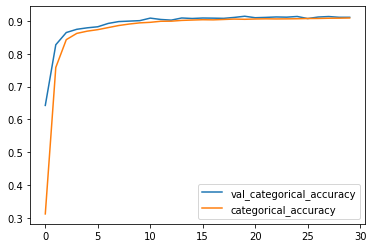

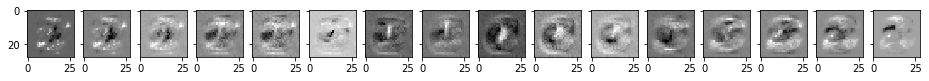

{'val_acc': 0.9107000052928924, 'train_acc': 0.9086166689793269, 'val_loss': 0.060966594517230986, 'train_loss': 0.06177247129380703}
Layer 0


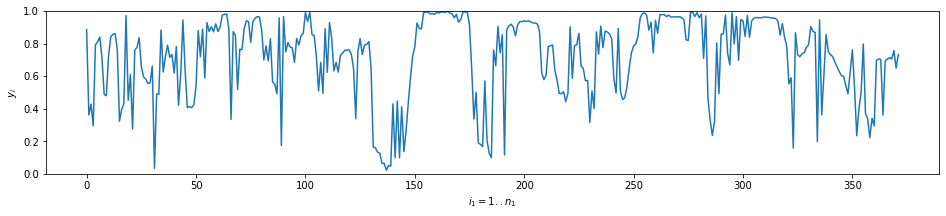

IntDer, Conv {'derivative': 81.30798, 'smoothness': 0.24112806}
Layer 1


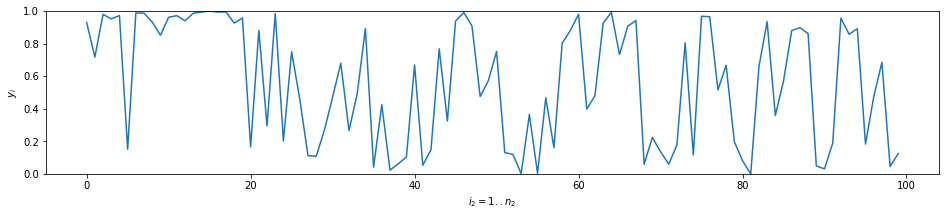

IntDer, Conv {'derivative': 88.98526, 'smoothness': 0.43504968}
Layer 2


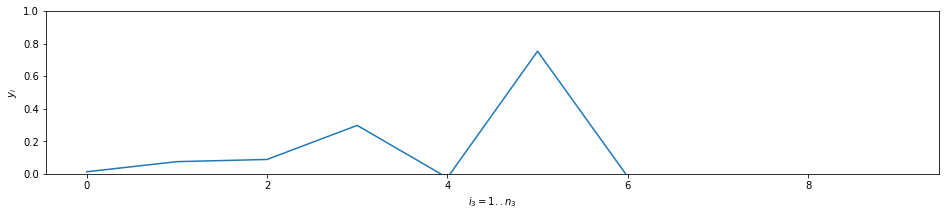

IntDer, Conv {'derivative': 75.16684, 'smoothness': 0.0}
True ans #0 5


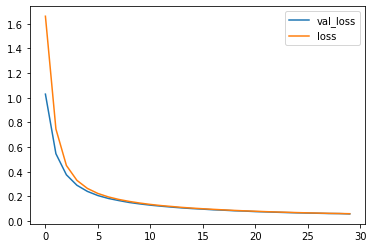

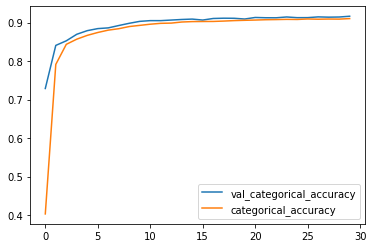

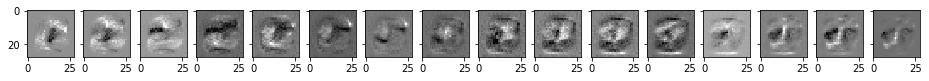

{'val_acc': 0.9162999987602234, 'train_acc': 0.9101999998092651, 'val_loss': 0.05783065333962441, 'train_loss': 0.05950349358220895}
Layer 0


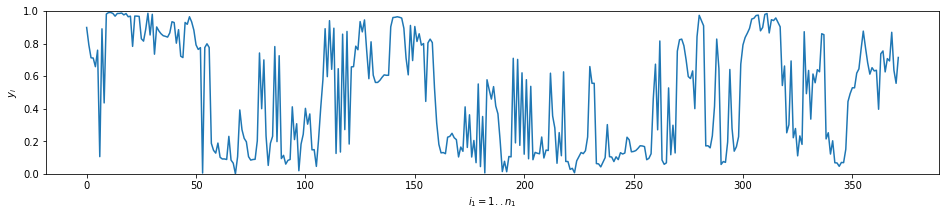

IntDer, Conv {'derivative': 79.60949, 'smoothness': 0.21536544}
Layer 1


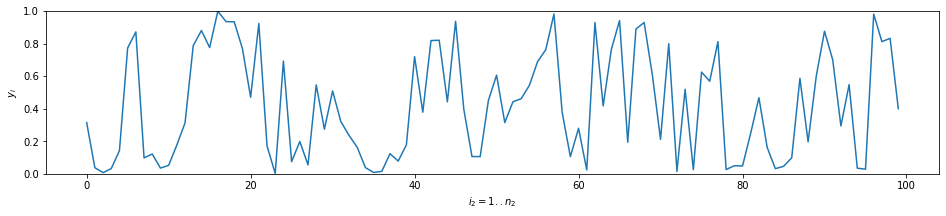

IntDer, Conv {'derivative': 84.30235, 'smoothness': 0.4040552}
Layer 2


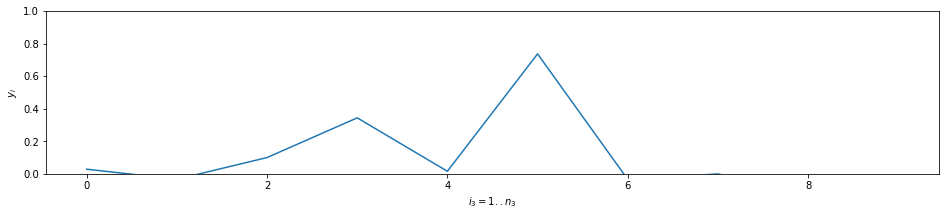

IntDer, Conv {'derivative': 74.359924, 'smoothness': 0.0}
True ans #0 5


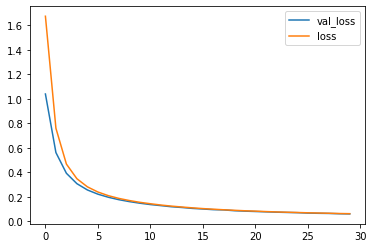

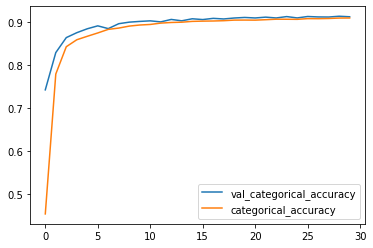

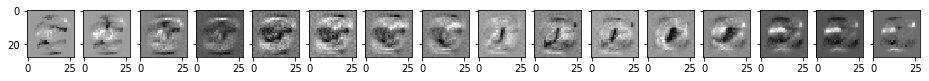

{'val_acc': 0.9123000025749206, 'train_acc': 0.9094499965508779, 'val_loss': 0.05904361046850681, 'train_loss': 0.06098514888435602}
Layer 0


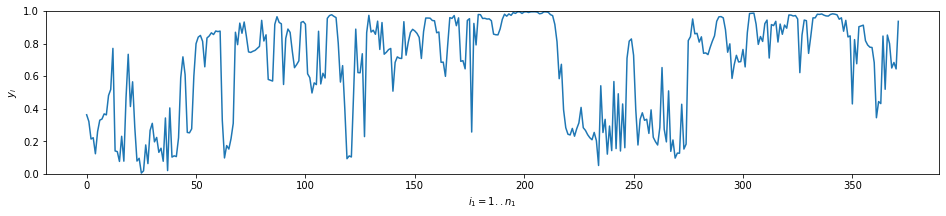

IntDer, Conv {'derivative': 80.81541, 'smoothness': 0.22260717}
Layer 1


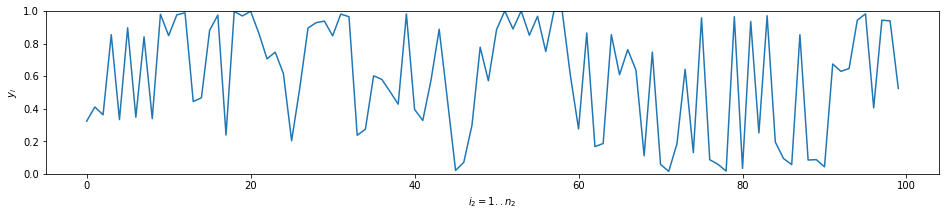

IntDer, Conv {'derivative': 85.581375, 'smoothness': 0.41693497}
Layer 2


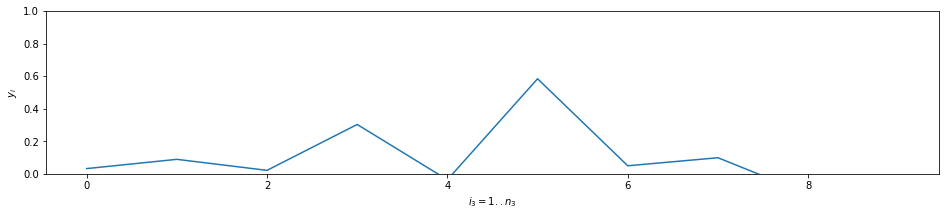

IntDer, Conv {'derivative': 76.8513, 'smoothness': 0.0}
True ans #0 5


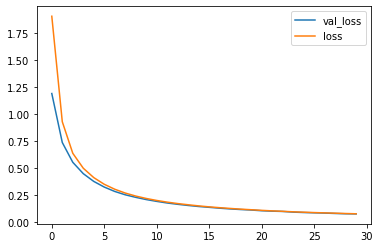

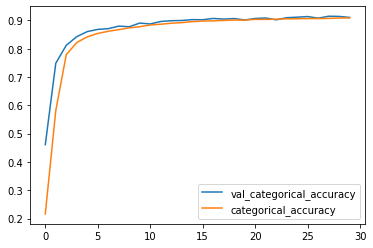

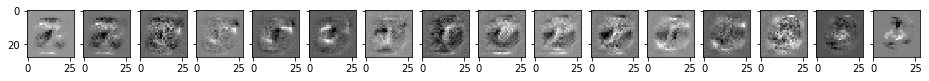

{'val_acc': 0.9106000006198883, 'train_acc': 0.9089333315690359, 'val_loss': 0.07309941127896309, 'train_loss': 0.07437427900731564}
Layer 0


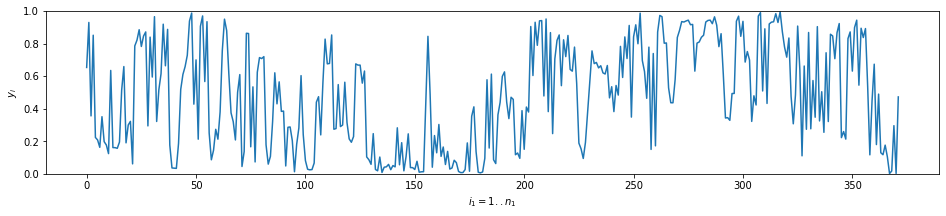

IntDer, Conv {'derivative': 86.89304, 'smoothness': 0.26209903}
Layer 1


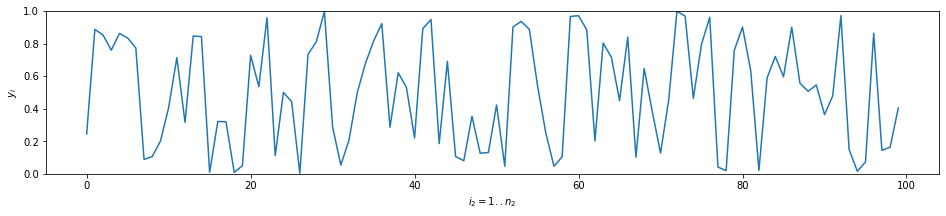

IntDer, Conv {'derivative': 139.76299, 'smoothness': 0.69421345}
Layer 2


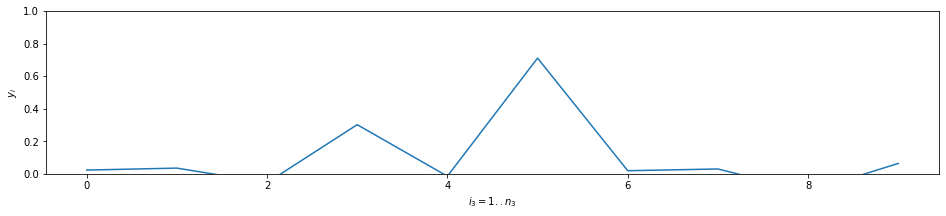

IntDer, Conv {'derivative': 74.85096, 'smoothness': 0.0}
True ans #0 5


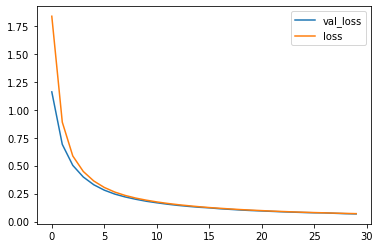

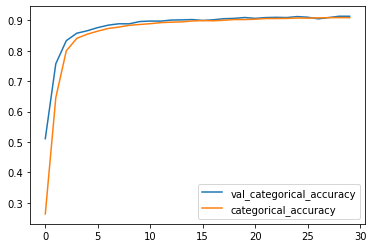

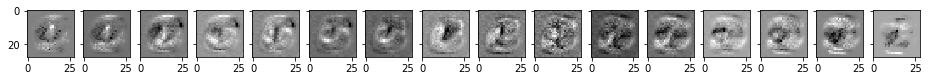

{'val_acc': 0.9132999956607819, 'train_acc': 0.9086166640122731, 'val_loss': 0.06858236603438854, 'train_loss': 0.07117801159620285}
Layer 0


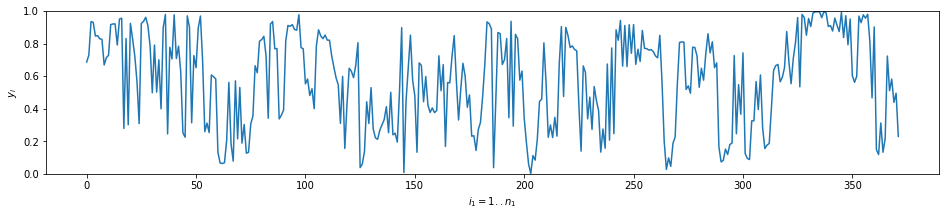

IntDer, Conv {'derivative': 82.82262, 'smoothness': 0.24894542}
Layer 1


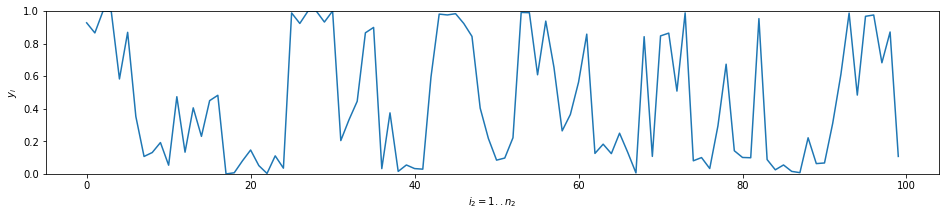

IntDer, Conv {'derivative': 121.752426, 'smoothness': 0.58922315}
Layer 2


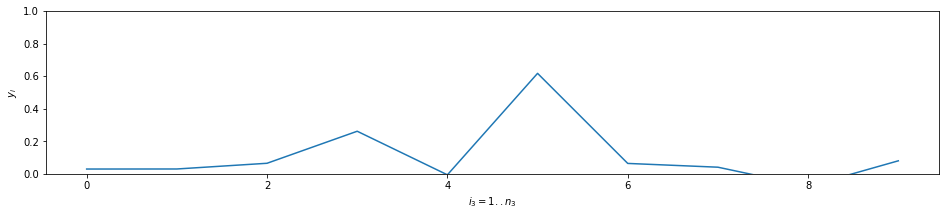

IntDer, Conv {'derivative': 74.833565, 'smoothness': 0.0}
True ans #0 5


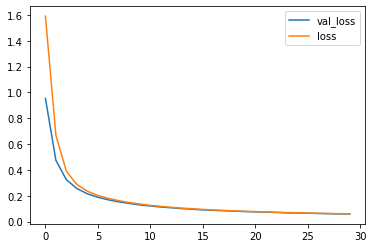

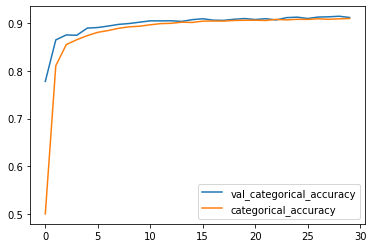

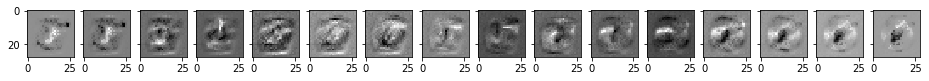

{'val_acc': 0.9114000022411346, 'train_acc': 0.9092833379904429, 'val_loss': 0.06001209020614624, 'train_loss': 0.060473160135249296}
Layer 0


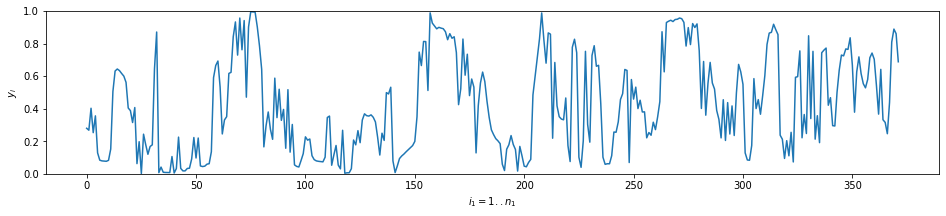

IntDer, Conv {'derivative': 85.941605, 'smoothness': 0.26505324}
Layer 1


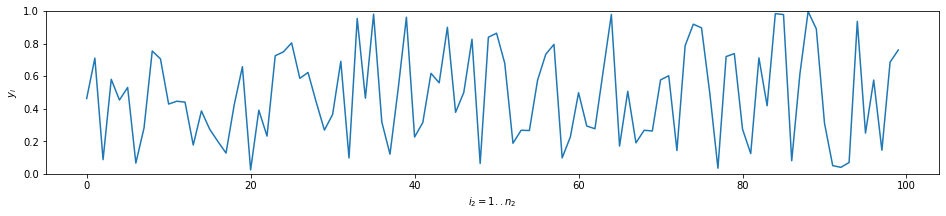

IntDer, Conv {'derivative': 83.42722, 'smoothness': 0.40839902}
Layer 2


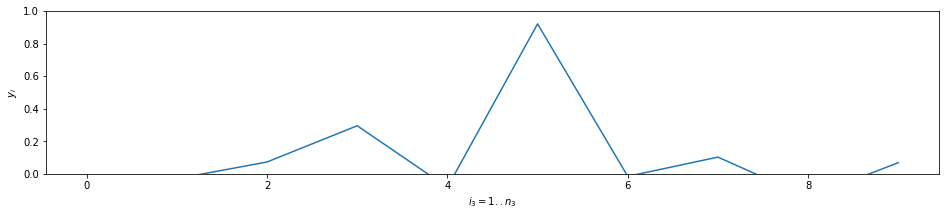

IntDer, Conv {'derivative': 71.72883, 'smoothness': 0.0}
True ans #0 5


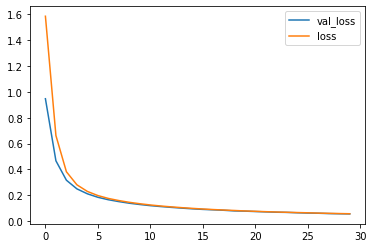

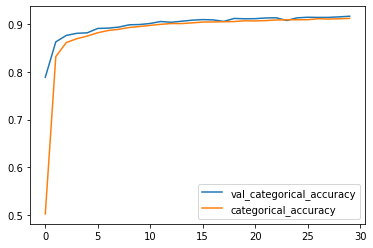

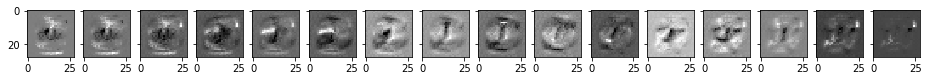

{'val_acc': 0.9160000026226044, 'train_acc': 0.9114999989668529, 'val_loss': 0.05593865364789963, 'train_loss': 0.05728185934325059}
Layer 0


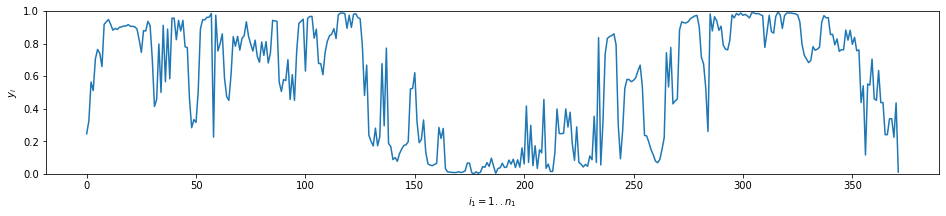

IntDer, Conv {'derivative': 77.5952, 'smoothness': 0.22252543}
Layer 1


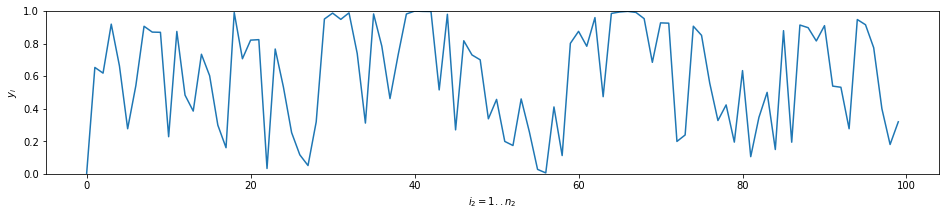

IntDer, Conv {'derivative': 76.183716, 'smoothness': 0.36356664}
Layer 2


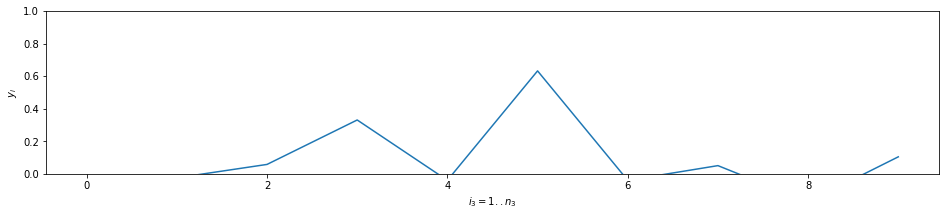

IntDer, Conv {'derivative': 72.655075, 'smoothness': 0.0}
True ans #0 5


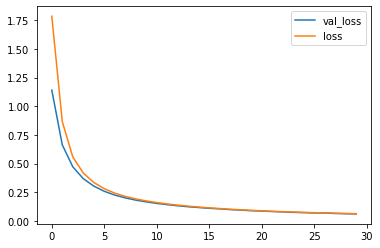

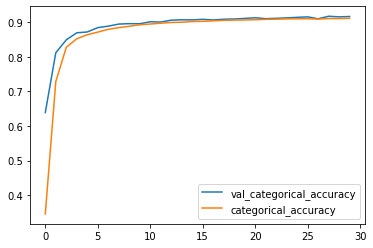

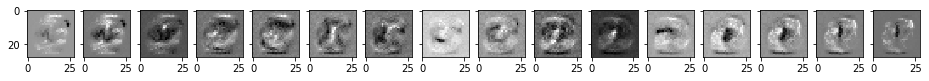

{'val_acc': 0.9159999907016754, 'train_acc': 0.9108000000317892, 'val_loss': 0.062490498274564744, 'train_loss': 0.06429195913175742}
Layer 0


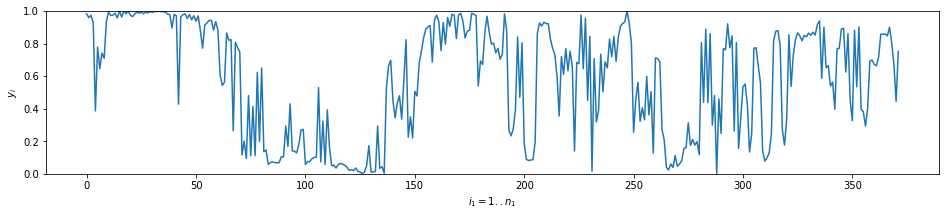

IntDer, Conv {'derivative': 77.40651, 'smoothness': 0.22985777}
Layer 1


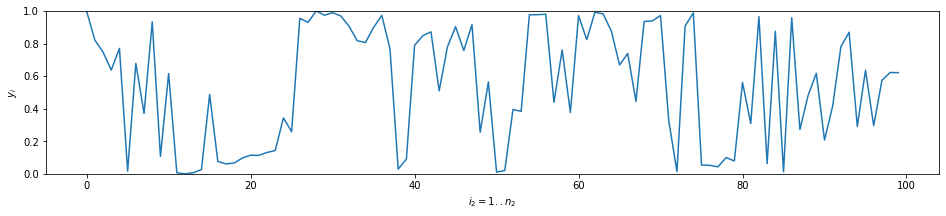

IntDer, Conv {'derivative': 106.20209, 'smoothness': 0.52017236}
Layer 2


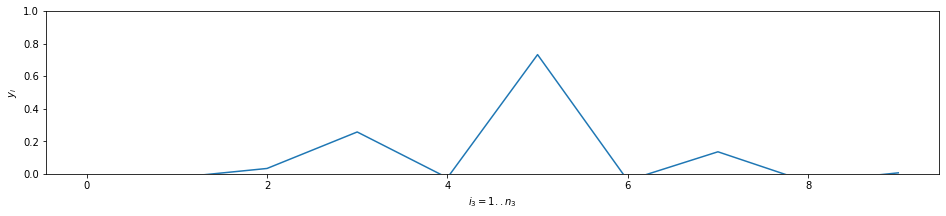

IntDer, Conv {'derivative': 77.892654, 'smoothness': 0.0}
True ans #0 5


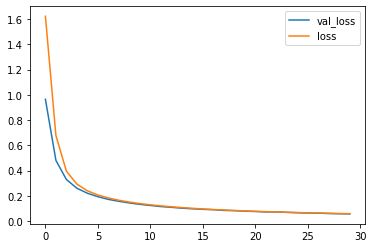

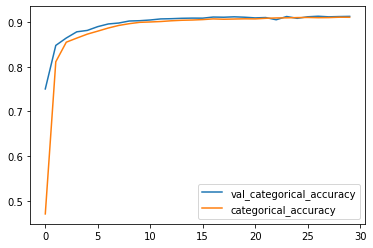

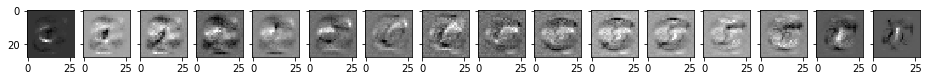

{'val_acc': 0.9132000088691712, 'train_acc': 0.9111666689316432, 'val_loss': 0.05734279714524746, 'train_loss': 0.059176290221512315}
Layer 0


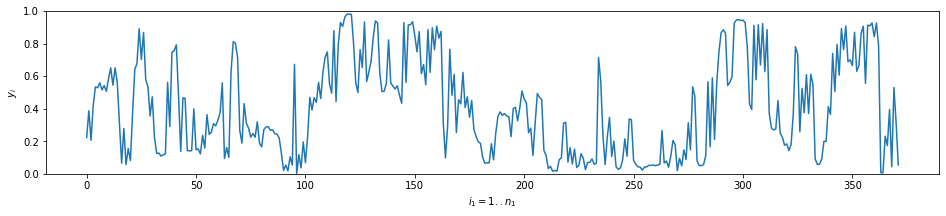

IntDer, Conv {'derivative': 80.001785, 'smoothness': 0.2370126}
Layer 1


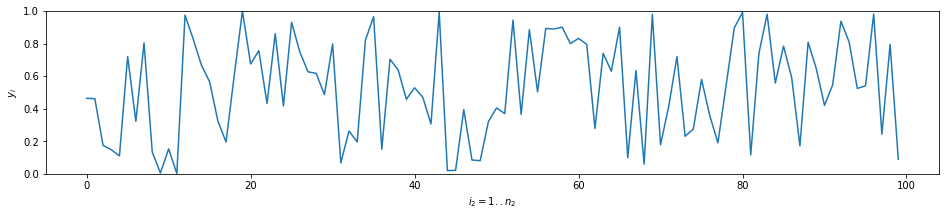

IntDer, Conv {'derivative': 80.347694, 'smoothness': 0.38441455}
Layer 2


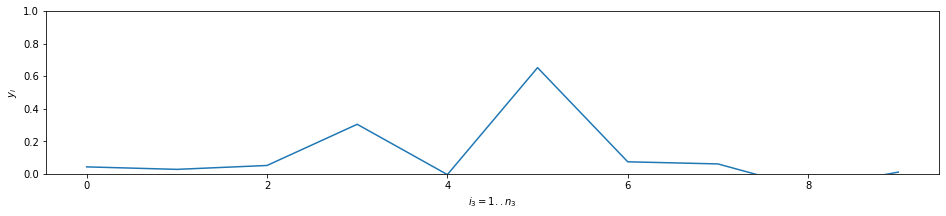

IntDer, Conv {'derivative': 75.45155, 'smoothness': 0.0}
True ans #0 5


 30%|███       | 3/10 [11:11<25:36, 219.49s/it]

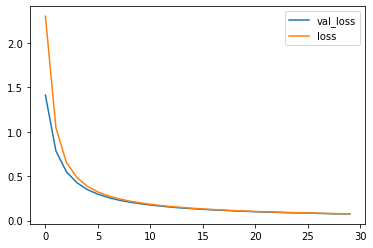

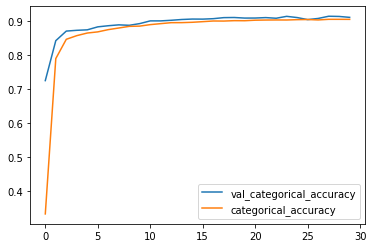

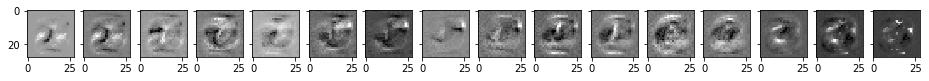

{'val_acc': 0.9120999991893768, 'train_acc': 0.9062000006437302, 'val_loss': 0.0750491552054882, 'train_loss': 0.07599292856951555}
Layer 0


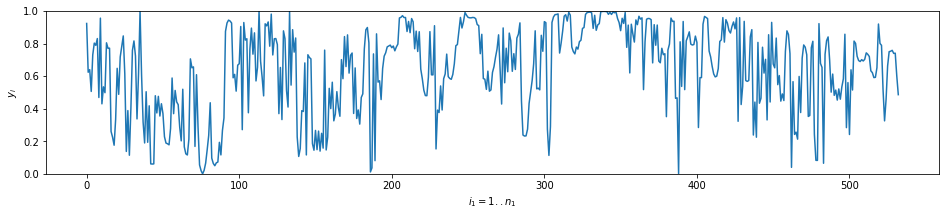

IntDer, Conv {'derivative': 95.43093, 'smoothness': 0.24146836}
Layer 1


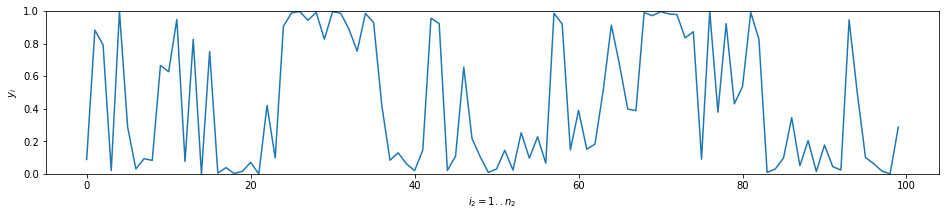

IntDer, Conv {'derivative': 117.81308, 'smoothness': 0.581982}
Layer 2


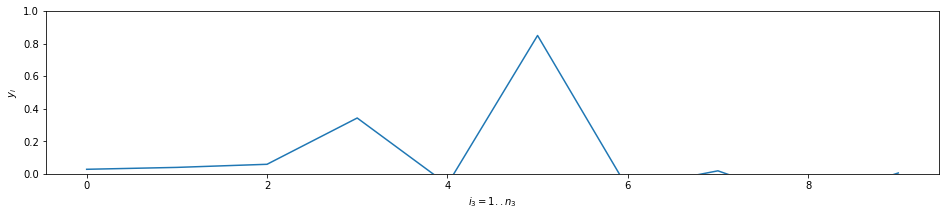

IntDer, Conv {'derivative': 76.282394, 'smoothness': 0.0}
True ans #0 5


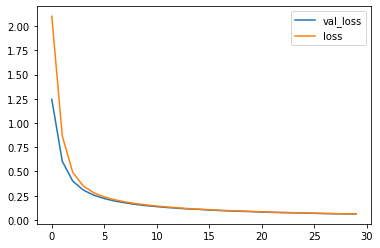

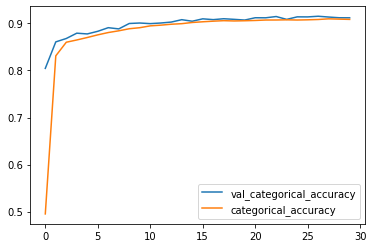

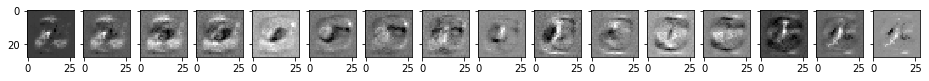

{'val_acc': 0.9119999945163727, 'train_acc': 0.9086166669925054, 'val_loss': 0.062430192902684215, 'train_loss': 0.062414533582826455}
Layer 0


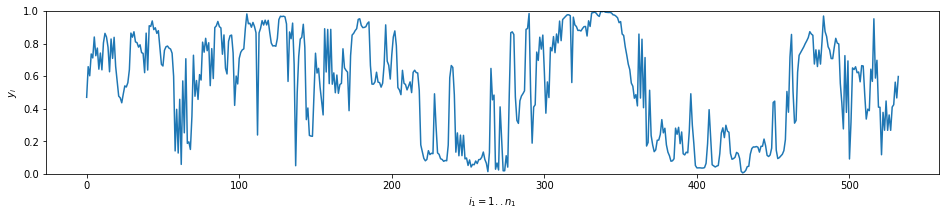

IntDer, Conv {'derivative': 91.60341, 'smoothness': 0.2333591}
Layer 1


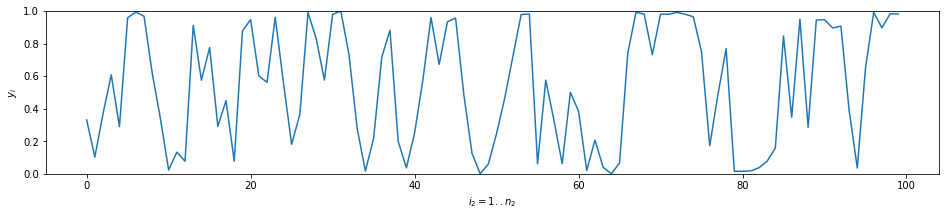

IntDer, Conv {'derivative': 84.36399, 'smoothness': 0.3933342}
Layer 2


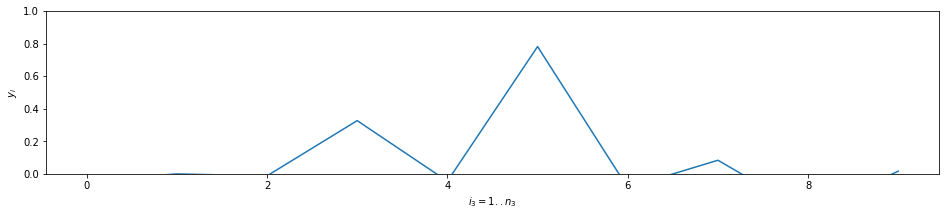

IntDer, Conv {'derivative': 73.562195, 'smoothness': 0.0}
True ans #0 5


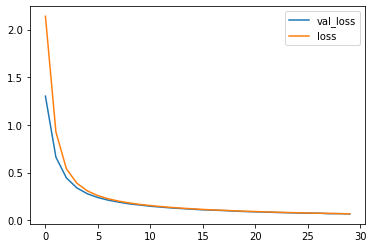

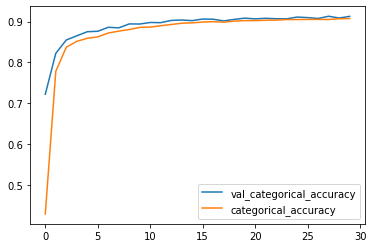

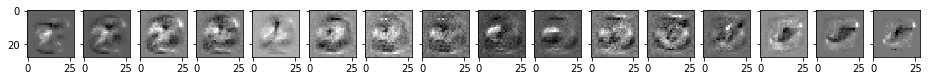

{'val_acc': 0.9126000046730042, 'train_acc': 0.9071666647990545, 'val_loss': 0.06559315398335457, 'train_loss': 0.06666087396442891}
Layer 0


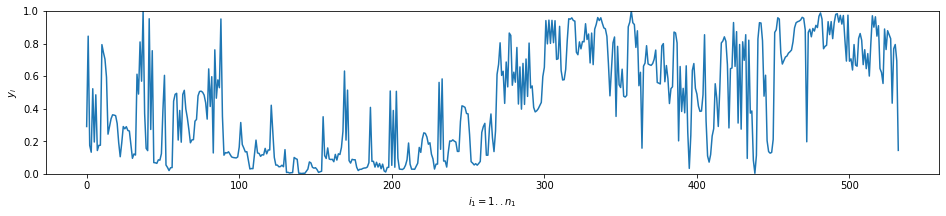

IntDer, Conv {'derivative': 93.84103, 'smoothness': 0.24344404}
Layer 1


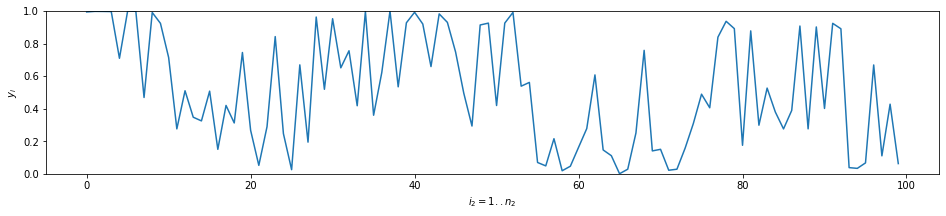

IntDer, Conv {'derivative': 95.54451, 'smoothness': 0.46095884}
Layer 2


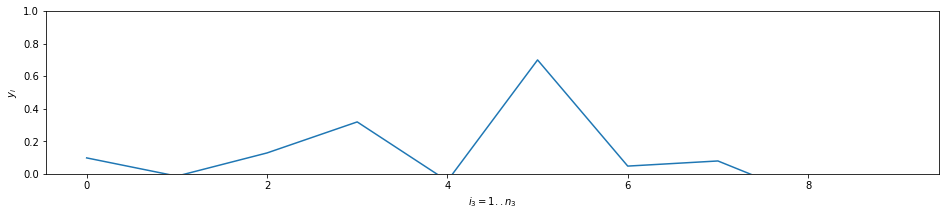

IntDer, Conv {'derivative': 76.58502, 'smoothness': 0.0}
True ans #0 5


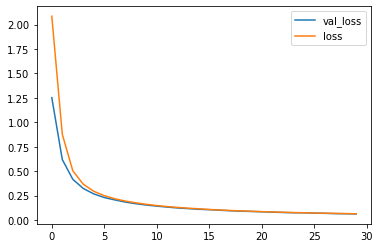

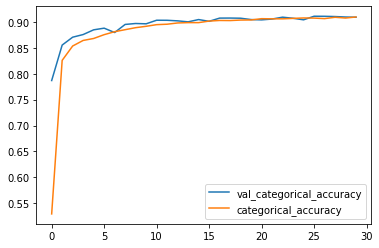

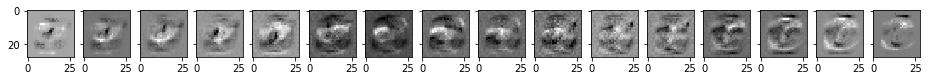

{'val_acc': 0.9088999927043915, 'train_acc': 0.9093833317359289, 'val_loss': 0.0617741297930479, 'train_loss': 0.06267480632911125}
Layer 0


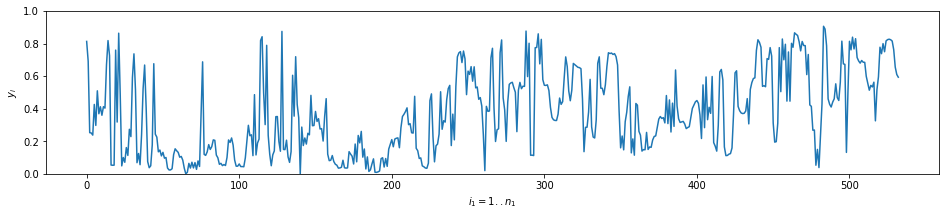

IntDer, Conv {'derivative': 89.36972, 'smoothness': 0.21805298}
Layer 1


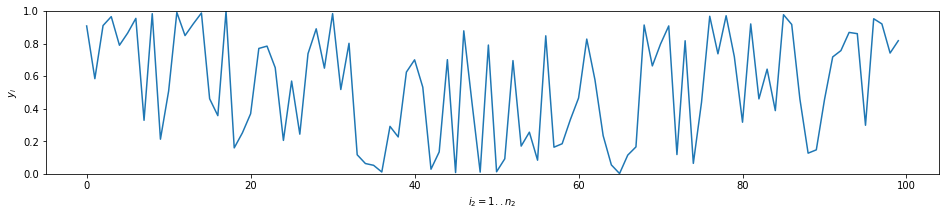

IntDer, Conv {'derivative': 83.185455, 'smoothness': 0.39717346}
Layer 2


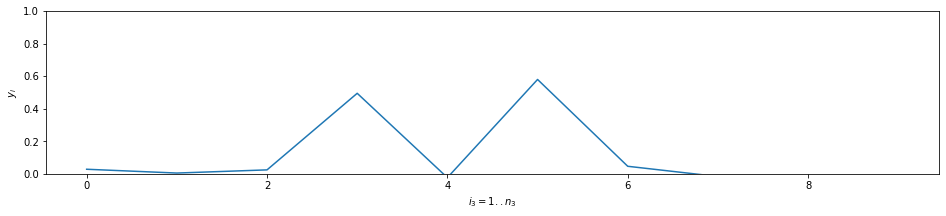

IntDer, Conv {'derivative': 73.78735, 'smoothness': 0.0}
True ans #0 5


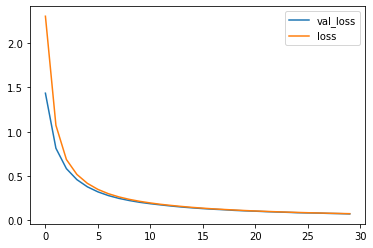

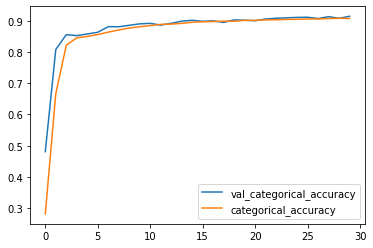

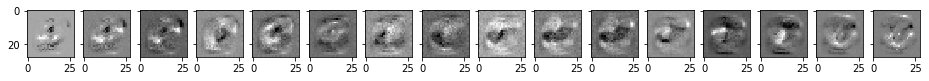

{'val_acc': 0.914300000667572, 'train_acc': 0.9072000016768773, 'val_loss': 0.07185089886188507, 'train_loss': 0.07454092726111412}
Layer 0


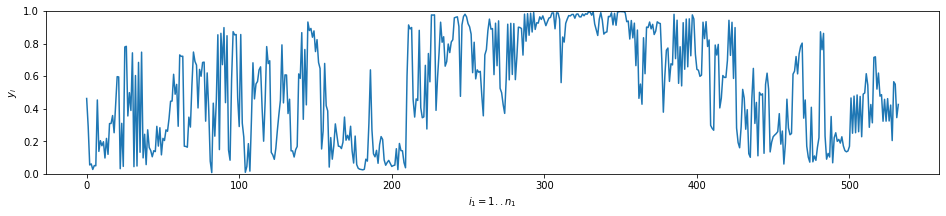

IntDer, Conv {'derivative': 88.40605, 'smoothness': 0.2205042}
Layer 1


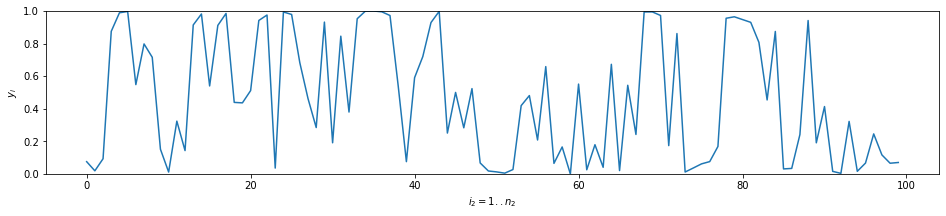

IntDer, Conv {'derivative': 127.341484, 'smoothness': 0.6425284}
Layer 2


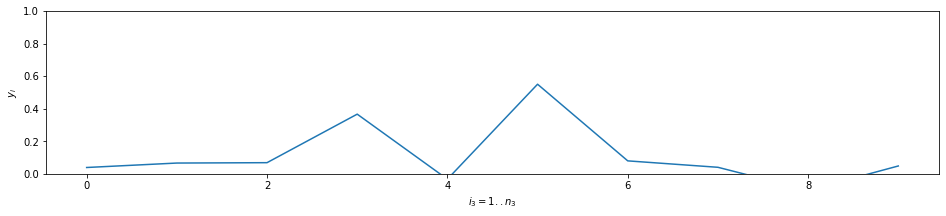

IntDer, Conv {'derivative': 75.11745, 'smoothness': 0.0}
True ans #0 5


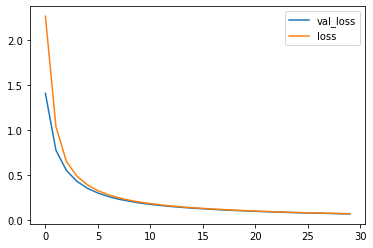

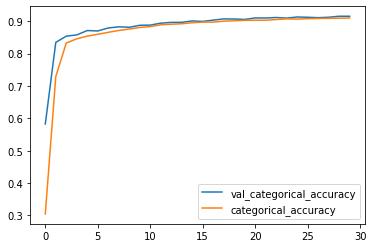

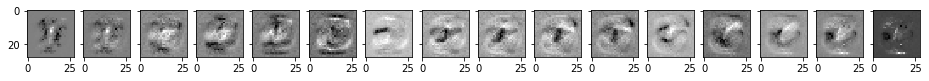

{'val_acc': 0.9156000018119812, 'train_acc': 0.9102166662613551, 'val_loss': 0.06538951620459557, 'train_loss': 0.06749752076963583}
Layer 0


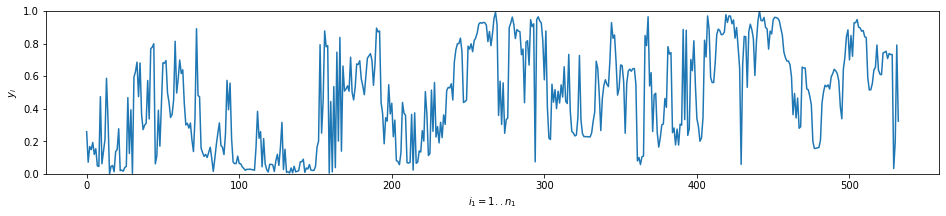

IntDer, Conv {'derivative': 84.776764, 'smoothness': 0.2045471}
Layer 1


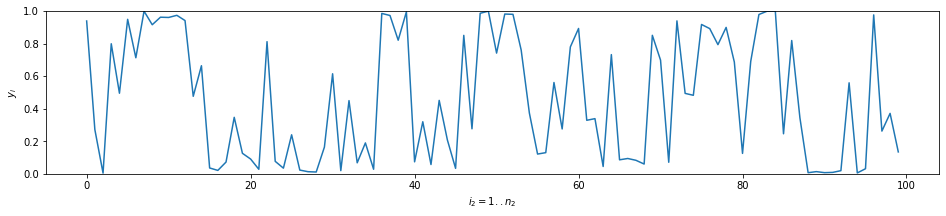

IntDer, Conv {'derivative': 102.12626, 'smoothness': 0.49815783}
Layer 2


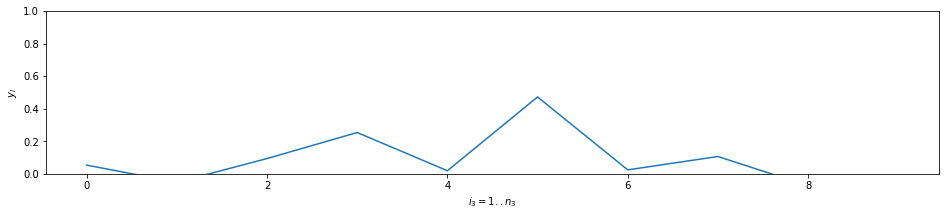

IntDer, Conv {'derivative': 74.71367, 'smoothness': 0.0}
True ans #0 5


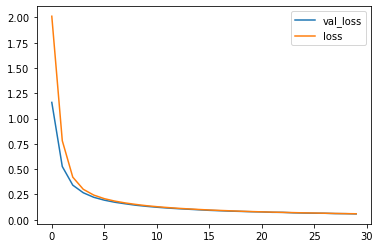

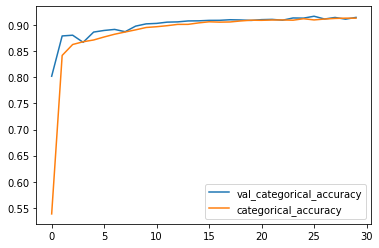

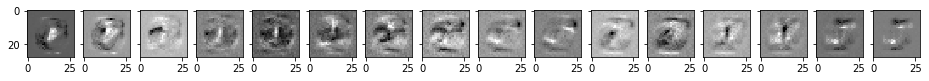

{'val_acc': 0.91460000872612, 'train_acc': 0.9131000022093455, 'val_loss': 0.05784334391355515, 'train_loss': 0.05947664187600215}
Layer 0


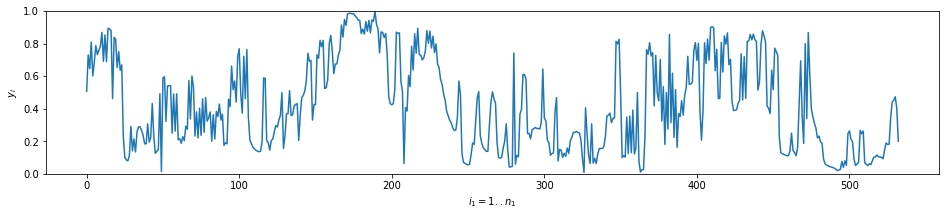

IntDer, Conv {'derivative': 91.097176, 'smoothness': 0.23321047}
Layer 1


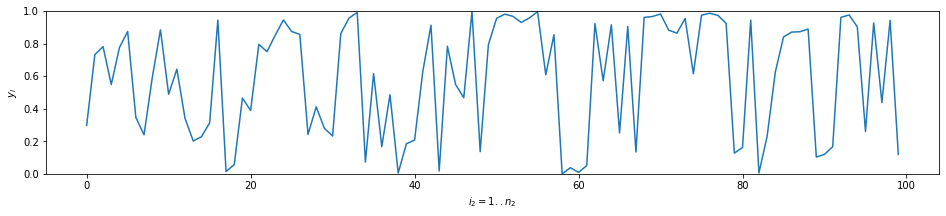

IntDer, Conv {'derivative': 75.72576, 'smoothness': 0.35589737}
Layer 2


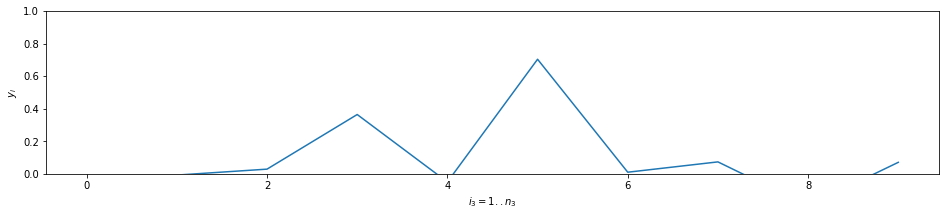

IntDer, Conv {'derivative': 77.90247, 'smoothness': 0.0}
True ans #0 5


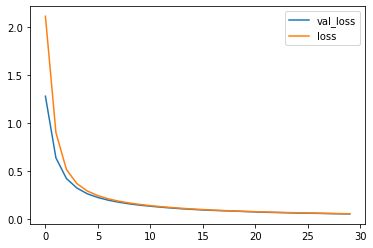

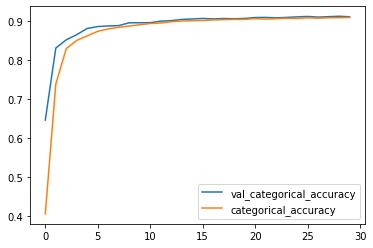

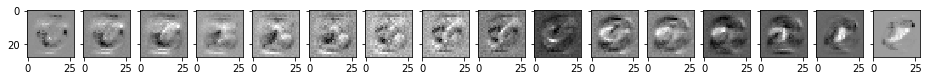

{'val_acc': 0.9115000069141388, 'train_acc': 0.9098000029722849, 'val_loss': 0.05619192644953728, 'train_loss': 0.057739675231277945}
Layer 0


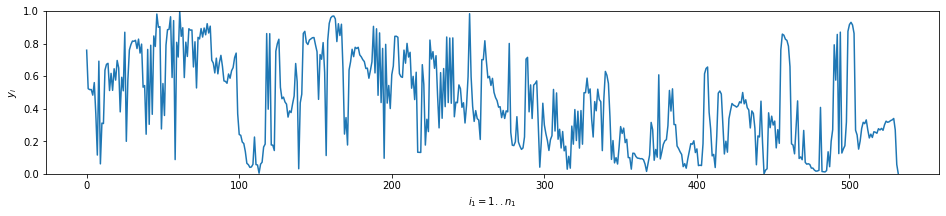

IntDer, Conv {'derivative': 83.86553, 'smoothness': 0.19950786}
Layer 1


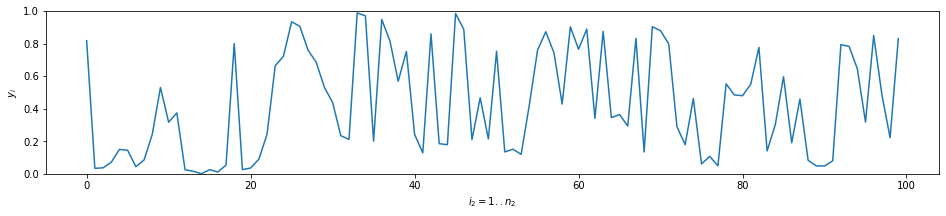

IntDer, Conv {'derivative': 73.50064, 'smoothness': 0.3419431}
Layer 2


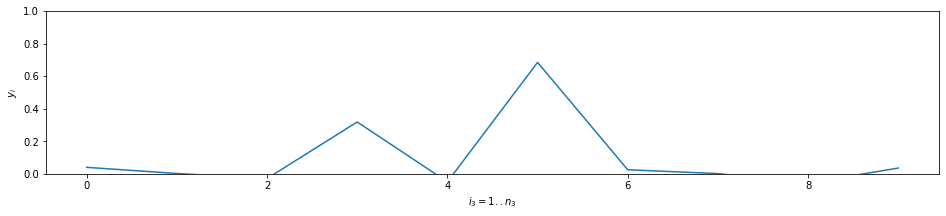

IntDer, Conv {'derivative': 74.04235, 'smoothness': 0.0}
True ans #0 5


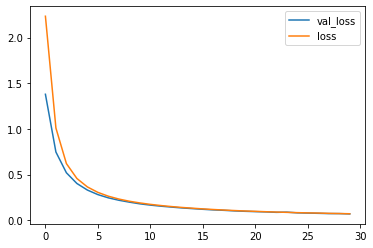

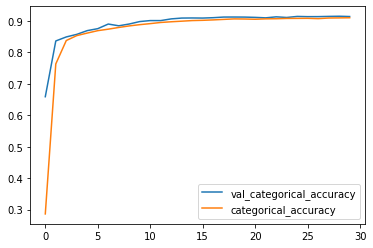

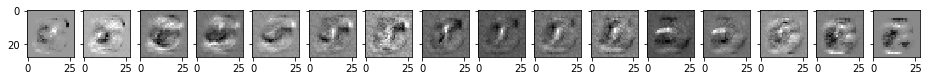

{'val_acc': 0.914000004529953, 'train_acc': 0.9101000001033147, 'val_loss': 0.0686352513730526, 'train_loss': 0.07045152621964614}
Layer 0


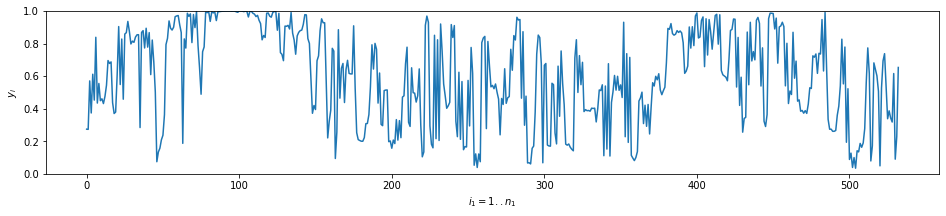

IntDer, Conv {'derivative': 93.5647, 'smoothness': 0.23562336}
Layer 1


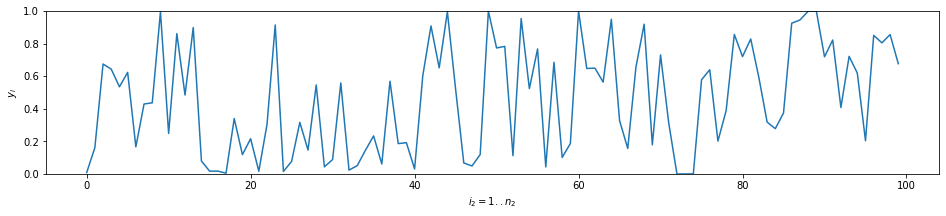

IntDer, Conv {'derivative': 102.60045, 'smoothness': 0.49122816}
Layer 2


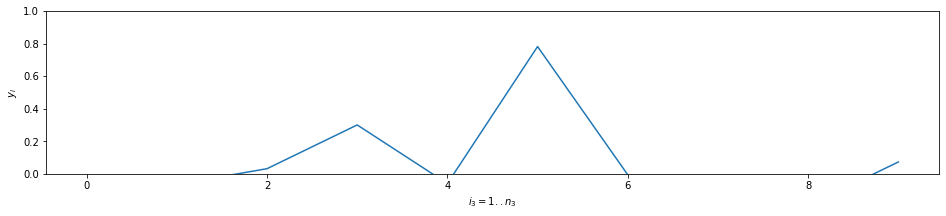

IntDer, Conv {'derivative': 75.77217, 'smoothness': 0.0}
True ans #0 5


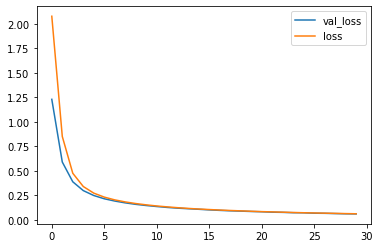

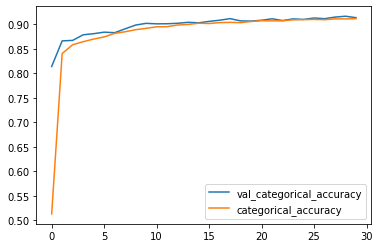

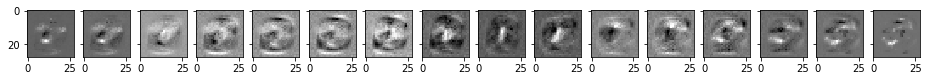

{'val_acc': 0.9138000011444092, 'train_acc': 0.9118833363056182, 'val_loss': 0.06120121330022812, 'train_loss': 0.0627058543264866}
Layer 0


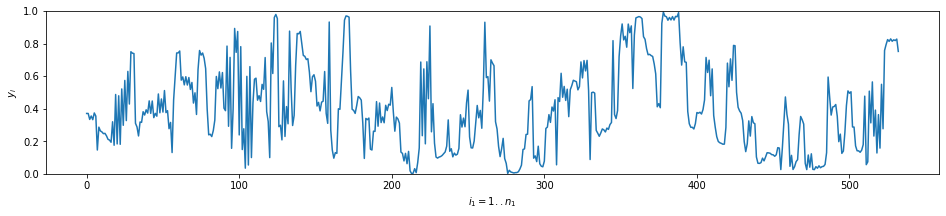

IntDer, Conv {'derivative': 85.41641, 'smoothness': 0.21271008}
Layer 1


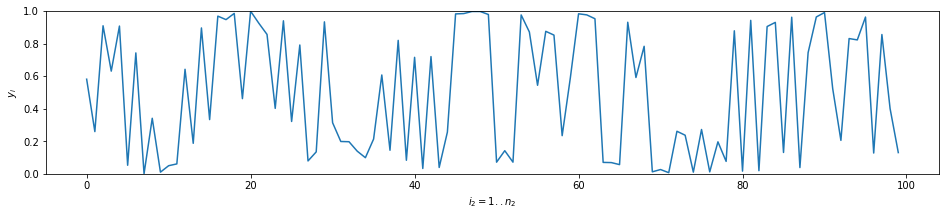

IntDer, Conv {'derivative': 83.988106, 'smoothness': 0.41191566}
Layer 2


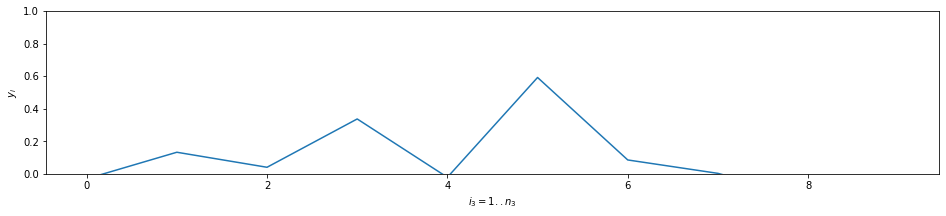

IntDer, Conv {'derivative': 74.388, 'smoothness': 0.0}
True ans #0 5


 40%|████      | 4/10 [16:03<24:07, 241.22s/it]

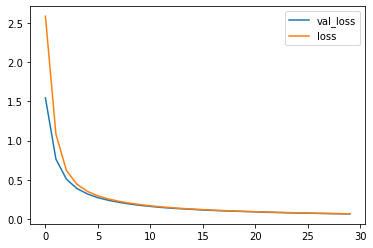

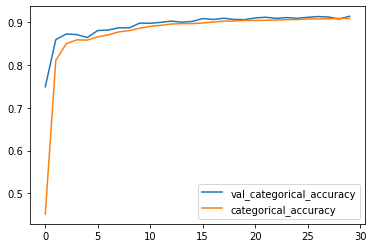

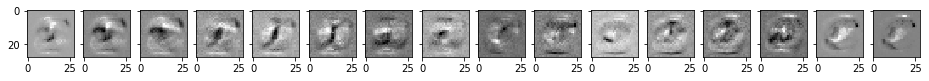

{'val_acc': 0.9146000027656556, 'train_acc': 0.9093333343664806, 'val_loss': 0.06475487910211086, 'train_loss': 0.06635919225712618}
Layer 0


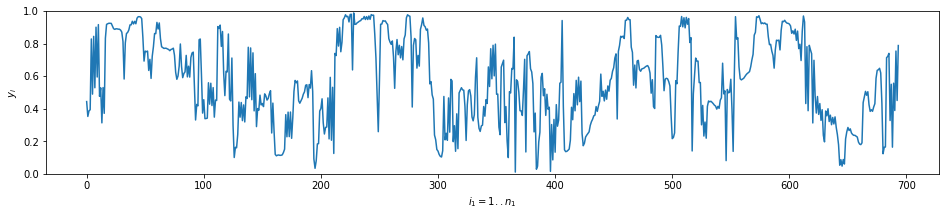

IntDer, Conv {'derivative': 101.61456, 'smoothness': 0.20759624}
Layer 1


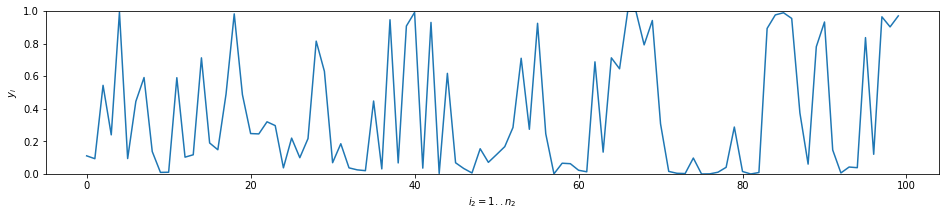

IntDer, Conv {'derivative': 92.53327, 'smoothness': 0.43446797}
Layer 2


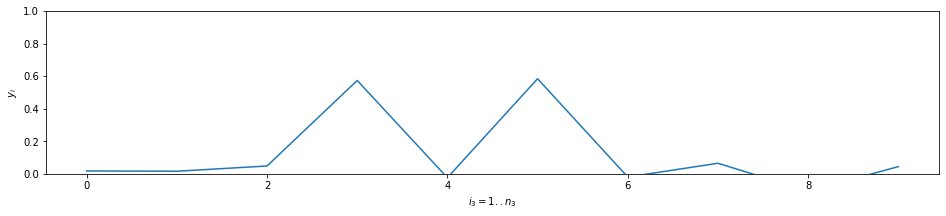

IntDer, Conv {'derivative': 75.60176, 'smoothness': 0.0}
True ans #0 5


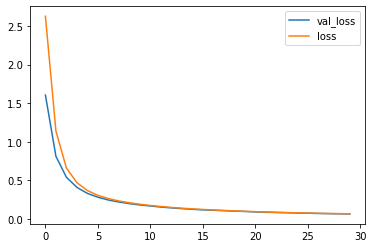

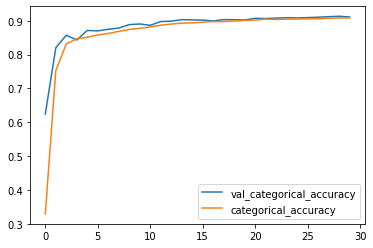

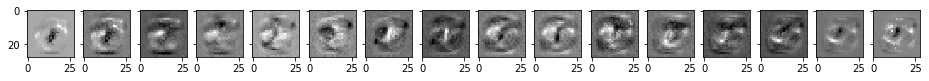

{'val_acc': 0.9111000001430511, 'train_acc': 0.9084000051021576, 'val_loss': 0.0651754193007946, 'train_loss': 0.06651207556327184}
Layer 0


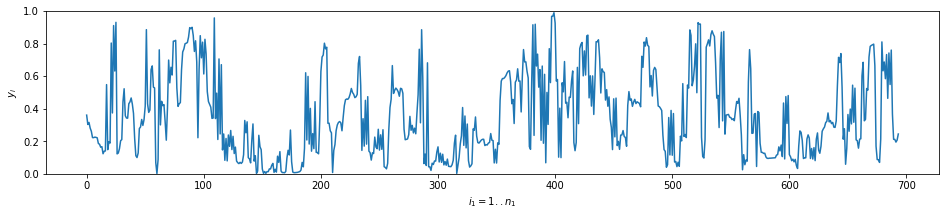

IntDer, Conv {'derivative': 97.795616, 'smoothness': 0.20189157}
Layer 1


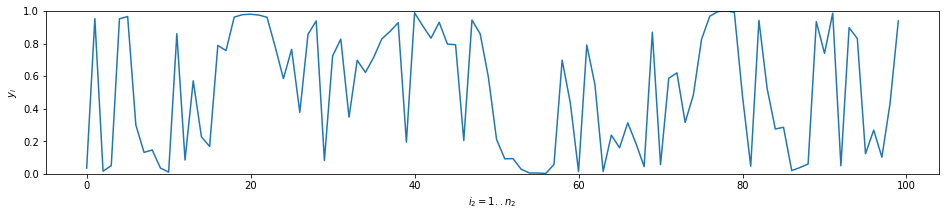

IntDer, Conv {'derivative': 90.13515, 'smoothness': 0.43136495}
Layer 2


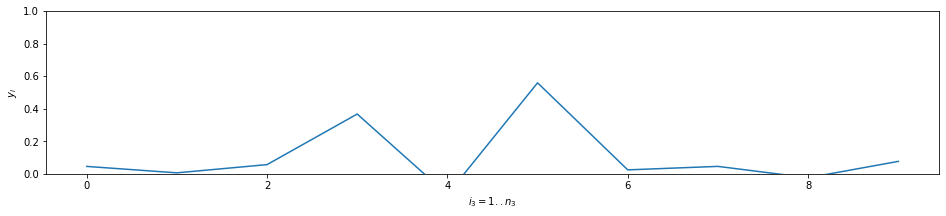

IntDer, Conv {'derivative': 74.19719, 'smoothness': 0.0}
True ans #0 5


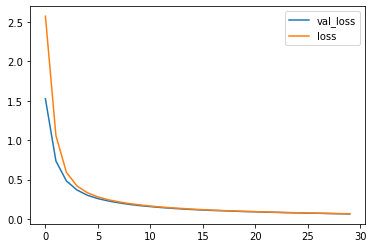

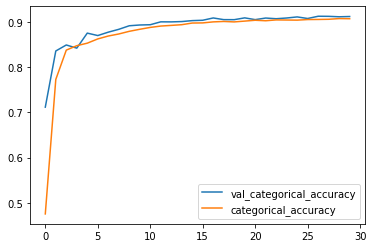

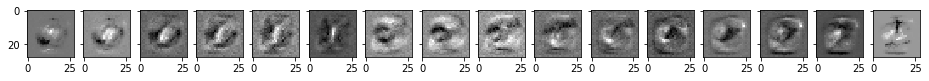

{'val_acc': 0.9126999974250793, 'train_acc': 0.9078000009059906, 'val_loss': 0.06447735168039799, 'train_loss': 0.06636867113411427}
Layer 0


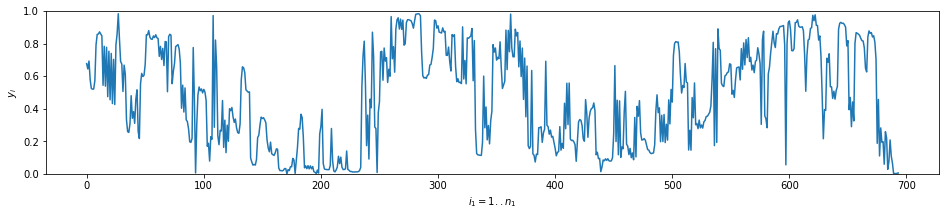

IntDer, Conv {'derivative': 99.576035, 'smoothness': 0.21130395}
Layer 1


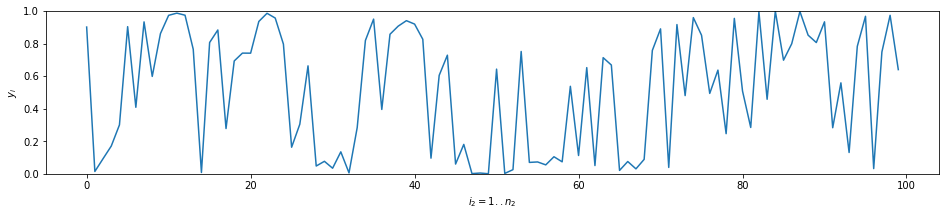

IntDer, Conv {'derivative': 87.92028, 'smoothness': 0.42670187}
Layer 2


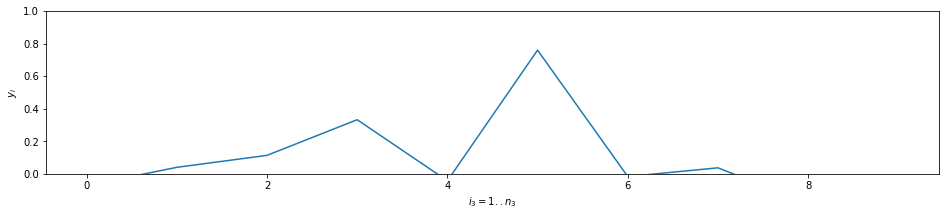

IntDer, Conv {'derivative': 75.80703, 'smoothness': 0.0}
True ans #0 5


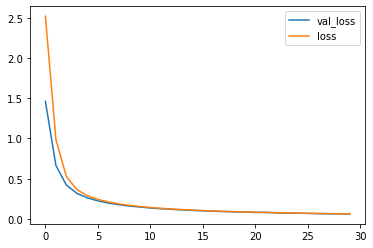

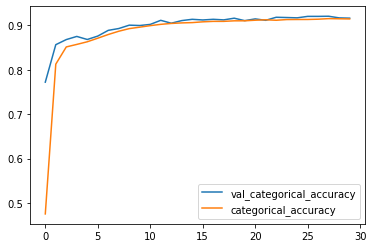

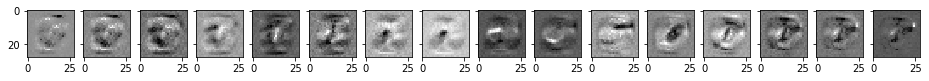

{'val_acc': 0.916399997472763, 'train_acc': 0.9146333336830139, 'val_loss': 0.06200792379677296, 'train_loss': 0.062282136641442776}
Layer 0


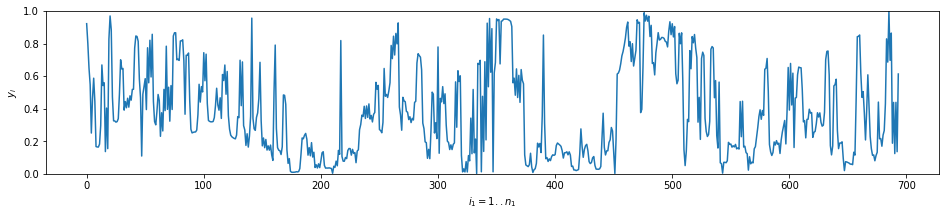

IntDer, Conv {'derivative': 102.72693, 'smoothness': 0.221486}
Layer 1


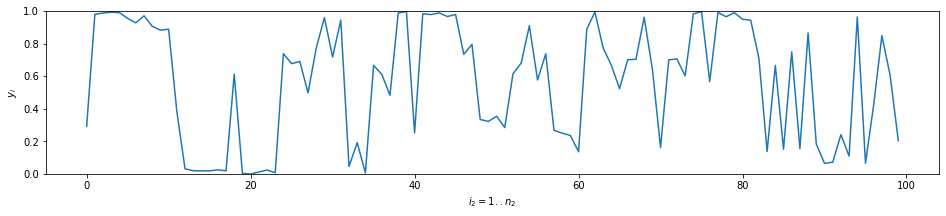

IntDer, Conv {'derivative': 74.28958, 'smoothness': 0.34721163}
Layer 2


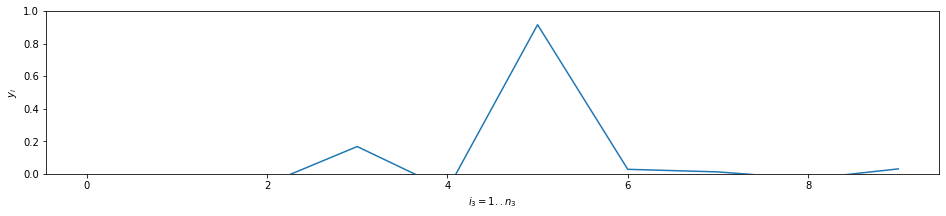

IntDer, Conv {'derivative': 71.44925, 'smoothness': 0.0}
True ans #0 5


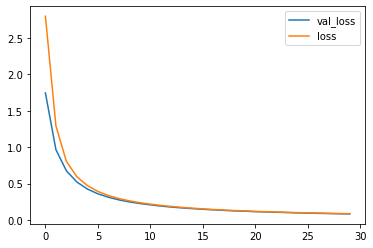

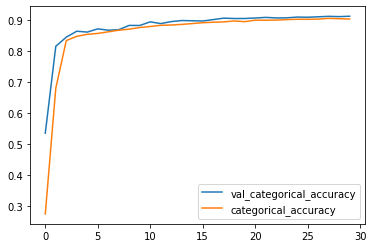

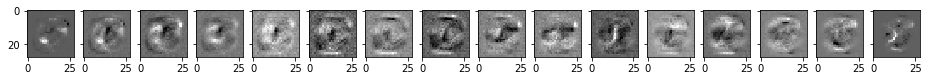

{'val_acc': 0.9110000014305115, 'train_acc': 0.9019833326339721, 'val_loss': 0.08369235768914222, 'train_loss': 0.08687151397267977}
Layer 0


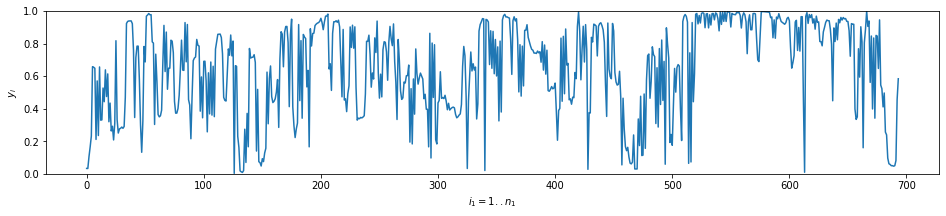

IntDer, Conv {'derivative': 108.628204, 'smoothness': 0.24946266}
Layer 1


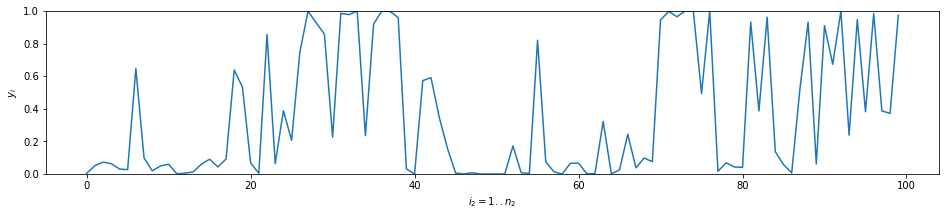

IntDer, Conv {'derivative': 138.06522, 'smoothness': 0.7103818}
Layer 2


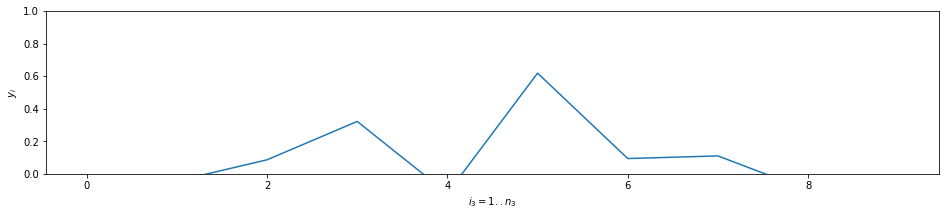

IntDer, Conv {'derivative': 75.23013, 'smoothness': 0.0}
True ans #0 5


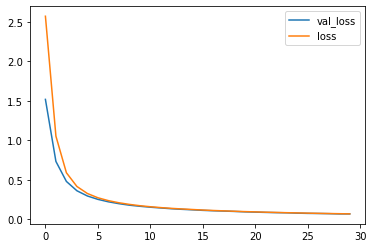

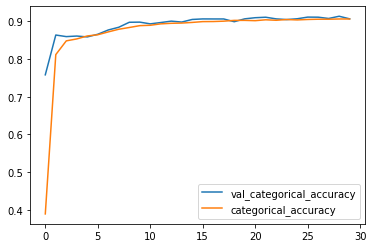

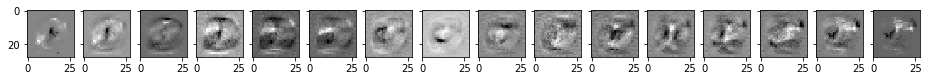

{'val_acc': 0.9065999925136566, 'train_acc': 0.9062166670958202, 'val_loss': 0.06982269361615182, 'train_loss': 0.07047253337999185}
Layer 0


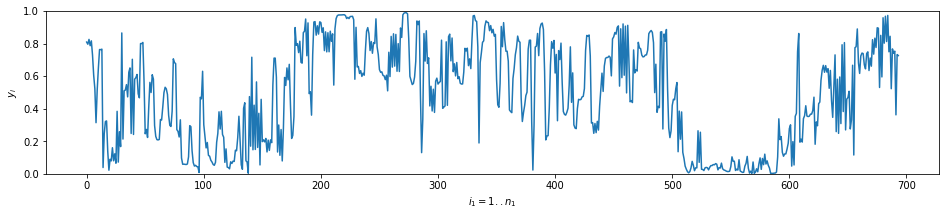

IntDer, Conv {'derivative': 103.87503, 'smoothness': 0.22251031}
Layer 1


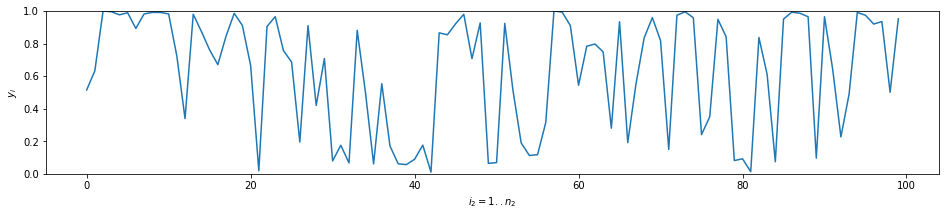

IntDer, Conv {'derivative': 89.655396, 'smoothness': 0.43375167}
Layer 2


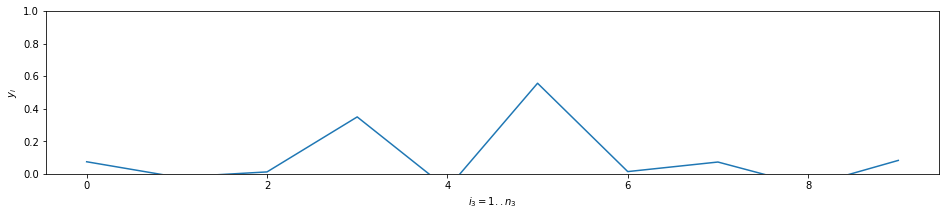

IntDer, Conv {'derivative': 74.97578, 'smoothness': 0.0}
True ans #0 5


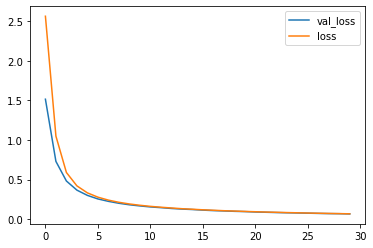

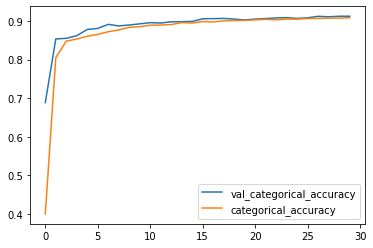

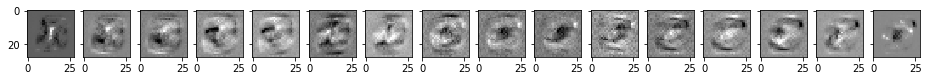

{'val_acc': 0.9123999953269959, 'train_acc': 0.9086500028769176, 'val_loss': 0.06757646724581719, 'train_loss': 0.06893256530165673}
Layer 0


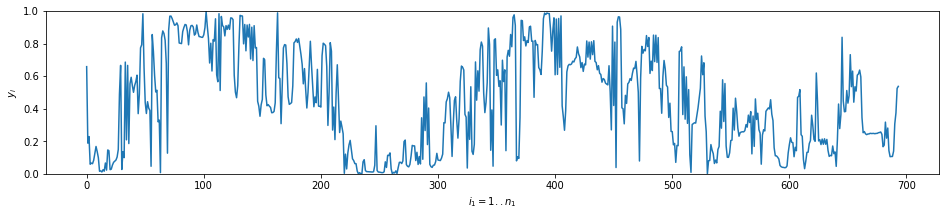

IntDer, Conv {'derivative': 102.28712, 'smoothness': 0.21321213}
Layer 1


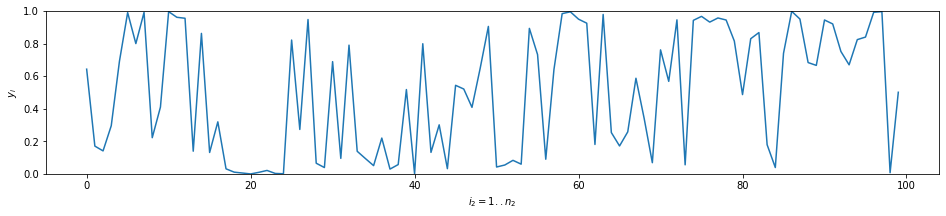

IntDer, Conv {'derivative': 87.83231, 'smoothness': 0.42056704}
Layer 2


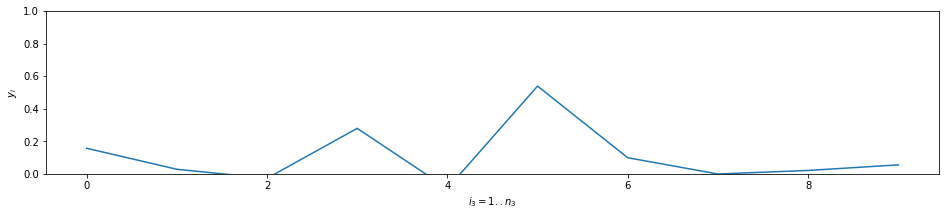

IntDer, Conv {'derivative': 72.77054, 'smoothness': 0.0}
True ans #0 5


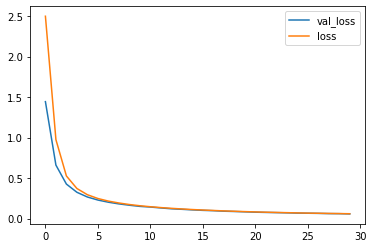

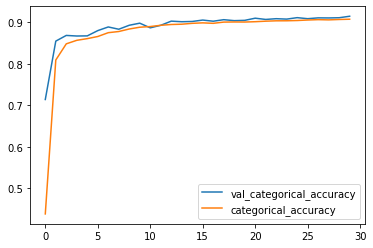

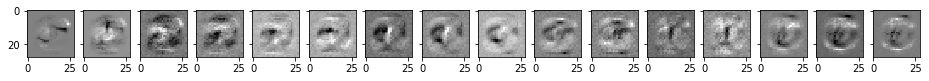

{'val_acc': 0.9148000001907348, 'train_acc': 0.9076166679461797, 'val_loss': 0.05779634229838848, 'train_loss': 0.06003723852336407}
Layer 0


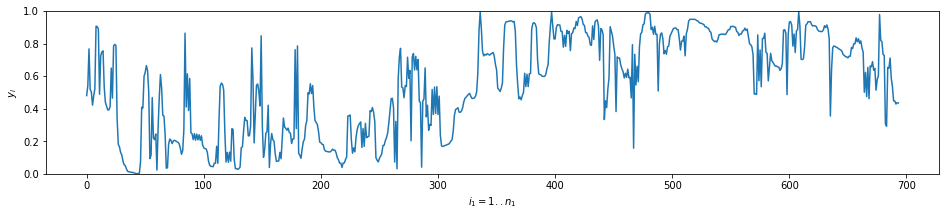

IntDer, Conv {'derivative': 98.46304, 'smoothness': 0.19733292}
Layer 1


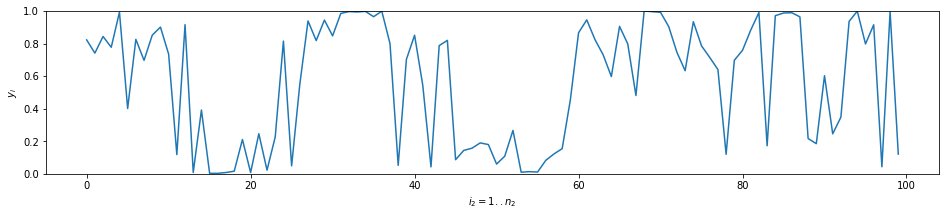

IntDer, Conv {'derivative': 72.520294, 'smoothness': 0.34445268}
Layer 2


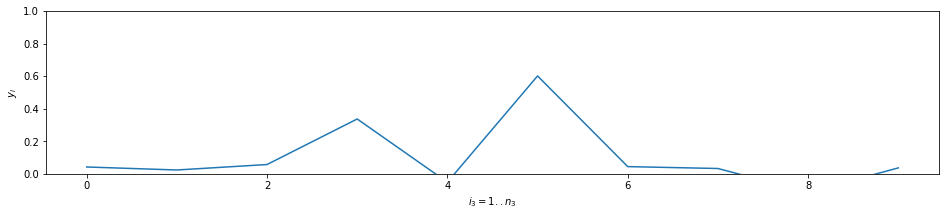

IntDer, Conv {'derivative': 71.8437, 'smoothness': 0.0}
True ans #0 5


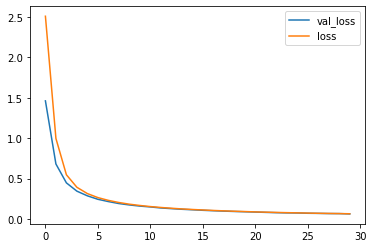

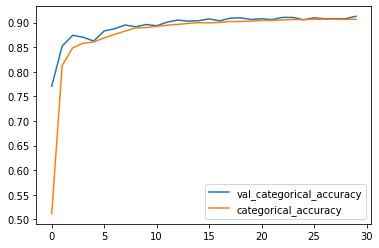

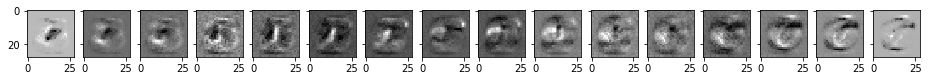

{'val_acc': 0.9128999948501587, 'train_acc': 0.9067500005165736, 'val_loss': 0.06203124821186066, 'train_loss': 0.06389996943374475}
Layer 0


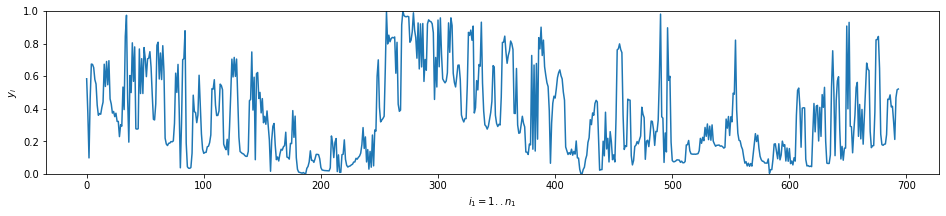

IntDer, Conv {'derivative': 97.53232, 'smoothness': 0.19560045}
Layer 1


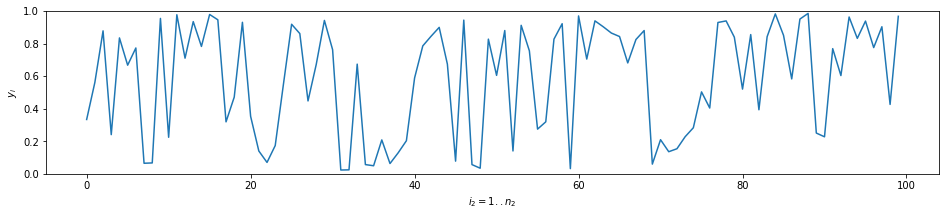

IntDer, Conv {'derivative': 79.72768, 'smoothness': 0.38651788}
Layer 2


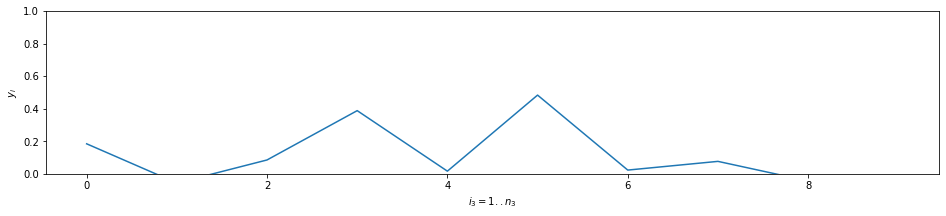

IntDer, Conv {'derivative': 71.905655, 'smoothness': 0.0}
True ans #0 5


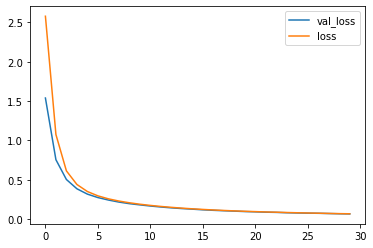

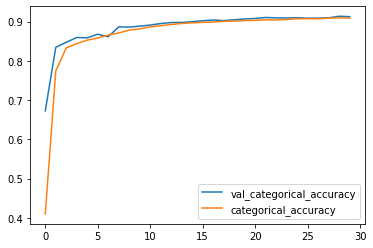

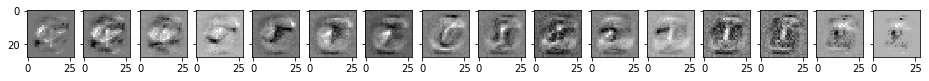

{'val_acc': 0.9126999914646149, 'train_acc': 0.9089333345492681, 'val_loss': 0.06541043557226658, 'train_loss': 0.0671268180012703}
Layer 0


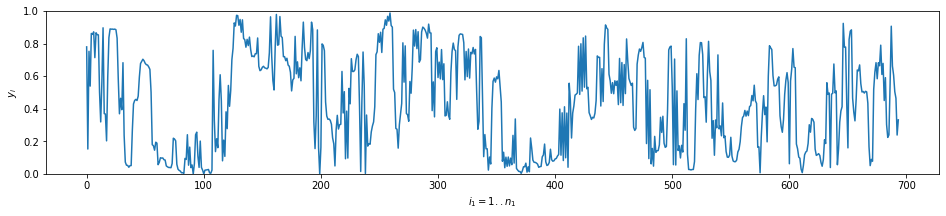

IntDer, Conv {'derivative': 100.78094, 'smoothness': 0.22037157}
Layer 1


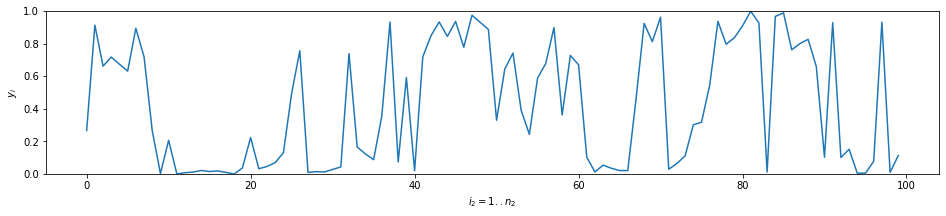

IntDer, Conv {'derivative': 89.61071, 'smoothness': 0.421637}
Layer 2


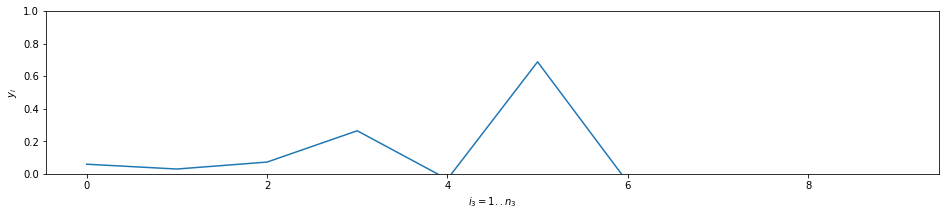

IntDer, Conv {'derivative': 75.403244, 'smoothness': 0.0}
True ans #0 5


 50%|█████     | 5/10 [21:44<22:35, 271.11s/it]

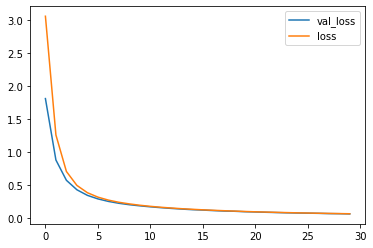

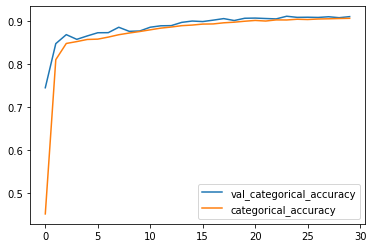

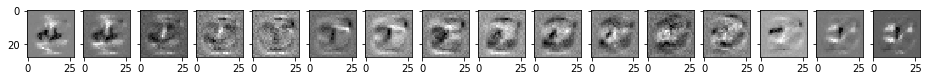

{'val_acc': 0.911300003528595, 'train_acc': 0.9073333332935969, 'val_loss': 0.068137301877141, 'train_loss': 0.07055270026127497}
Layer 0


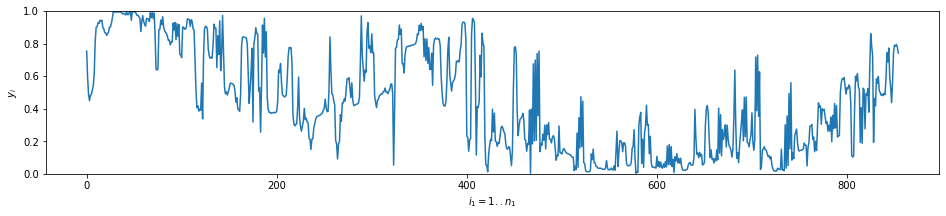

IntDer, Conv {'derivative': 110.246994, 'smoothness': 0.20040709}
Layer 1


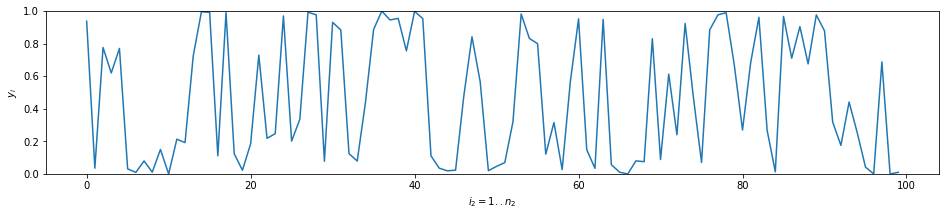

IntDer, Conv {'derivative': 92.7977, 'smoothness': 0.449715}
Layer 2


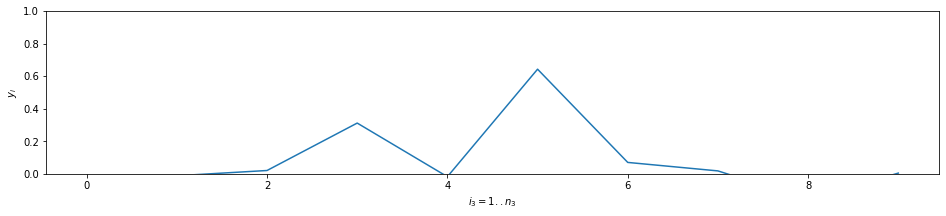

IntDer, Conv {'derivative': 69.71977, 'smoothness': 0.0}
True ans #0 5


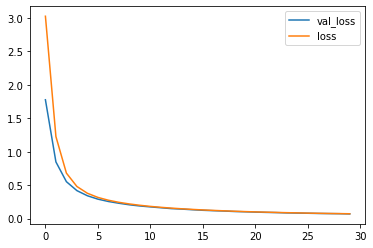

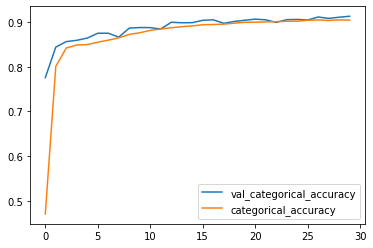

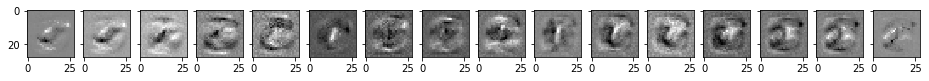

{'val_acc': 0.9131999969482422, 'train_acc': 0.9046166668335597, 'val_loss': 0.07052096873521804, 'train_loss': 0.07285476227601369}
Layer 0


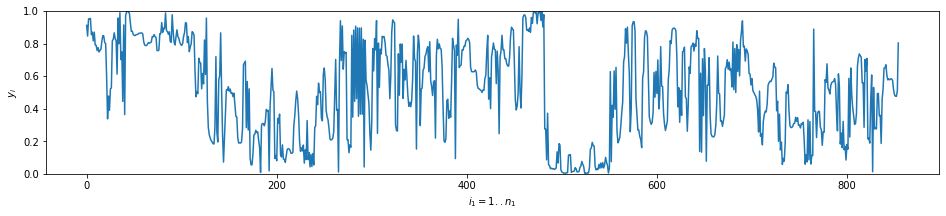

IntDer, Conv {'derivative': 113.2892, 'smoothness': 0.23089105}
Layer 1


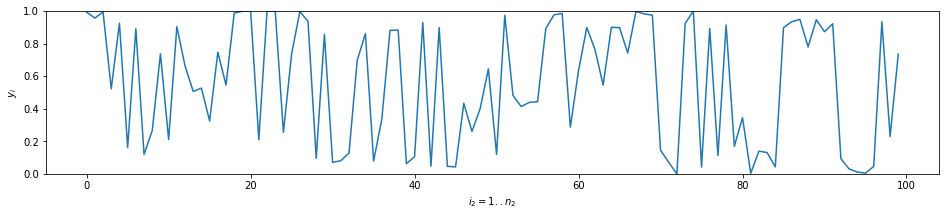

IntDer, Conv {'derivative': 95.10991, 'smoothness': 0.4641664}
Layer 2


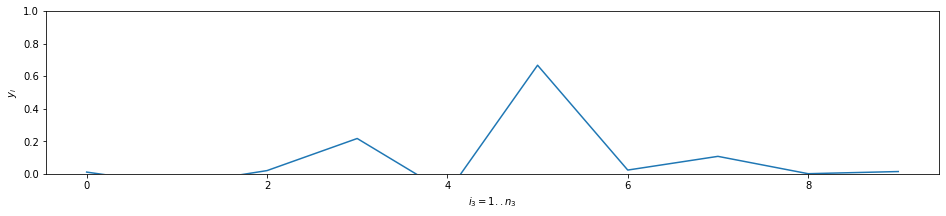

IntDer, Conv {'derivative': 72.038605, 'smoothness': 0.0}
True ans #0 5


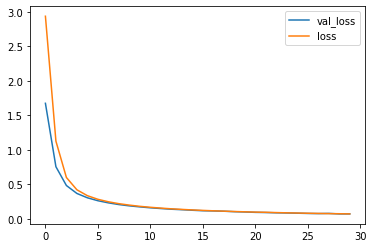

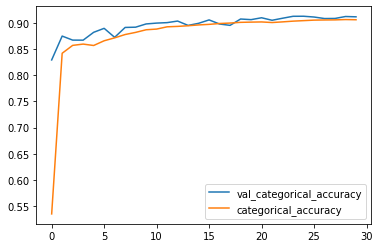

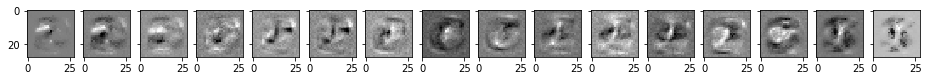

{'val_acc': 0.9116999983787537, 'train_acc': 0.9061166673898697, 'val_loss': 0.07239382863044738, 'train_loss': 0.07259954859813054}
Layer 0


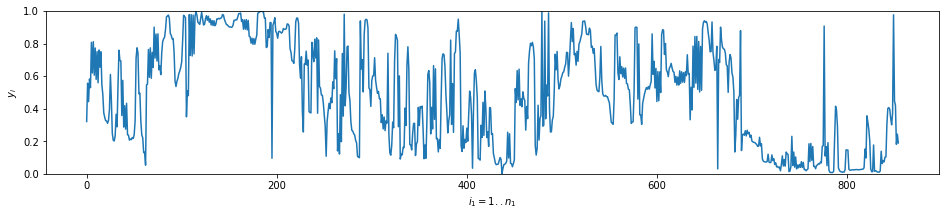

IntDer, Conv {'derivative': 115.53868, 'smoothness': 0.22498432}
Layer 1


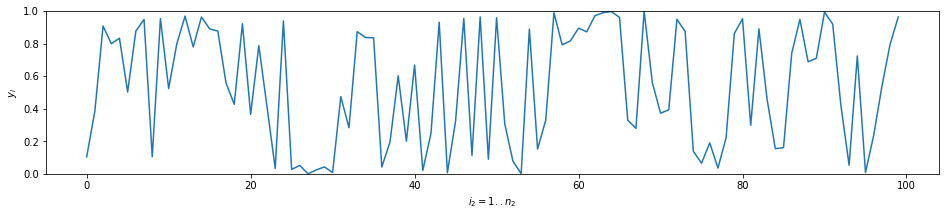

IntDer, Conv {'derivative': 89.192215, 'smoothness': 0.42980945}
Layer 2


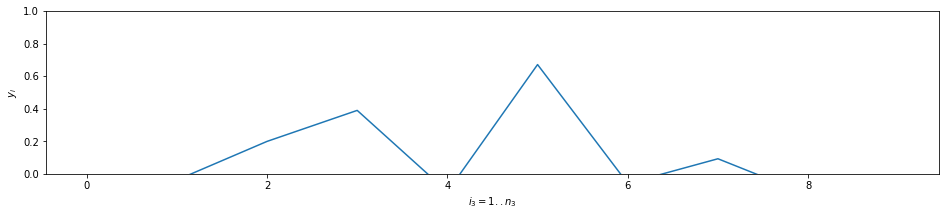

IntDer, Conv {'derivative': 72.31248, 'smoothness': 0.0}
True ans #0 5


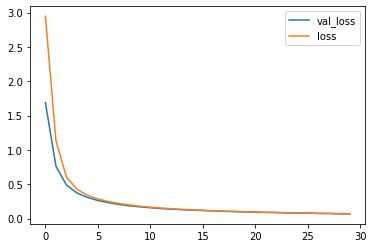

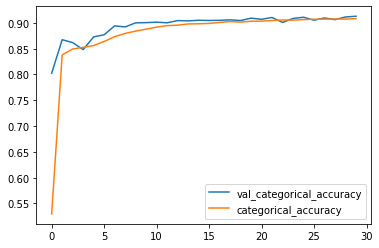

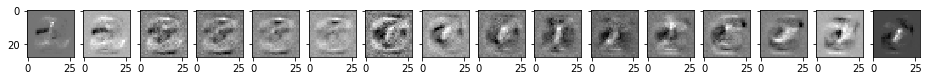

{'val_acc': 0.9129000067710876, 'train_acc': 0.9082333356142044, 'val_loss': 0.06708436161279678, 'train_loss': 0.06902958899736404}
Layer 0


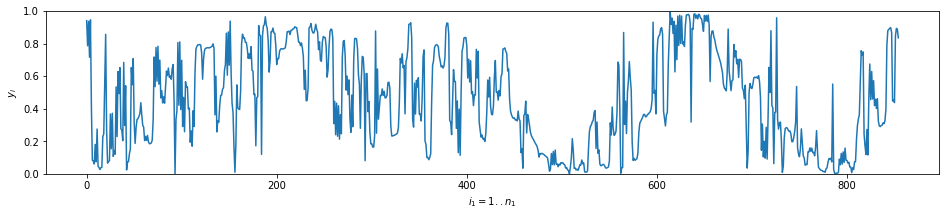

IntDer, Conv {'derivative': 110.32744, 'smoothness': 0.21816793}
Layer 1


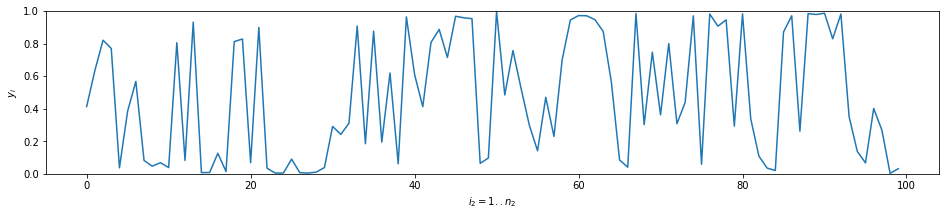

IntDer, Conv {'derivative': 85.39377, 'smoothness': 0.41162235}
Layer 2


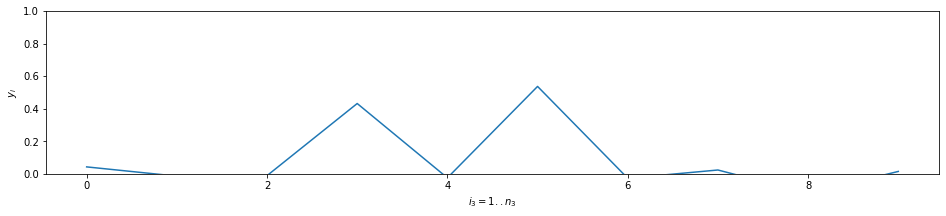

IntDer, Conv {'derivative': 70.21165, 'smoothness': 0.0}
True ans #0 5


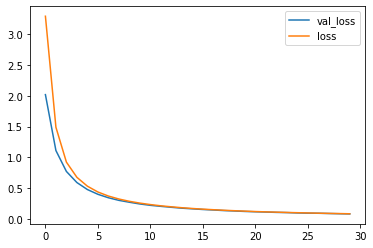

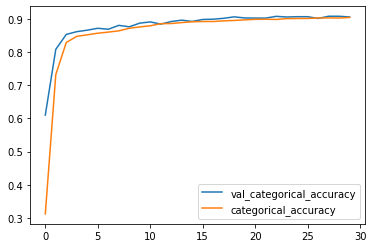

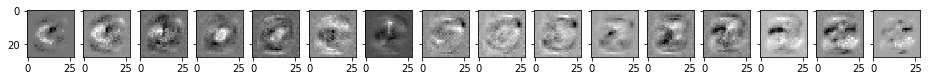

{'val_acc': 0.9060999989509583, 'train_acc': 0.9046666622161865, 'val_loss': 0.08092478215694428, 'train_loss': 0.08316401665409406}
Layer 0


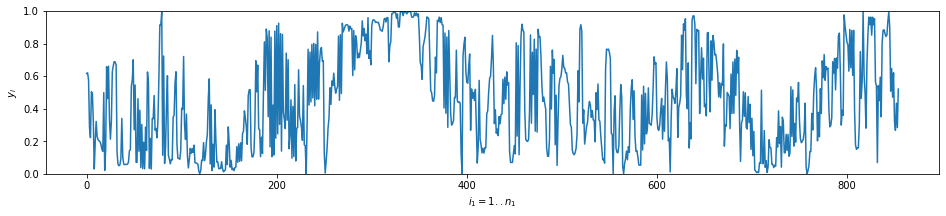

IntDer, Conv {'derivative': 115.34561, 'smoothness': 0.21870558}
Layer 1


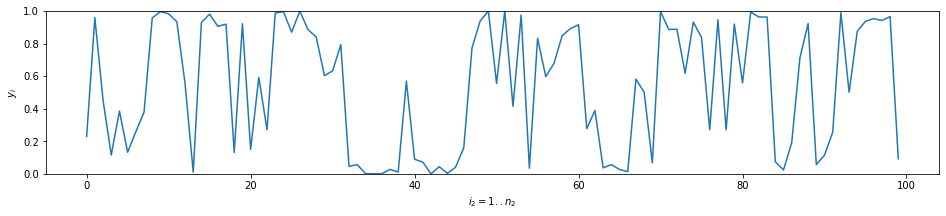

IntDer, Conv {'derivative': 119.38424, 'smoothness': 0.5763868}
Layer 2


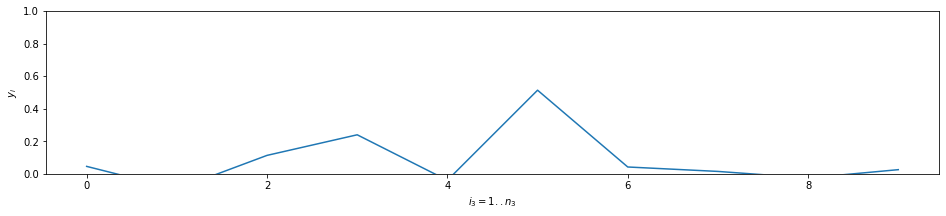

IntDer, Conv {'derivative': 74.601616, 'smoothness': 0.0}
True ans #0 5


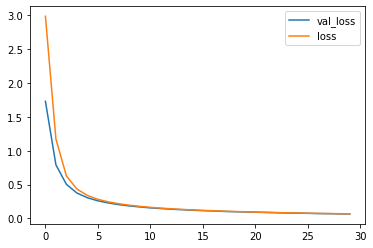

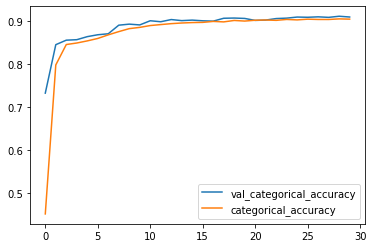

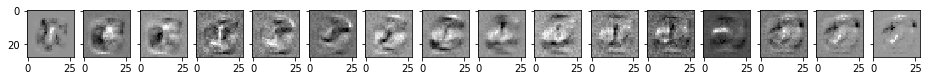

{'val_acc': 0.9102000057697296, 'train_acc': 0.905266664425532, 'val_loss': 0.06719286963343621, 'train_loss': 0.06881703846156598}
Layer 0


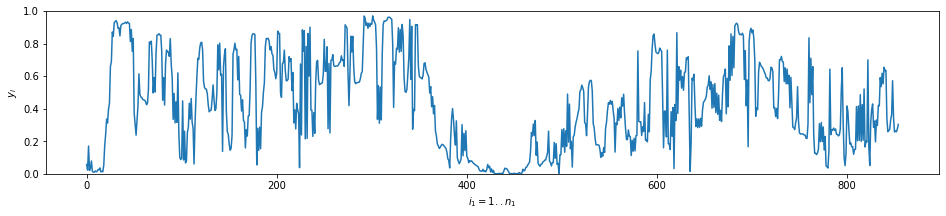

IntDer, Conv {'derivative': 112.41702, 'smoothness': 0.22263578}
Layer 1


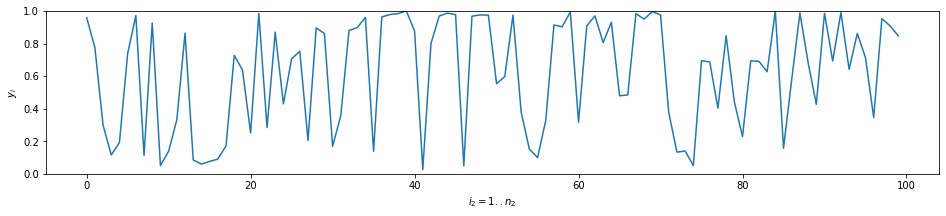

IntDer, Conv {'derivative': 93.62623, 'smoothness': 0.4721431}
Layer 2


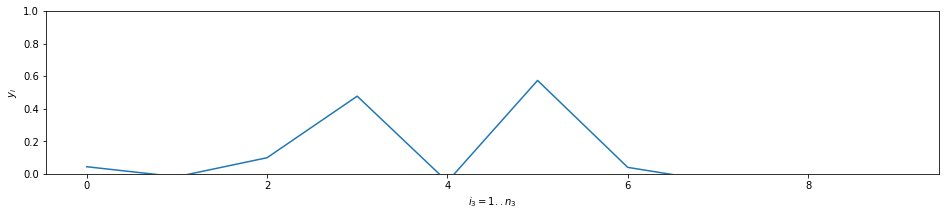

IntDer, Conv {'derivative': 74.07898, 'smoothness': 0.0}
True ans #0 5


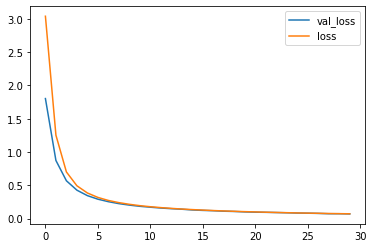

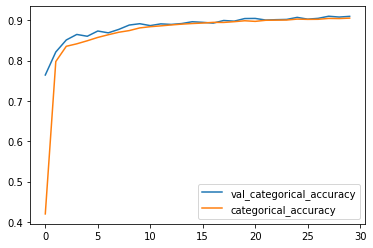

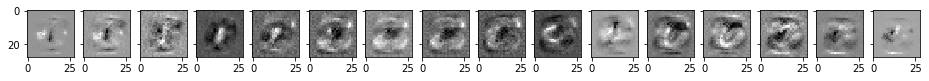

{'val_acc': 0.909500002861023, 'train_acc': 0.9051333357890446, 'val_loss': 0.07024601623415946, 'train_loss': 0.07215850601593653}
Layer 0


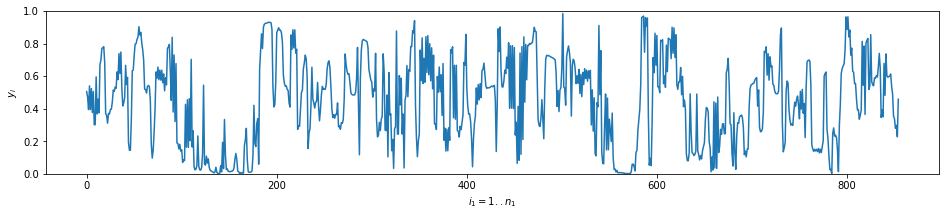

IntDer, Conv {'derivative': 113.16551, 'smoothness': 0.2283302}
Layer 1


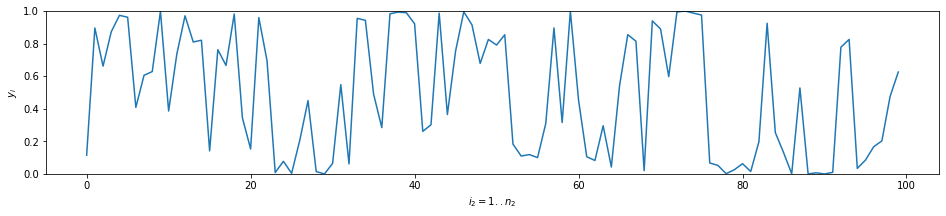

IntDer, Conv {'derivative': 88.05514, 'smoothness': 0.42239842}
Layer 2


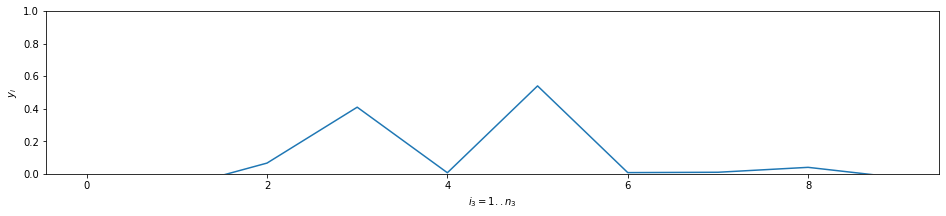

IntDer, Conv {'derivative': 75.06921, 'smoothness': 0.0}
True ans #0 5


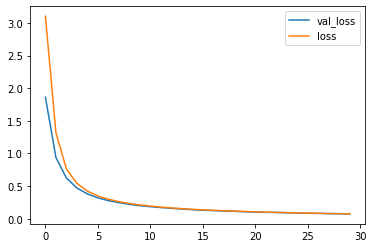

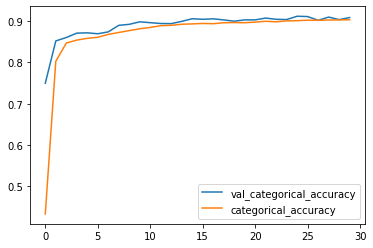

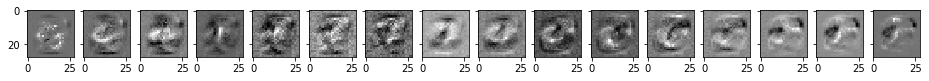

{'val_acc': 0.9087000012397766, 'train_acc': 0.9033333321412405, 'val_loss': 0.07351752370595932, 'train_loss': 0.07481029530366262}
Layer 0


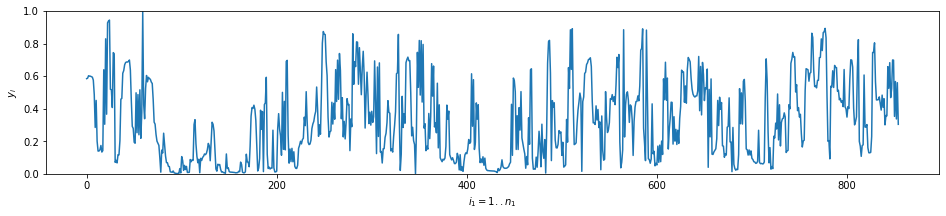

IntDer, Conv {'derivative': 111.81872, 'smoothness': 0.20342462}
Layer 1


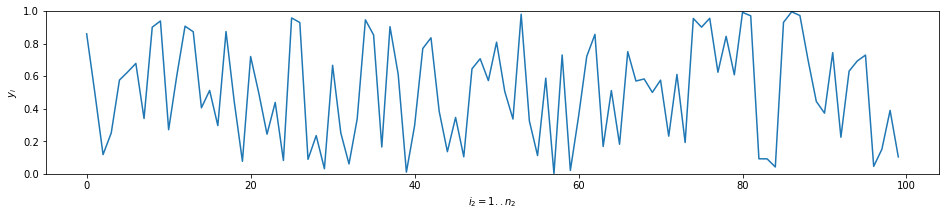

IntDer, Conv {'derivative': 102.124596, 'smoothness': 0.5135622}
Layer 2


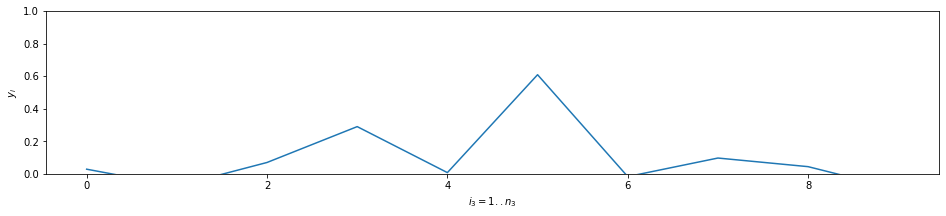

IntDer, Conv {'derivative': 71.9125, 'smoothness': 0.0}
True ans #0 5


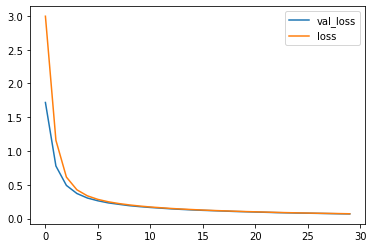

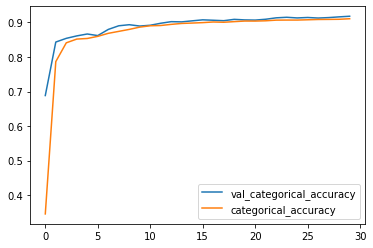

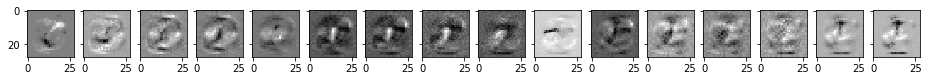

{'val_acc': 0.9180999994277954, 'train_acc': 0.9108666688203811, 'val_loss': 0.0689536478370428, 'train_loss': 0.07110503676036993}
Layer 0


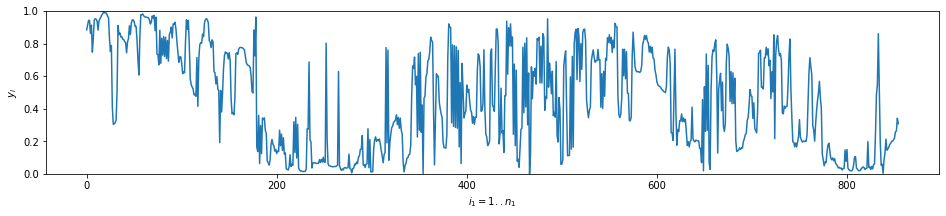

IntDer, Conv {'derivative': 115.71506, 'smoothness': 0.24502462}
Layer 1


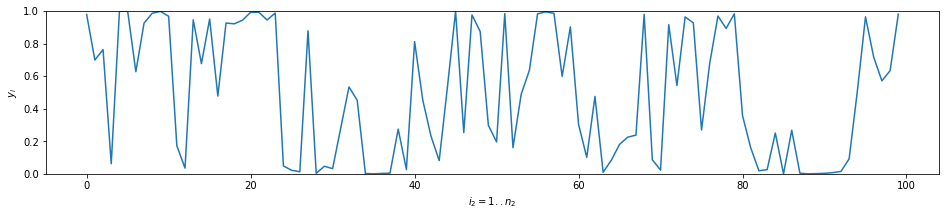

IntDer, Conv {'derivative': 84.22688, 'smoothness': 0.40468073}
Layer 2


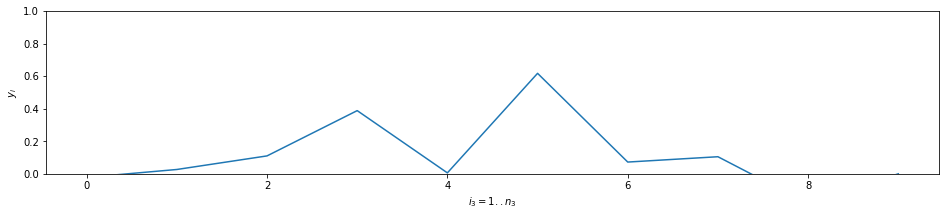

IntDer, Conv {'derivative': 72.903625, 'smoothness': 0.0}
True ans #0 5


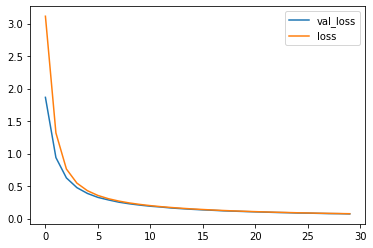

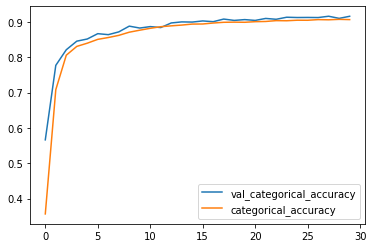

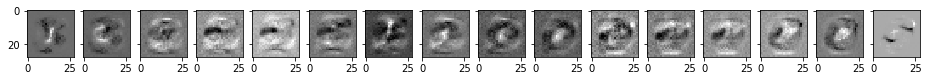

{'val_acc': 0.915800005197525, 'train_acc': 0.9063833306233088, 'val_loss': 0.07242667376995086, 'train_loss': 0.0755165234208107}
Layer 0


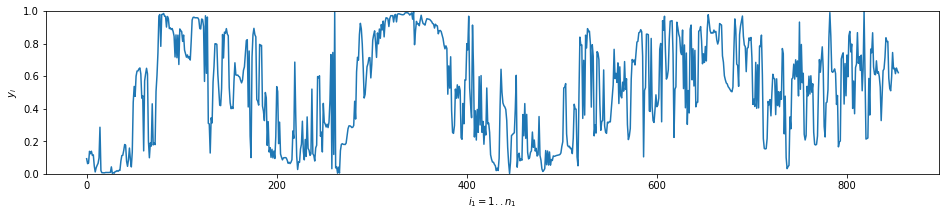

IntDer, Conv {'derivative': 113.553665, 'smoothness': 0.2370522}
Layer 1


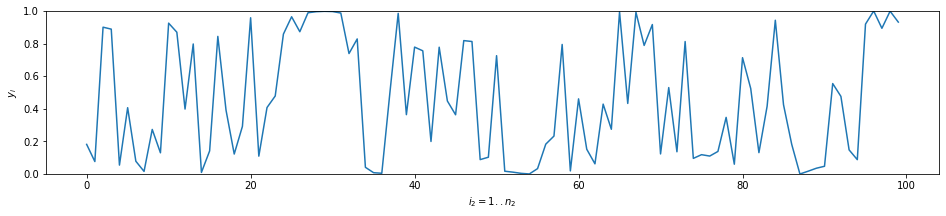

IntDer, Conv {'derivative': 105.3702, 'smoothness': 0.517699}
Layer 2


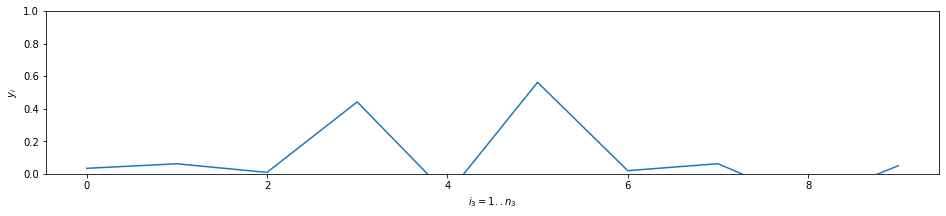

IntDer, Conv {'derivative': 73.24356, 'smoothness': 0.0}
True ans #0 5


 60%|██████    | 6/10 [28:10<20:22, 305.68s/it]

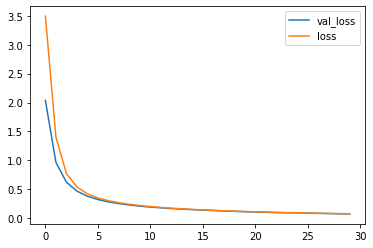

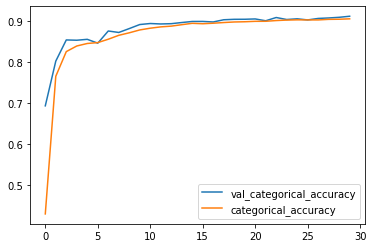

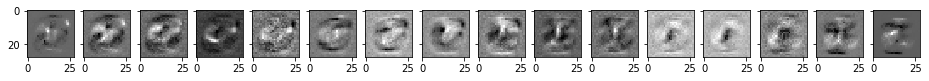

{'val_acc': 0.9128000020980835, 'train_acc': 0.906450002392133, 'val_loss': 0.07392201125621796, 'train_loss': 0.07662945054471493}
Layer 0


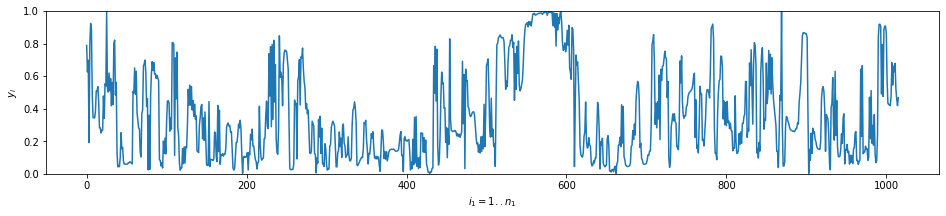

IntDer, Conv {'derivative': 127.46393, 'smoothness': 0.2288198}
Layer 1


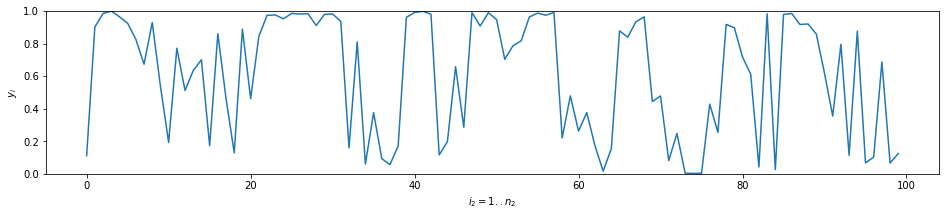

IntDer, Conv {'derivative': 99.65765, 'smoothness': 0.4865288}
Layer 2


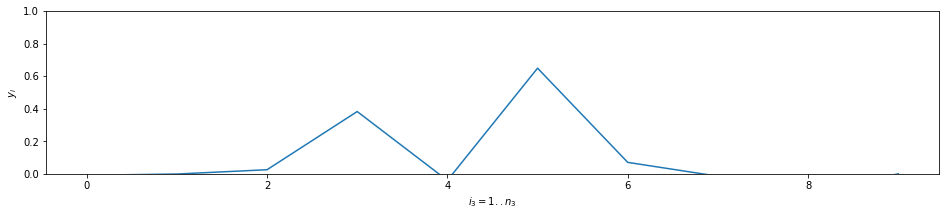

IntDer, Conv {'derivative': 69.70375, 'smoothness': 0.0}
True ans #0 5


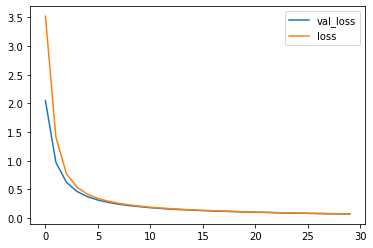

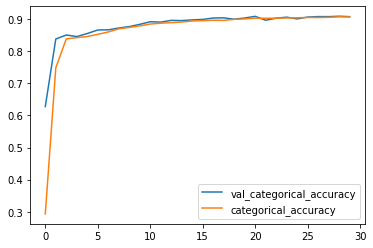

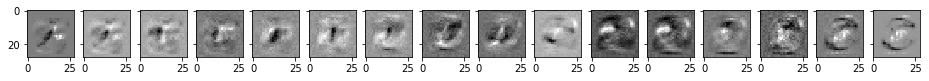

{'val_acc': 0.9082000017166137, 'train_acc': 0.9072666694720586, 'val_loss': 0.07417017966508865, 'train_loss': 0.07414165499309698}
Layer 0


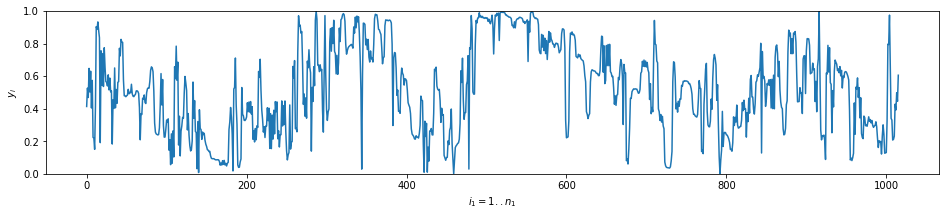

IntDer, Conv {'derivative': 120.940445, 'smoothness': 0.19055547}
Layer 1


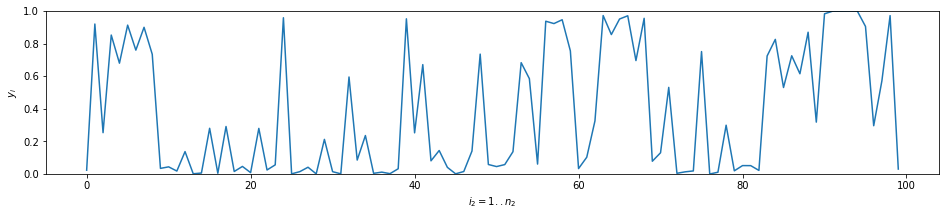

IntDer, Conv {'derivative': 101.456924, 'smoothness': 0.52767324}
Layer 2


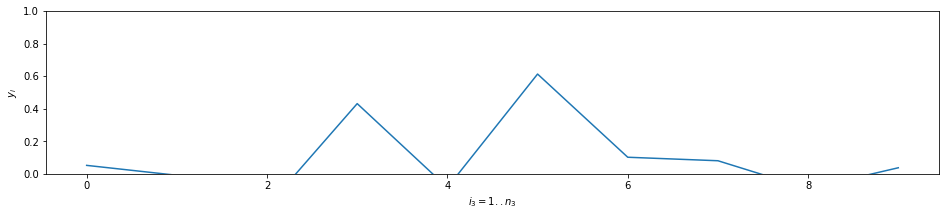

IntDer, Conv {'derivative': 72.21036, 'smoothness': 0.0}
True ans #0 5


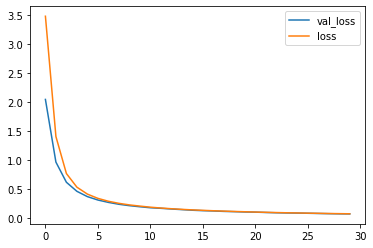

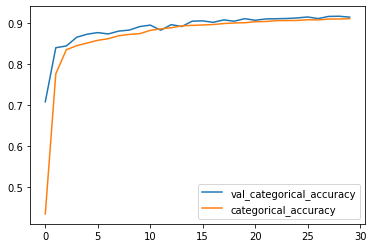

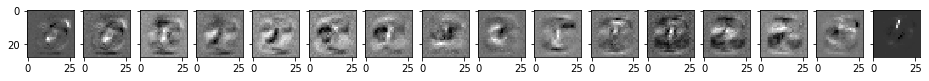

{'val_acc': 0.9142000019550324, 'train_acc': 0.910316667954127, 'val_loss': 0.06923431158065796, 'train_loss': 0.07148048381010691}
Layer 0


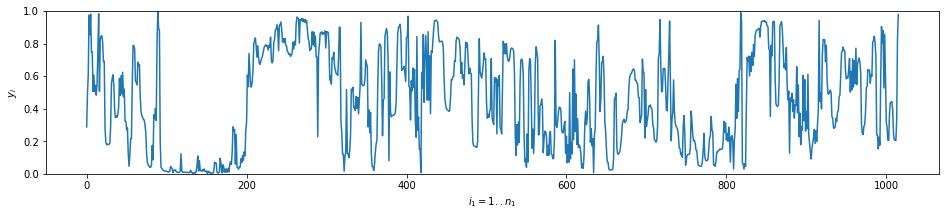

IntDer, Conv {'derivative': 125.013016, 'smoothness': 0.21552335}
Layer 1


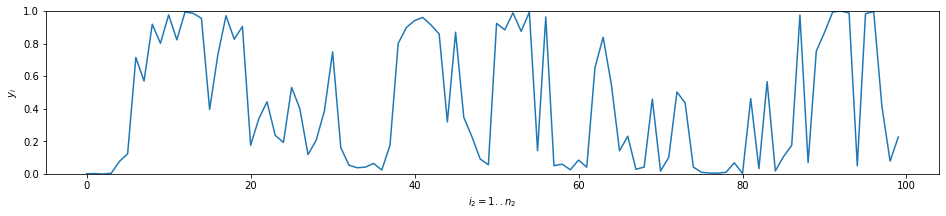

IntDer, Conv {'derivative': 90.44046, 'smoothness': 0.43948972}
Layer 2


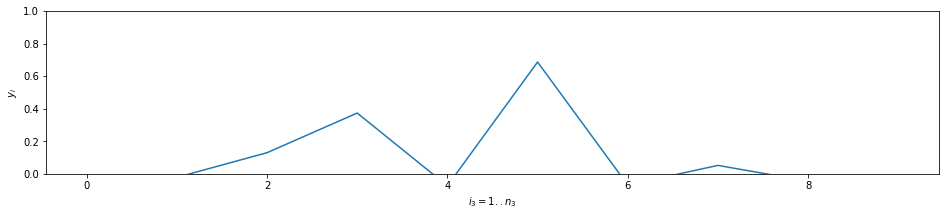

IntDer, Conv {'derivative': 71.101944, 'smoothness': 0.0}
True ans #0 5


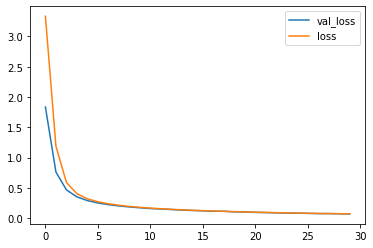

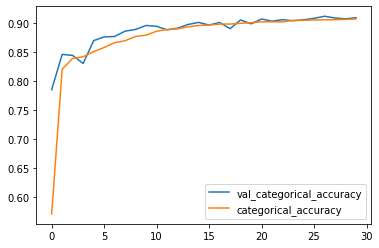

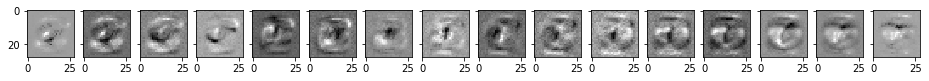

{'val_acc': 0.909799998998642, 'train_acc': 0.9075333366791407, 'val_loss': 0.0684154599905014, 'train_loss': 0.06977573397258917}
Layer 0


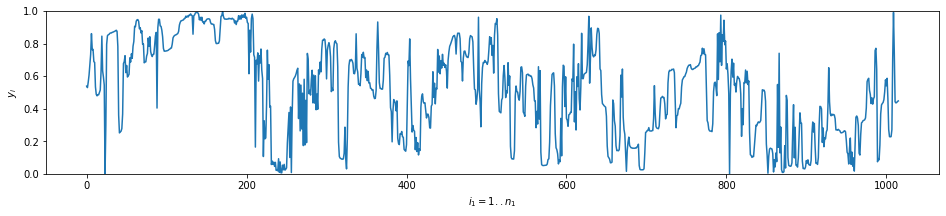

IntDer, Conv {'derivative': 123.57277, 'smoothness': 0.20871446}
Layer 1


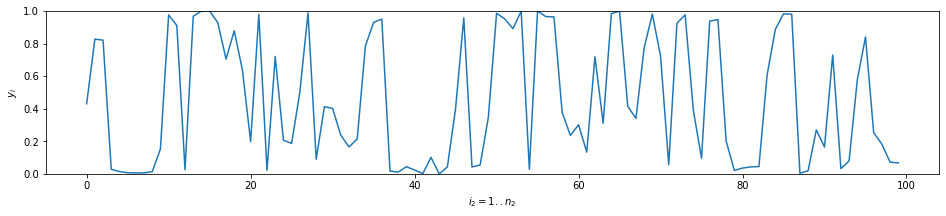

IntDer, Conv {'derivative': 85.00864, 'smoothness': 0.42332578}
Layer 2


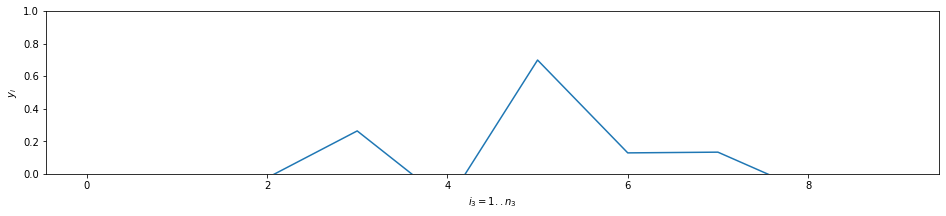

IntDer, Conv {'derivative': 71.78683, 'smoothness': 0.0}
True ans #0 5


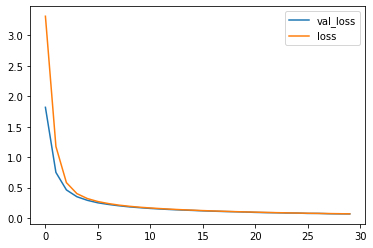

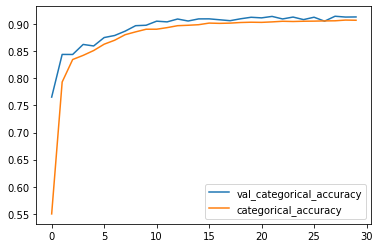

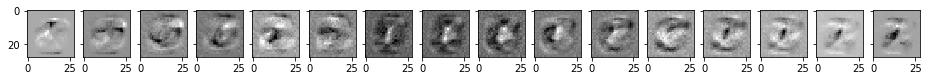

{'val_acc': 0.913100004196167, 'train_acc': 0.9069999982913335, 'val_loss': 0.06797025352716446, 'train_loss': 0.06939718735714753}
Layer 0


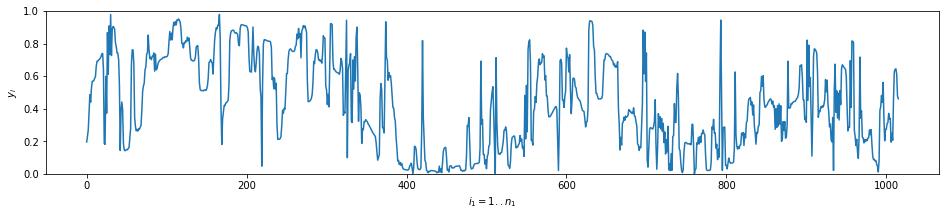

IntDer, Conv {'derivative': 127.33019, 'smoothness': 0.21652175}
Layer 1


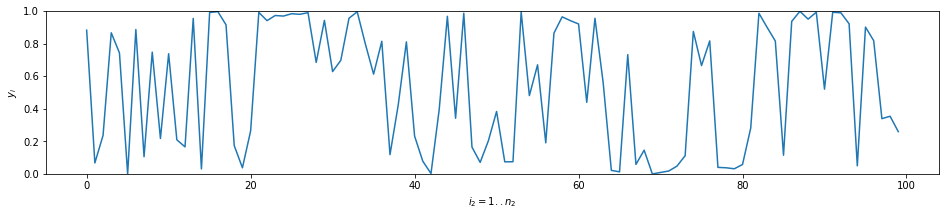

IntDer, Conv {'derivative': 78.456184, 'smoothness': 0.39200643}
Layer 2


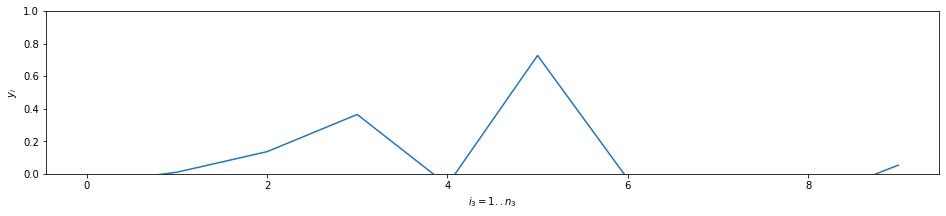

IntDer, Conv {'derivative': 70.44183, 'smoothness': 0.0}
True ans #0 5


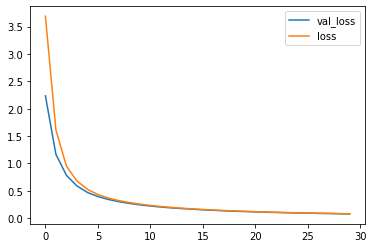

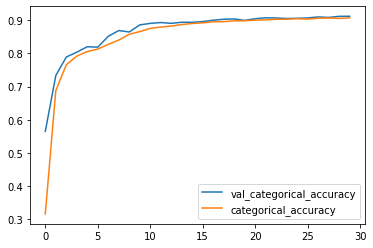

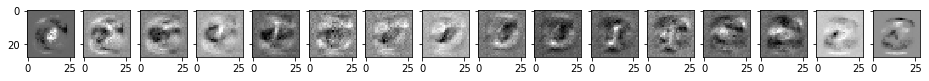

{'val_acc': 0.911899995803833, 'train_acc': 0.9067833344141643, 'val_loss': 0.07887474447488785, 'train_loss': 0.08148968778550625}
Layer 0


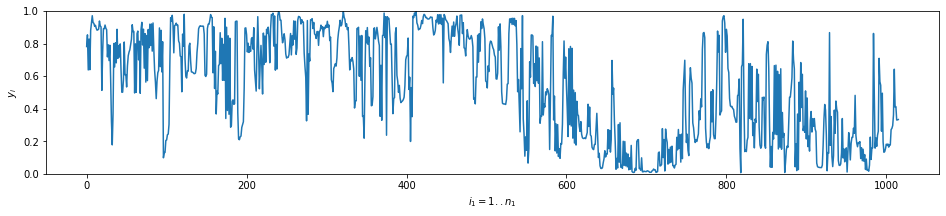

IntDer, Conv {'derivative': 122.78334, 'smoothness': 0.22306791}
Layer 1


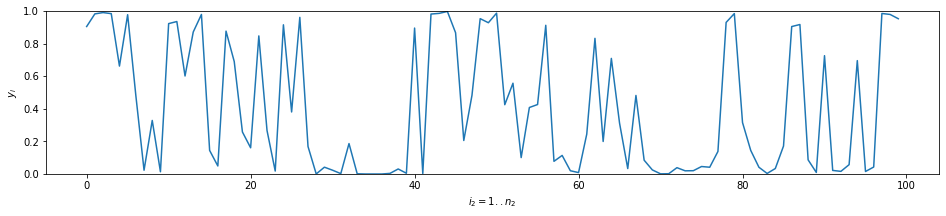

IntDer, Conv {'derivative': 122.945175, 'smoothness': 0.6171044}
Layer 2


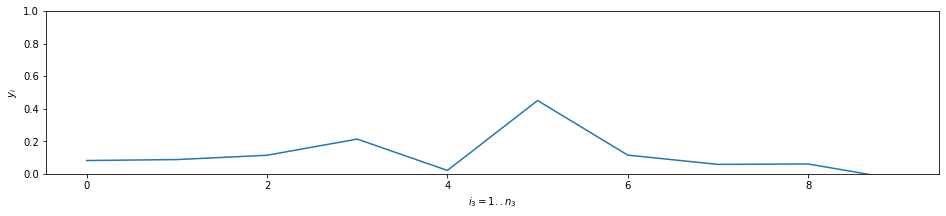

IntDer, Conv {'derivative': 73.62657, 'smoothness': 0.0}
True ans #0 5


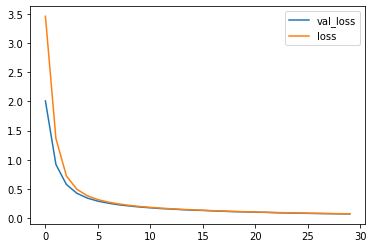

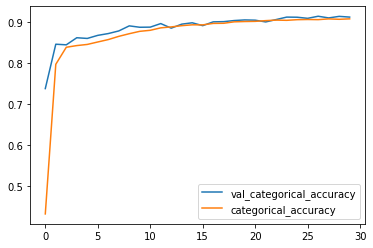

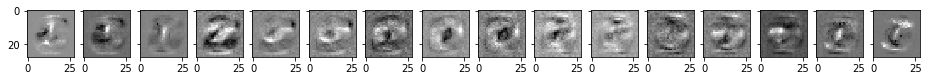

{'val_acc': 0.9130999982357025, 'train_acc': 0.9088333308696747, 'val_loss': 0.0703354187309742, 'train_loss': 0.0721418688694636}
Layer 0


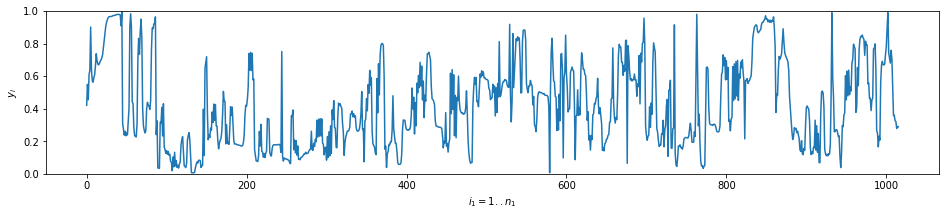

IntDer, Conv {'derivative': 123.77107, 'smoothness': 0.21497391}
Layer 1


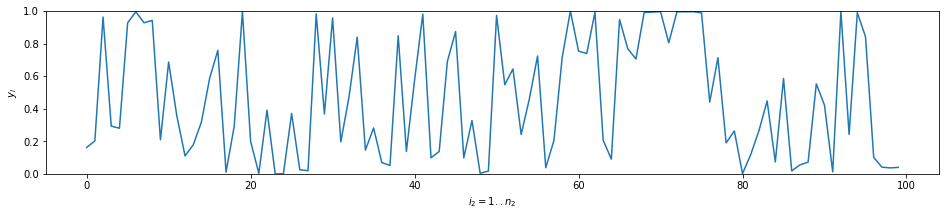

IntDer, Conv {'derivative': 89.548515, 'smoothness': 0.4328761}
Layer 2


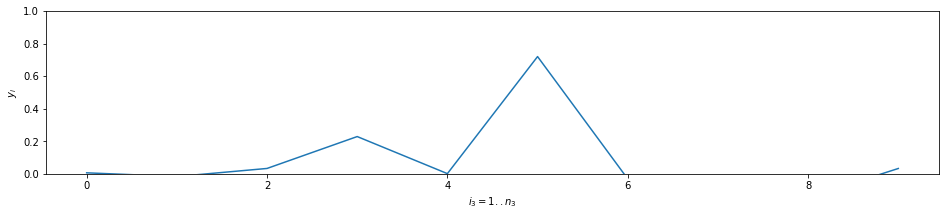

IntDer, Conv {'derivative': 70.69132, 'smoothness': 0.0}
True ans #0 5


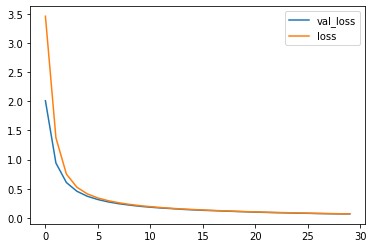

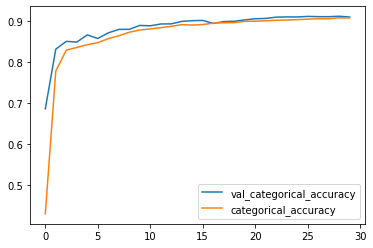

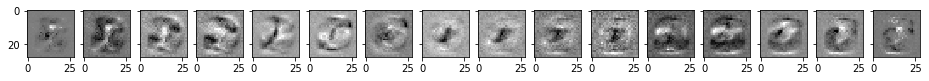

{'val_acc': 0.9093999922275543, 'train_acc': 0.9068833341201147, 'val_loss': 0.06979346126317978, 'train_loss': 0.07016270471115907}
Layer 0


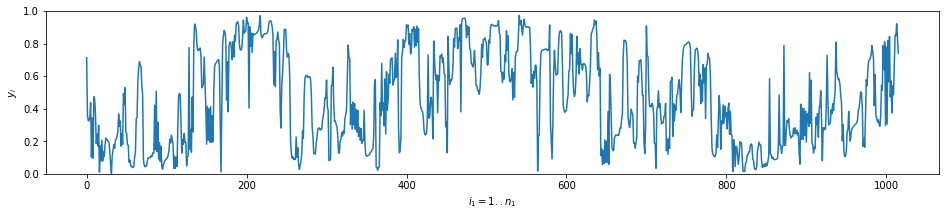

IntDer, Conv {'derivative': 122.81336, 'smoothness': 0.1990623}
Layer 1


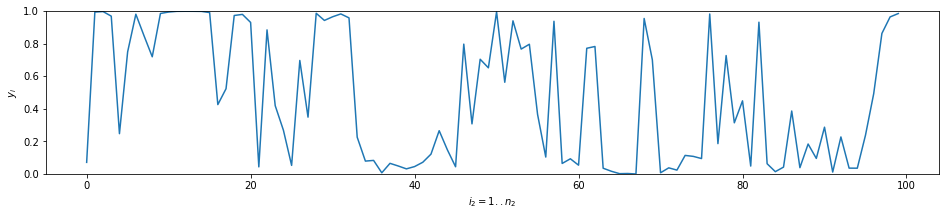

IntDer, Conv {'derivative': 87.84878, 'smoothness': 0.42154974}
Layer 2


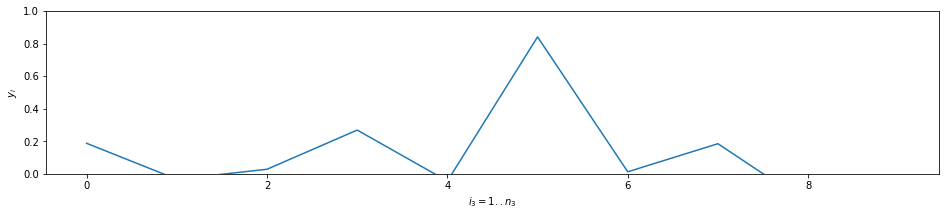

IntDer, Conv {'derivative': 78.77537, 'smoothness': 0.0}
True ans #0 5


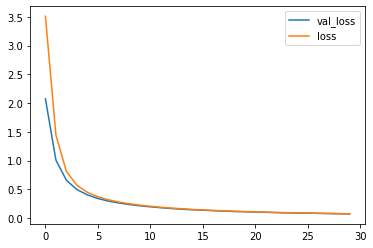

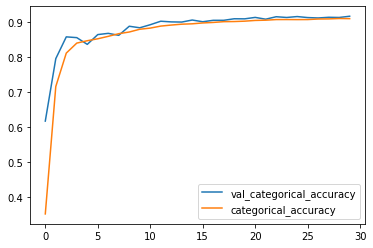

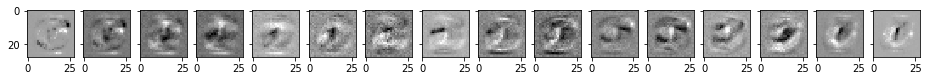

{'val_acc': 0.916700005531311, 'train_acc': 0.9098333309094111, 'val_loss': 0.07343095019459725, 'train_loss': 0.07594209077457587}
Layer 0


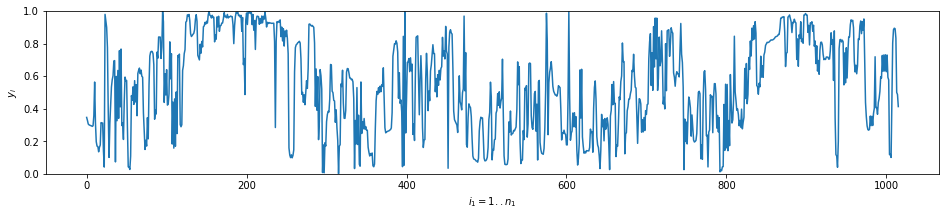

IntDer, Conv {'derivative': 121.83573, 'smoothness': 0.20417538}
Layer 1


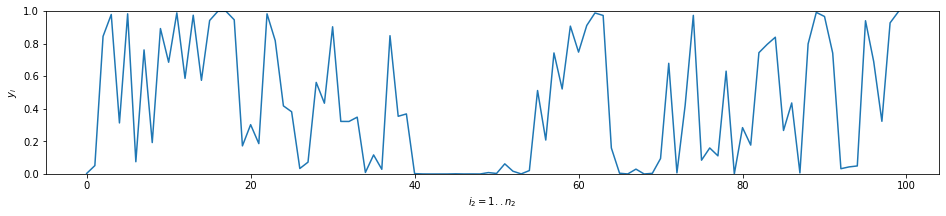

IntDer, Conv {'derivative': 96.736465, 'smoothness': 0.47559208}
Layer 2


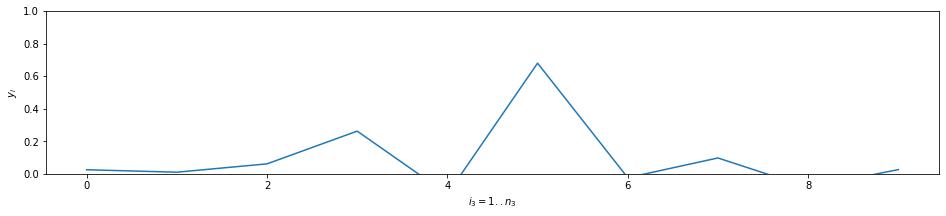

IntDer, Conv {'derivative': 72.89899, 'smoothness': 0.0}
True ans #0 5


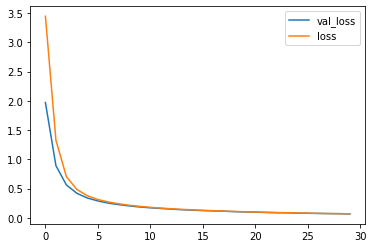

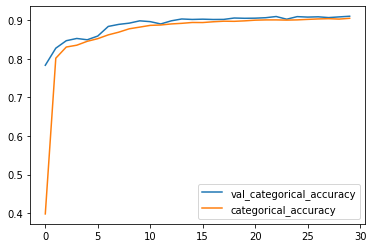

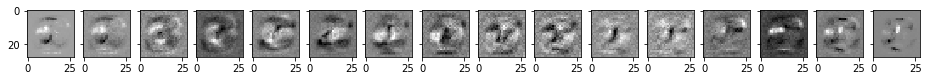

{'val_acc': 0.9105000019073486, 'train_acc': 0.9051499982674917, 'val_loss': 0.06795796528458595, 'train_loss': 0.06965239656468232}
Layer 0


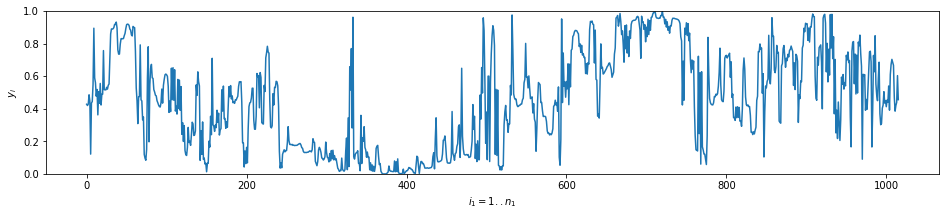

IntDer, Conv {'derivative': 126.25754, 'smoothness': 0.21235347}
Layer 1


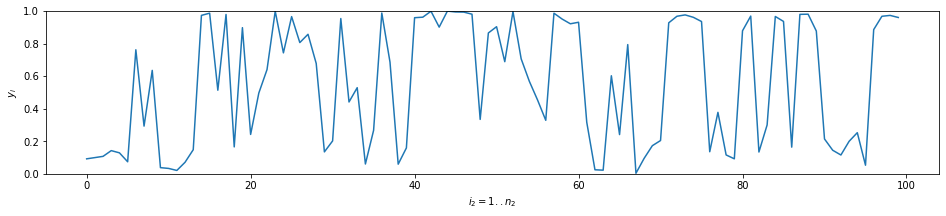

IntDer, Conv {'derivative': 84.886765, 'smoothness': 0.40792748}
Layer 2


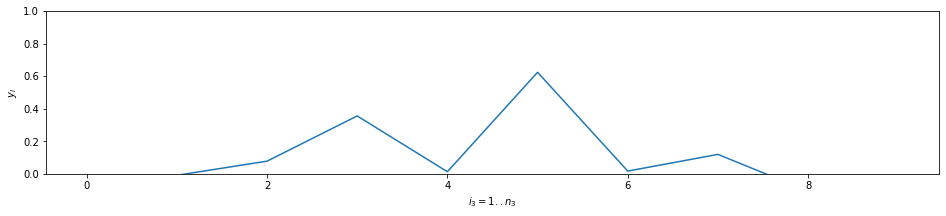

IntDer, Conv {'derivative': 70.76393, 'smoothness': 0.0}
True ans #0 5


 70%|███████   | 7/10 [35:31<17:18, 346.05s/it]

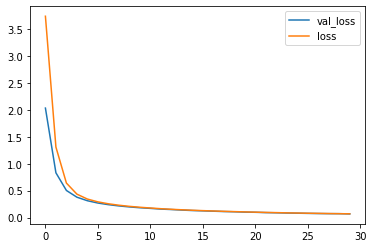

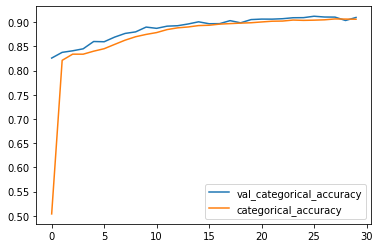

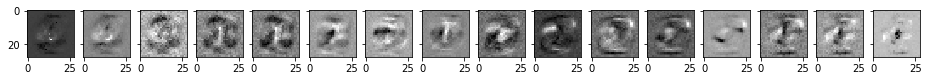

{'val_acc': 0.9096999943256379, 'train_acc': 0.90601666867733, 'val_loss': 0.0686513300985098, 'train_loss': 0.07085659988224506}
Layer 0


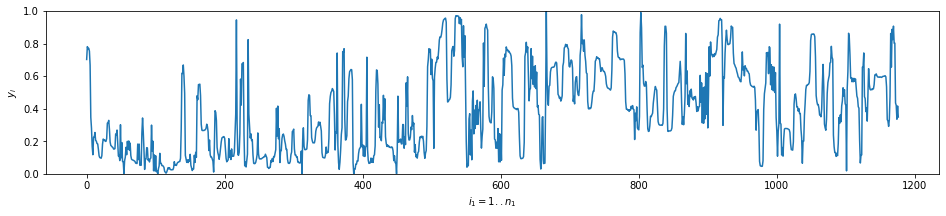

IntDer, Conv {'derivative': 135.76851, 'smoothness': 0.2150349}
Layer 1


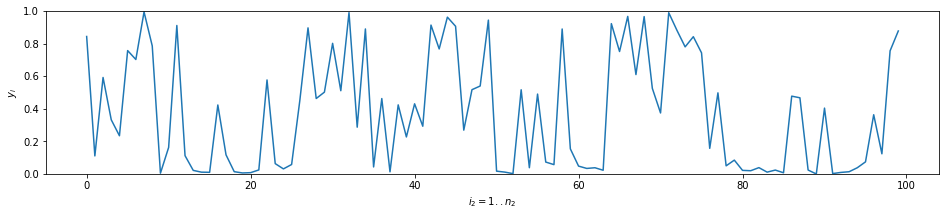

IntDer, Conv {'derivative': 79.66469, 'smoothness': 0.38696215}
Layer 2


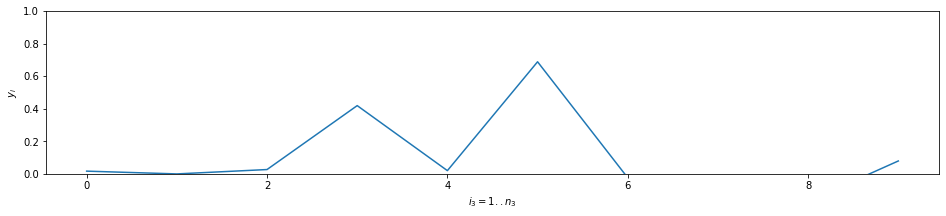

IntDer, Conv {'derivative': 69.7686, 'smoothness': 0.0}
True ans #0 5


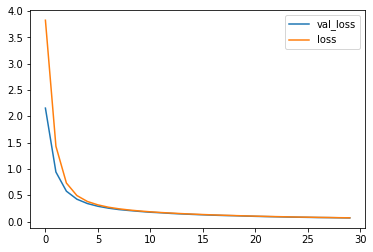

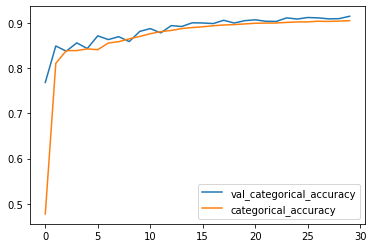

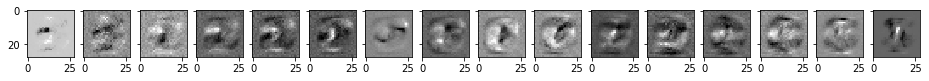

{'val_acc': 0.9148000061511994, 'train_acc': 0.9050000011920929, 'val_loss': 0.06994750201702118, 'train_loss': 0.07201730484763781}
Layer 0


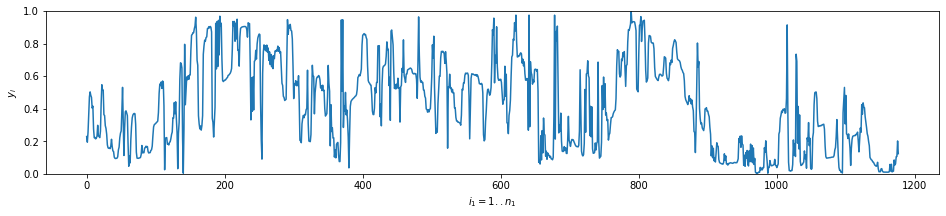

IntDer, Conv {'derivative': 138.06223, 'smoothness': 0.22267213}
Layer 1


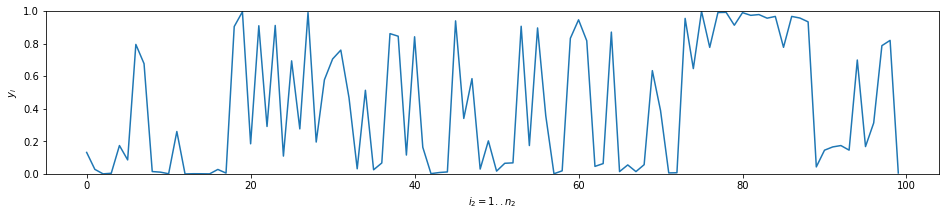

IntDer, Conv {'derivative': 81.922165, 'smoothness': 0.37951073}
Layer 2


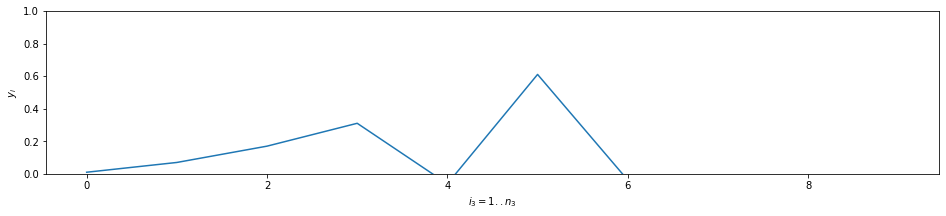

IntDer, Conv {'derivative': 72.53723, 'smoothness': 0.0}
True ans #0 5


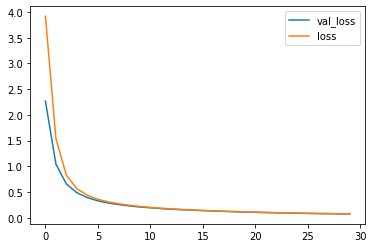

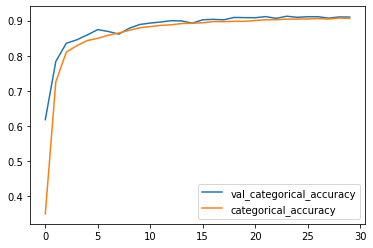

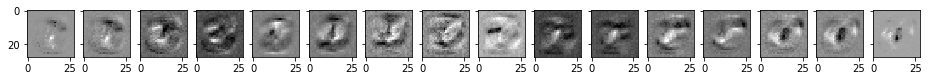

{'val_acc': 0.9101000010967255, 'train_acc': 0.9062166680892308, 'val_loss': 0.07409824803471565, 'train_loss': 0.07473888707657655}
Layer 0


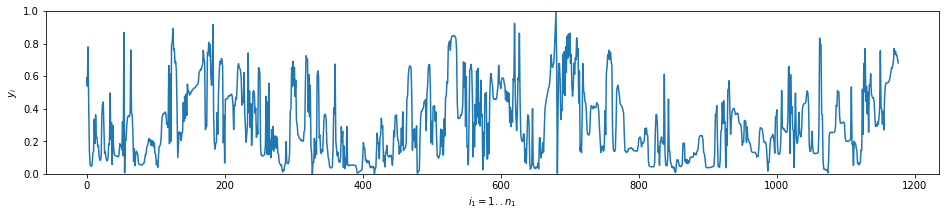

IntDer, Conv {'derivative': 131.38618, 'smoothness': 0.18772613}
Layer 1


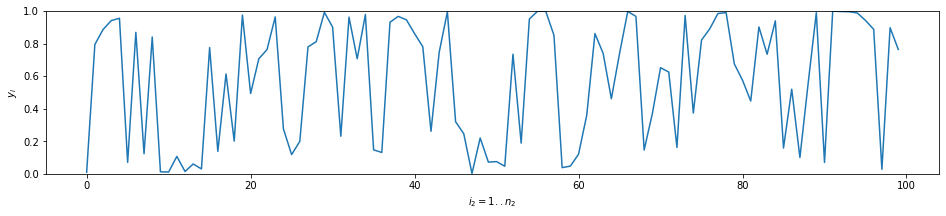

IntDer, Conv {'derivative': 102.58003, 'smoothness': 0.53269386}
Layer 2


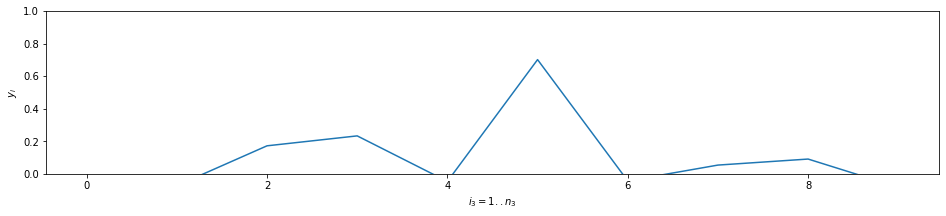

IntDer, Conv {'derivative': 71.75209, 'smoothness': 0.0}
True ans #0 5


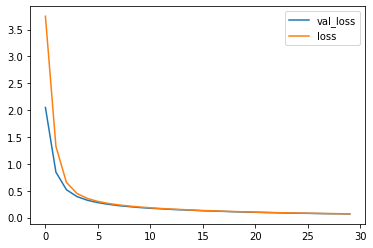

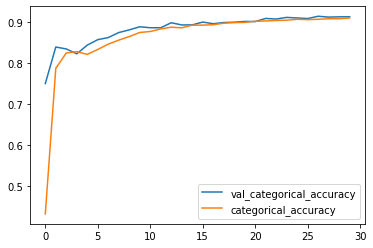

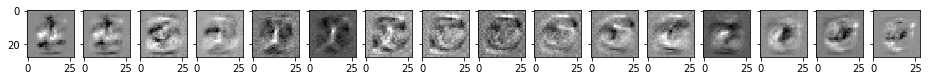

{'val_acc': 0.9124000012874603, 'train_acc': 0.9093666682640712, 'val_loss': 0.06704251356422901, 'train_loss': 0.06886451231936613}
Layer 0


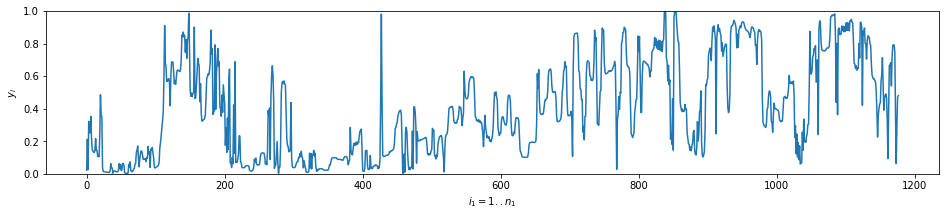

IntDer, Conv {'derivative': 135.71584, 'smoothness': 0.20264411}
Layer 1


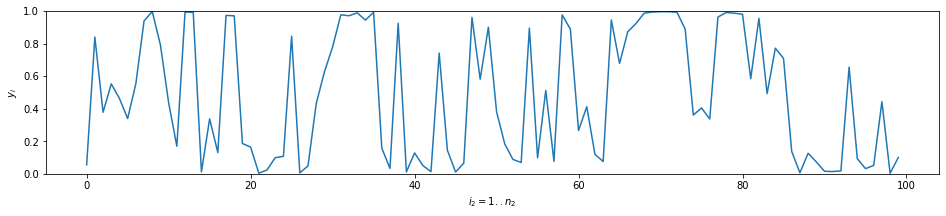

IntDer, Conv {'derivative': 76.27785, 'smoothness': 0.36588436}
Layer 2


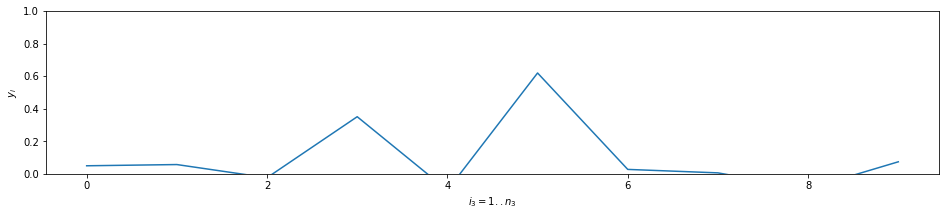

IntDer, Conv {'derivative': 69.42262, 'smoothness': 0.0}
True ans #0 5


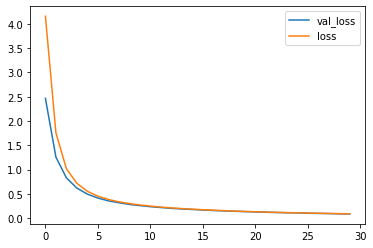

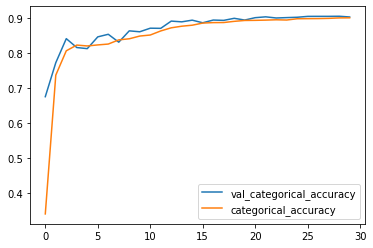

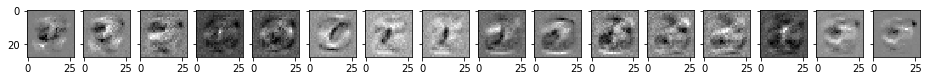

{'val_acc': 0.9040000081062317, 'train_acc': 0.9016166637341182, 'val_loss': 0.08610947132110595, 'train_loss': 0.08821696490049362}
Layer 0


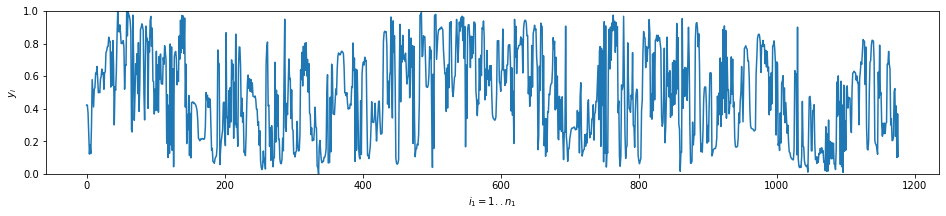

IntDer, Conv {'derivative': 142.51038, 'smoothness': 0.22521141}
Layer 1


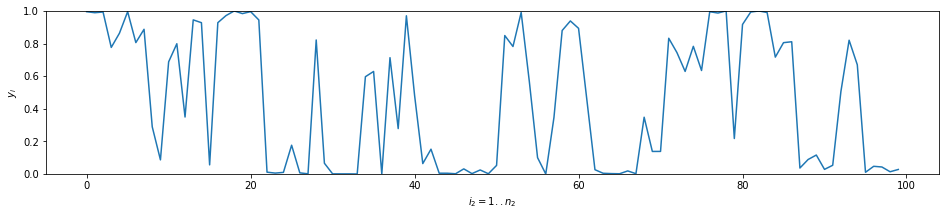

IntDer, Conv {'derivative': 112.19189, 'smoothness': 0.54366195}
Layer 2


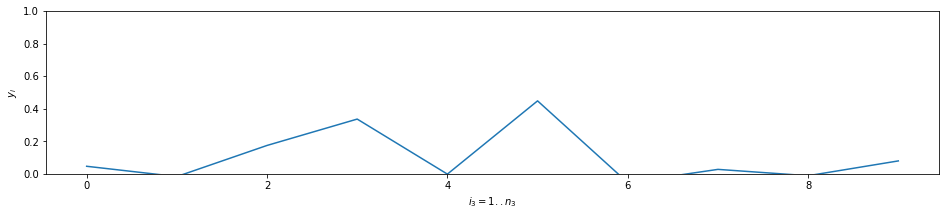

IntDer, Conv {'derivative': 73.122345, 'smoothness': 0.0}
True ans #0 5


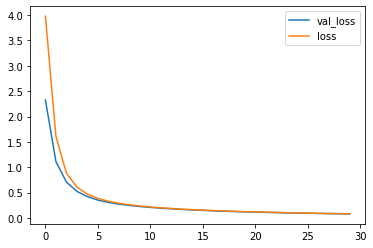

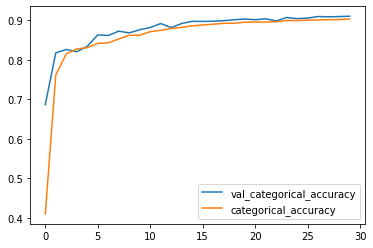

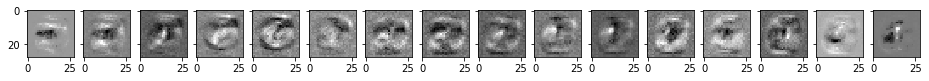

{'val_acc': 0.91010000705719, 'train_acc': 0.9031500001748403, 'val_loss': 0.08108315095305443, 'train_loss': 0.08335566284755866}
Layer 0


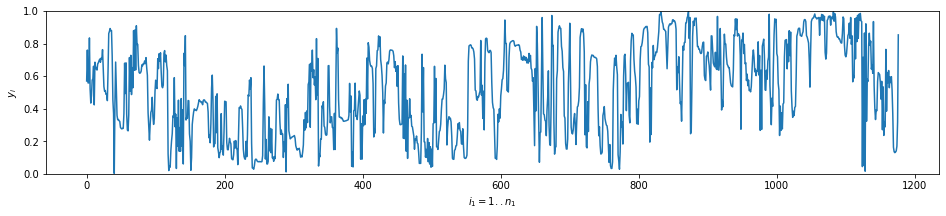

IntDer, Conv {'derivative': 138.13365, 'smoothness': 0.22905374}
Layer 1


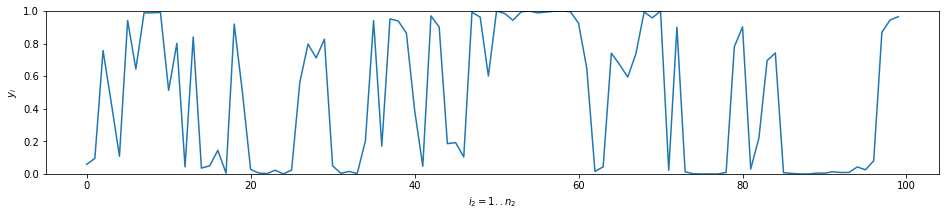

IntDer, Conv {'derivative': 117.77994, 'smoothness': 0.60594535}
Layer 2


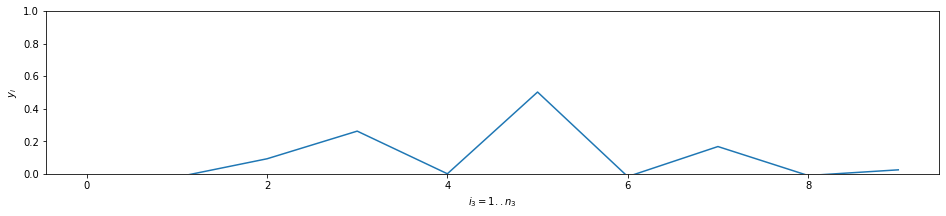

IntDer, Conv {'derivative': 67.29598, 'smoothness': 0.0}
True ans #0 5


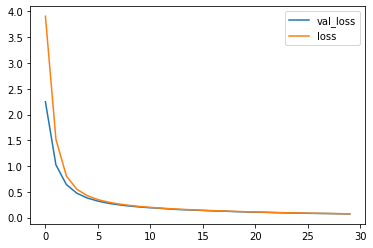

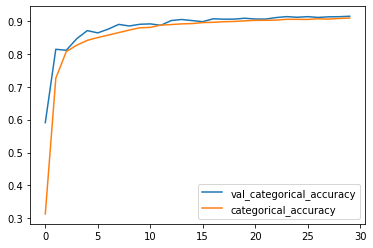

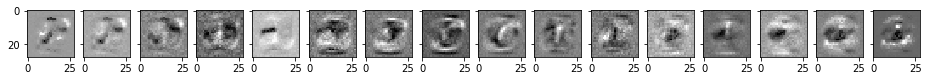

{'val_acc': 0.9143999993801117, 'train_acc': 0.9087999989589055, 'val_loss': 0.07258257120847703, 'train_loss': 0.07517466880381107}
Layer 0


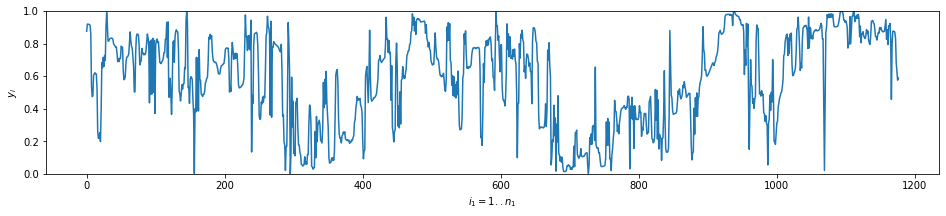

IntDer, Conv {'derivative': 131.29282, 'smoothness': 0.18548577}
Layer 1


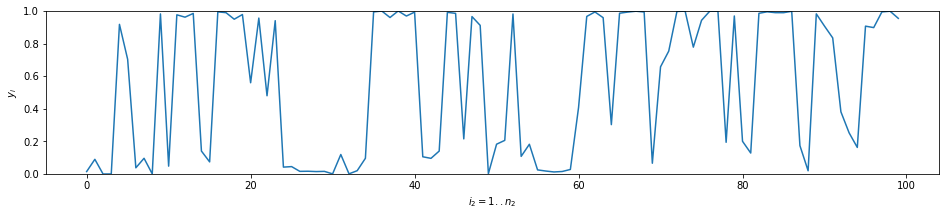

IntDer, Conv {'derivative': 92.06649, 'smoothness': 0.44606808}
Layer 2


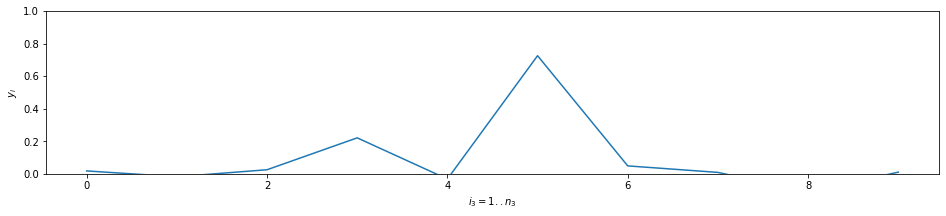

IntDer, Conv {'derivative': 69.1421, 'smoothness': 0.0}
True ans #0 5


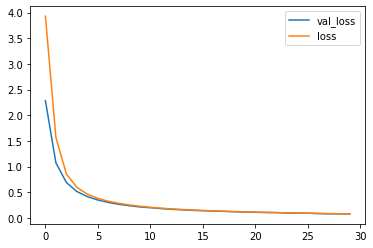

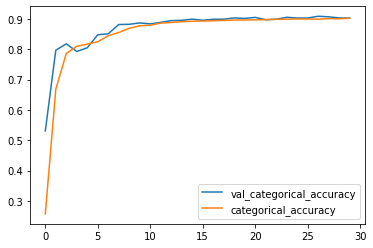

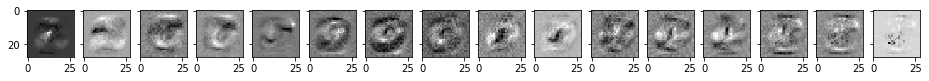

{'val_acc': 0.9030999958515167, 'train_acc': 0.9023499965667725, 'val_loss': 0.07642050310969353, 'train_loss': 0.07780691037575403}
Layer 0


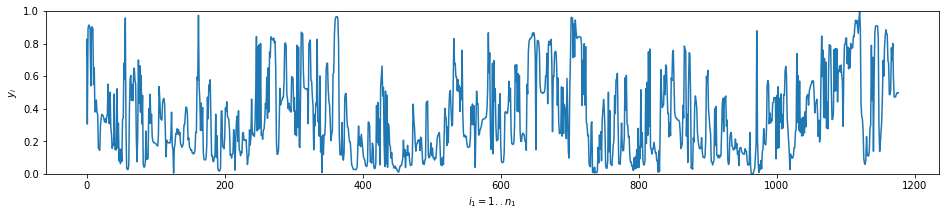

IntDer, Conv {'derivative': 142.66641, 'smoothness': 0.24341983}
Layer 1


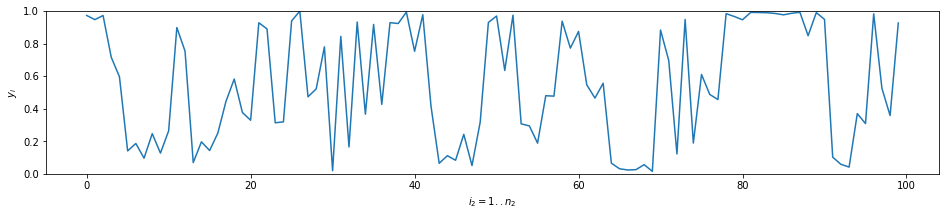

IntDer, Conv {'derivative': 94.02208, 'smoothness': 0.46312124}
Layer 2


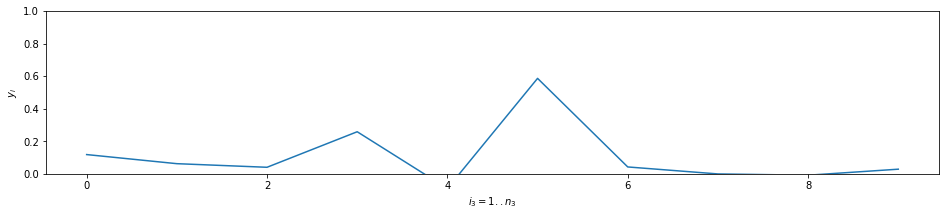

IntDer, Conv {'derivative': 73.69736, 'smoothness': 0.0}
True ans #0 5


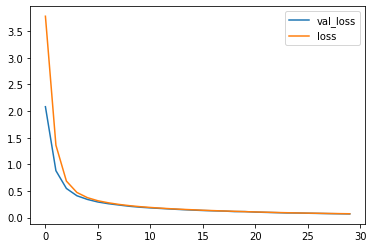

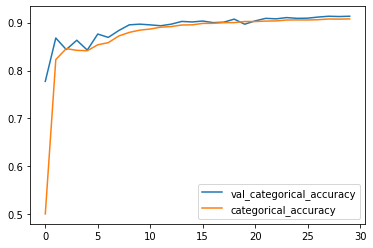

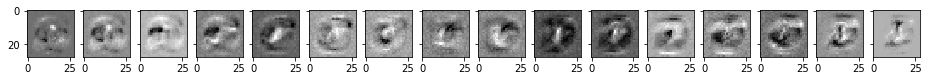

{'val_acc': 0.9130999982357025, 'train_acc': 0.90753333568573, 'val_loss': 0.07004600763320923, 'train_loss': 0.0729929598669211}
Layer 0


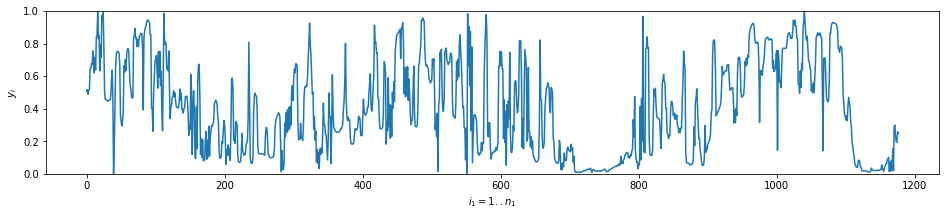

IntDer, Conv {'derivative': 134.91797, 'smoothness': 0.19569626}
Layer 1


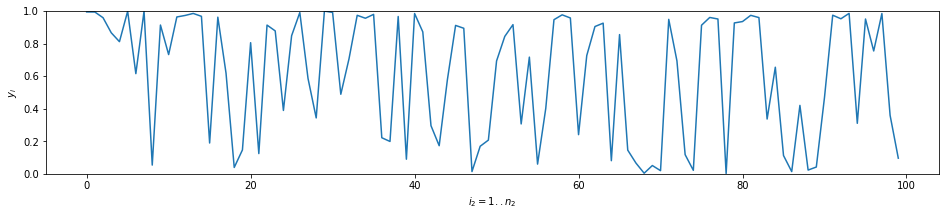

IntDer, Conv {'derivative': 85.152664, 'smoothness': 0.4124828}
Layer 2


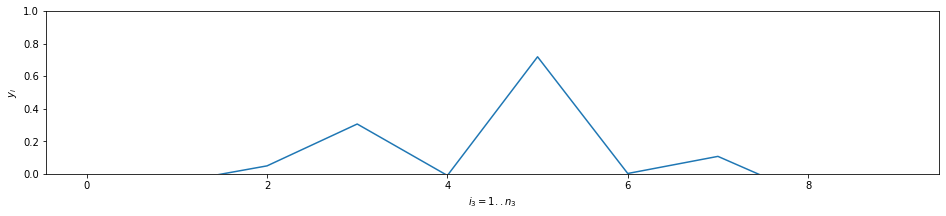

IntDer, Conv {'derivative': 73.3129, 'smoothness': 0.0}
True ans #0 5


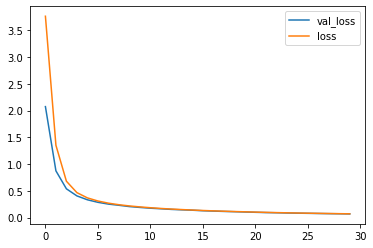

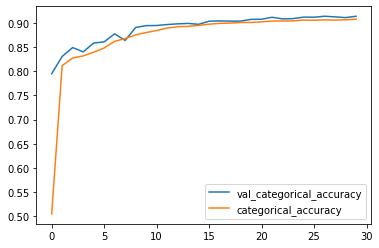

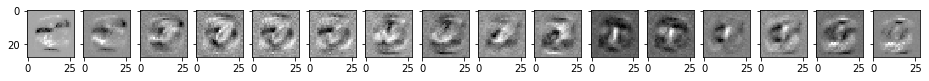

{'val_acc': 0.9134999990463257, 'train_acc': 0.9077000041802724, 'val_loss': 0.06908104866743088, 'train_loss': 0.07103516794741153}
Layer 0


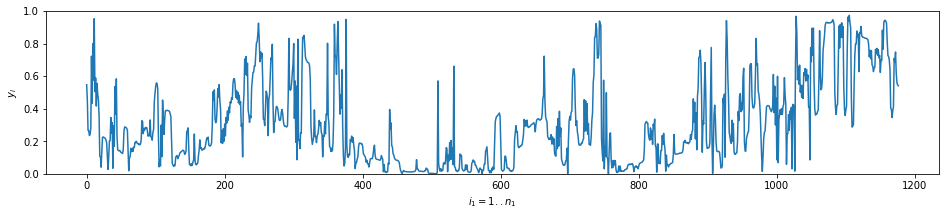

IntDer, Conv {'derivative': 136.342, 'smoothness': 0.21785718}
Layer 1


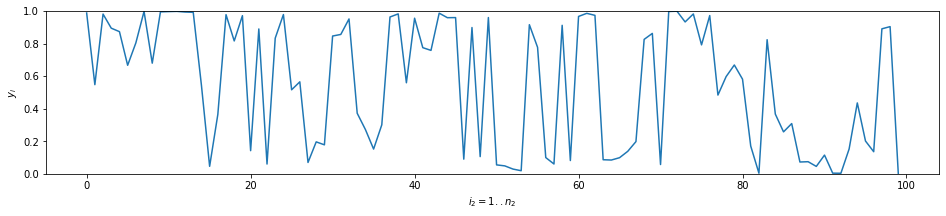

IntDer, Conv {'derivative': 76.014145, 'smoothness': 0.35879284}
Layer 2


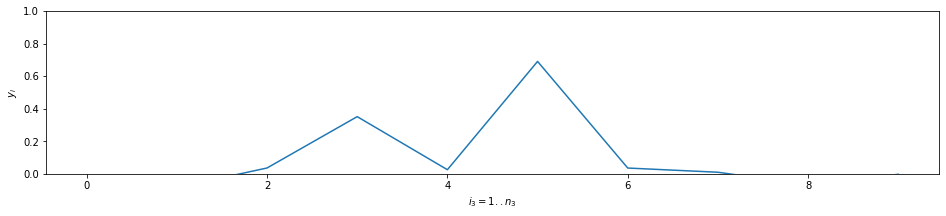

IntDer, Conv {'derivative': 70.38032, 'smoothness': 0.0}
True ans #0 5


 80%|████████  | 8/10 [43:46<13:01, 390.74s/it]

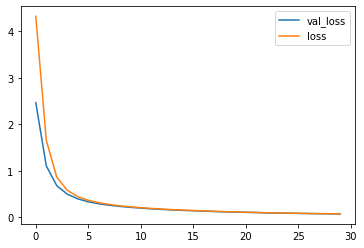

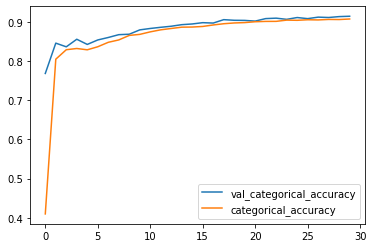

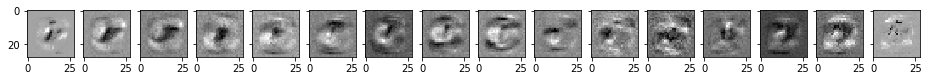

{'val_acc': 0.9142999947071075, 'train_acc': 0.9072833329439163, 'val_loss': 0.07308453992009163, 'train_loss': 0.07413835686941941}
Layer 0


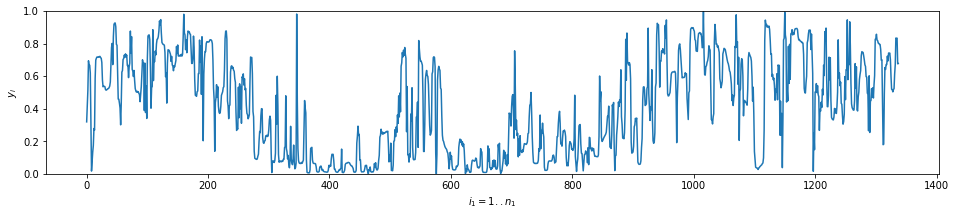

IntDer, Conv {'derivative': 146.35477, 'smoothness': 0.1960999}
Layer 1


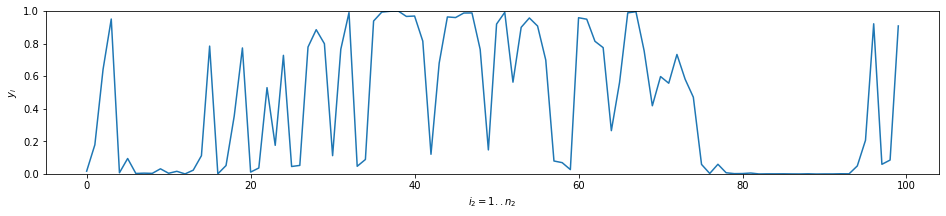

IntDer, Conv {'derivative': 88.937904, 'smoothness': 0.42706266}
Layer 2


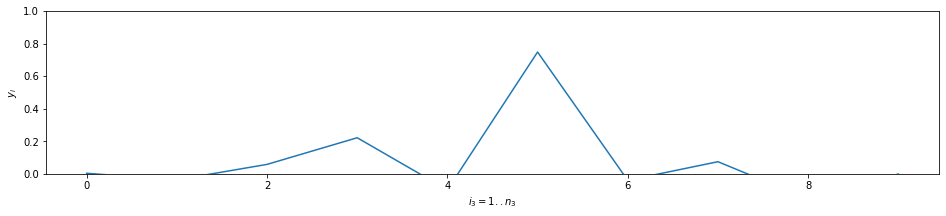

IntDer, Conv {'derivative': 70.06351, 'smoothness': 0.0}
True ans #0 5


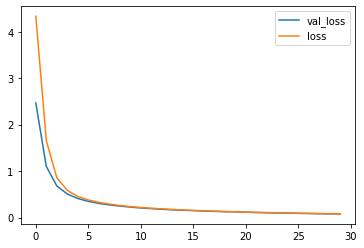

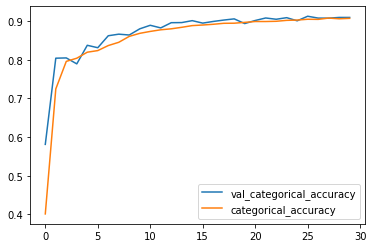

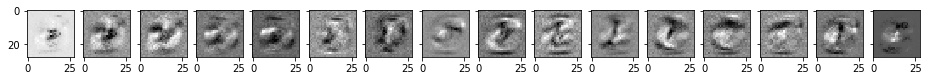

{'val_acc': 0.9097999930381775, 'train_acc': 0.9074499954779943, 'val_loss': 0.07743286639451981, 'train_loss': 0.07830991533895333}
Layer 0


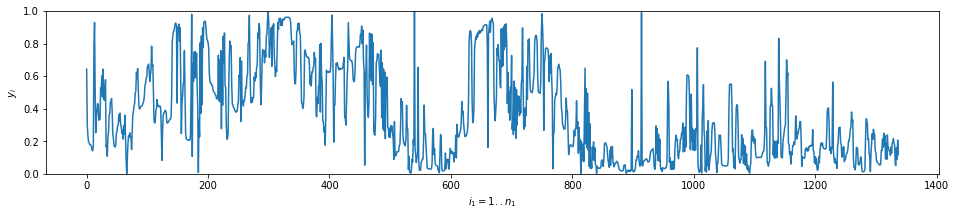

IntDer, Conv {'derivative': 149.04776, 'smoothness': 0.21736927}
Layer 1


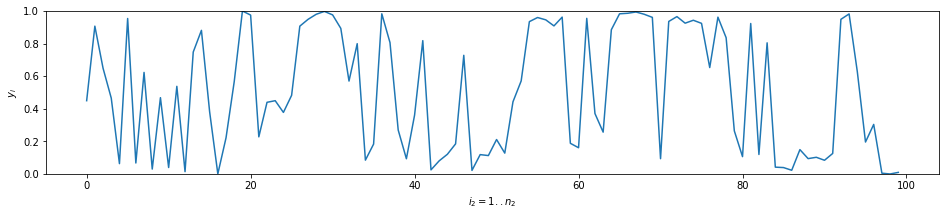

IntDer, Conv {'derivative': 91.33222, 'smoothness': 0.4593753}
Layer 2


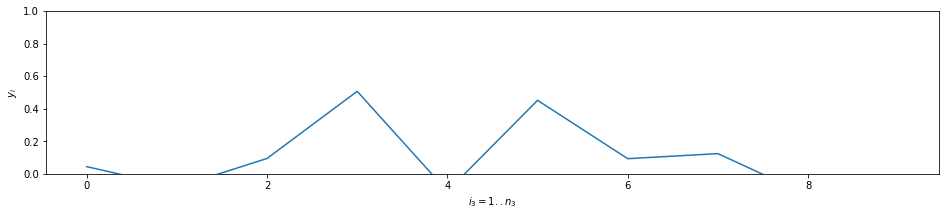

IntDer, Conv {'derivative': 70.138145, 'smoothness': 0.0}
True ans #0 5


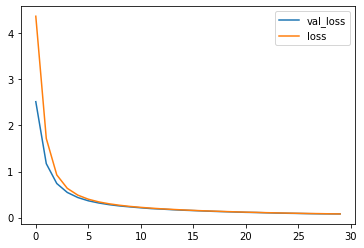

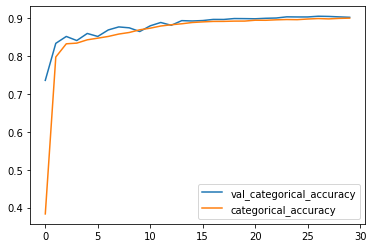

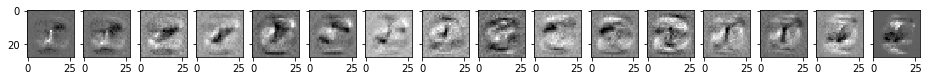

{'val_acc': 0.902700012922287, 'train_acc': 0.9004833330710729, 'val_loss': 0.08029587045311928, 'train_loss': 0.08023284251491229}
Layer 0


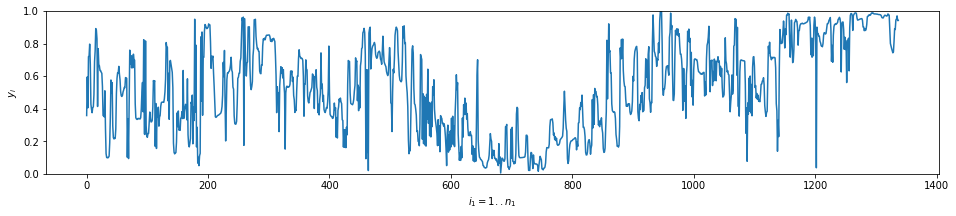

IntDer, Conv {'derivative': 144.58438, 'smoothness': 0.18535487}
Layer 1


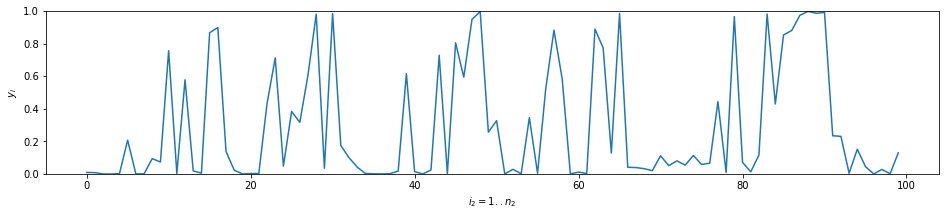

IntDer, Conv {'derivative': 102.71743, 'smoothness': 0.50387657}
Layer 2


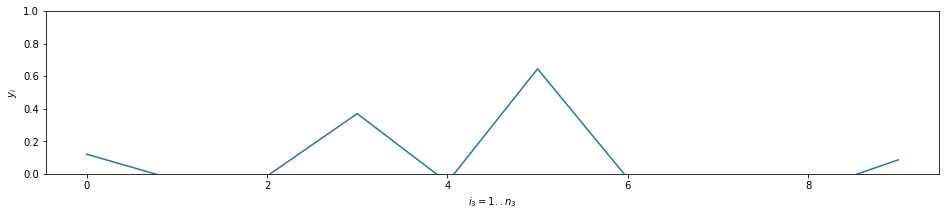

IntDer, Conv {'derivative': 73.735306, 'smoothness': 0.0}
True ans #0 5


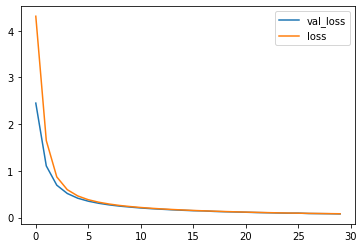

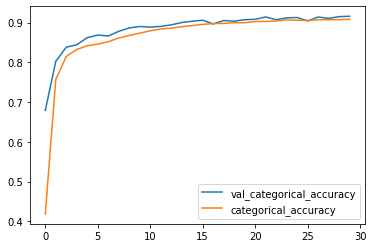

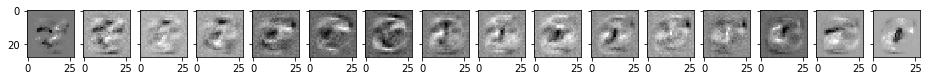

{'val_acc': 0.9160999953746796, 'train_acc': 0.9085333317518234, 'val_loss': 0.07771540507674217, 'train_loss': 0.08099058407048385}
Layer 0


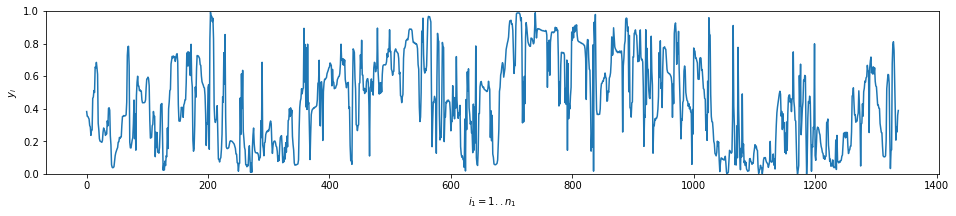

IntDer, Conv {'derivative': 148.20024, 'smoothness': 0.20981236}
Layer 1


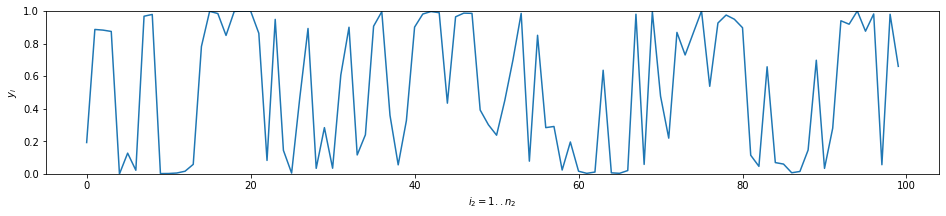

IntDer, Conv {'derivative': 103.3224, 'smoothness': 0.5182605}
Layer 2


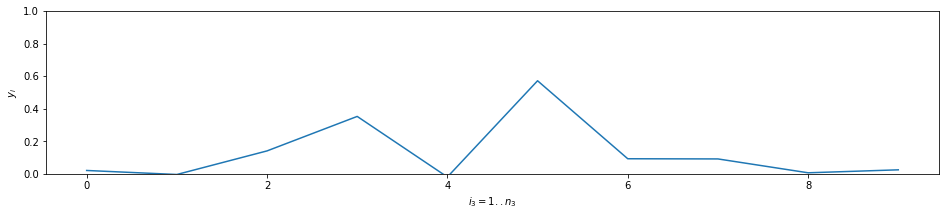

IntDer, Conv {'derivative': 69.03458, 'smoothness': 0.0}
True ans #0 5


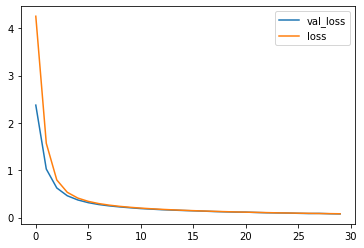

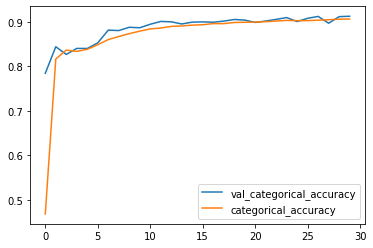

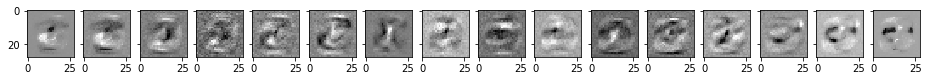

{'val_acc': 0.912200003862381, 'train_acc': 0.9059833327929179, 'val_loss': 0.07772288024425507, 'train_loss': 0.08074757978320121}
Layer 0


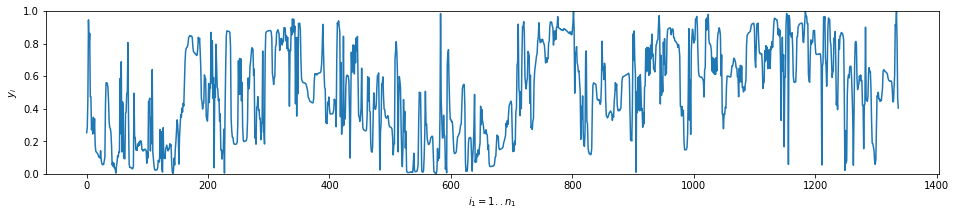

IntDer, Conv {'derivative': 146.14267, 'smoothness': 0.20866837}
Layer 1


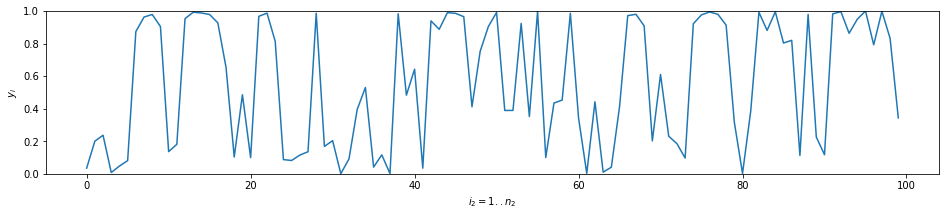

IntDer, Conv {'derivative': 104.463486, 'smoothness': 0.52021074}
Layer 2


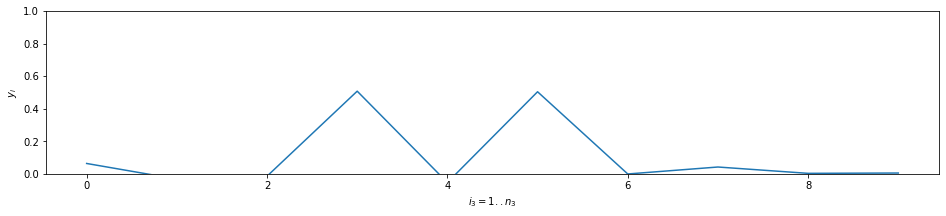

IntDer, Conv {'derivative': 65.17455, 'smoothness': 0.0}
True ans #0 5


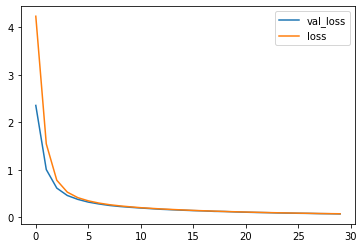

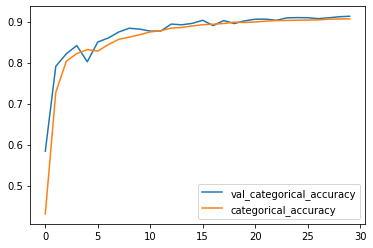

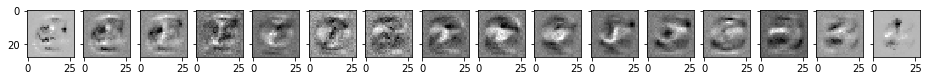

{'val_acc': 0.9131999969482422, 'train_acc': 0.9067166656255722, 'val_loss': 0.07340818271040916, 'train_loss': 0.07646900775531927}
Layer 0


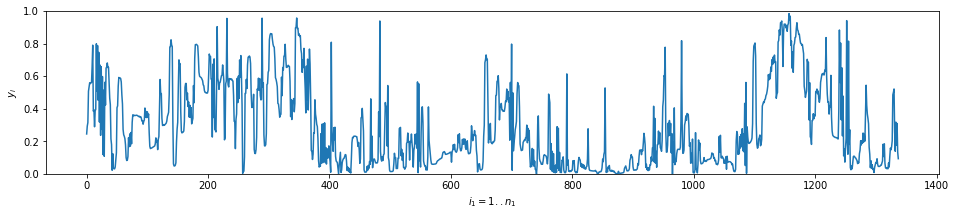

IntDer, Conv {'derivative': 146.40202, 'smoothness': 0.20855665}
Layer 1


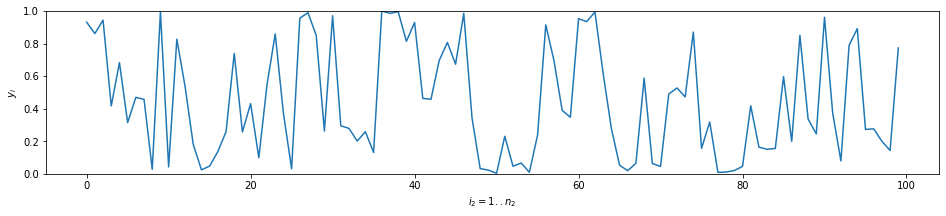

IntDer, Conv {'derivative': 84.477295, 'smoothness': 0.40758958}
Layer 2


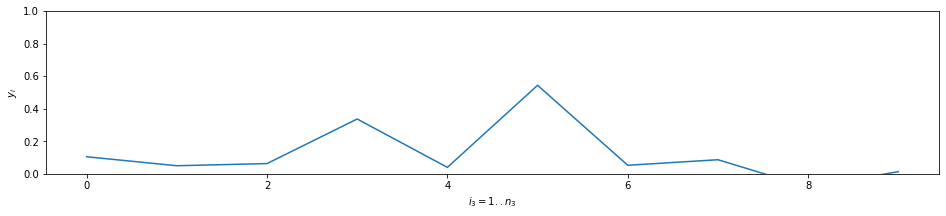

IntDer, Conv {'derivative': 69.57678, 'smoothness': 0.0}
True ans #0 5


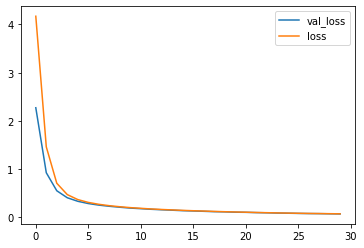

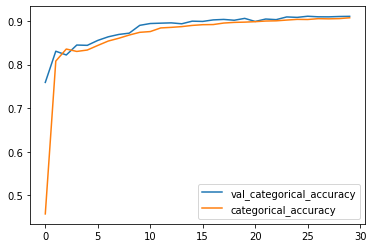

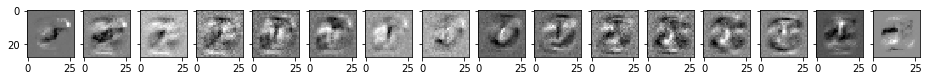

{'val_acc': 0.910700011253357, 'train_acc': 0.9073666661977768, 'val_loss': 0.07222417294979096, 'train_loss': 0.07432616502046585}
Layer 0


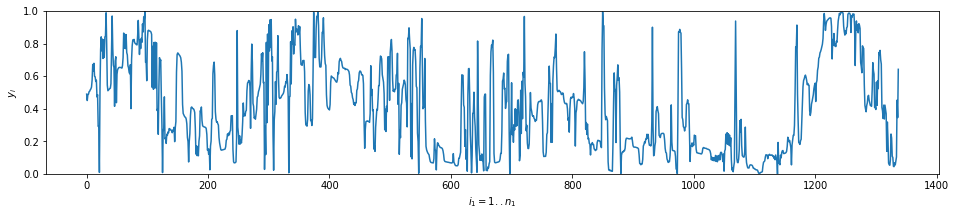

IntDer, Conv {'derivative': 149.76164, 'smoothness': 0.22092302}
Layer 1


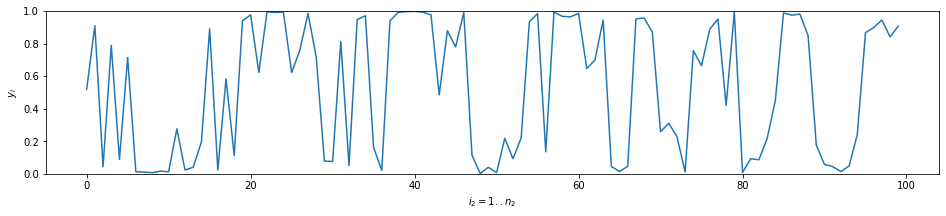

IntDer, Conv {'derivative': 79.246185, 'smoothness': 0.39548683}
Layer 2


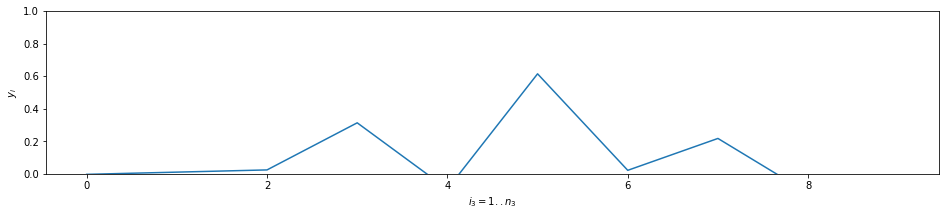

IntDer, Conv {'derivative': 69.82834, 'smoothness': 0.0}
True ans #0 5


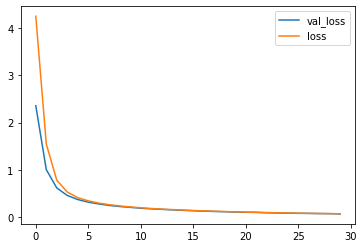

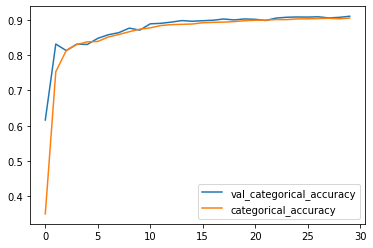

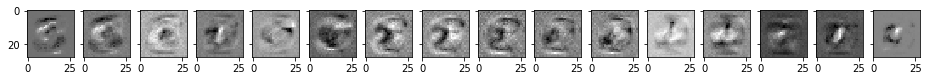

{'val_acc': 0.9103999972343445, 'train_acc': 0.9051666686932246, 'val_loss': 0.07430208772420883, 'train_loss': 0.07796778803070387}
Layer 0


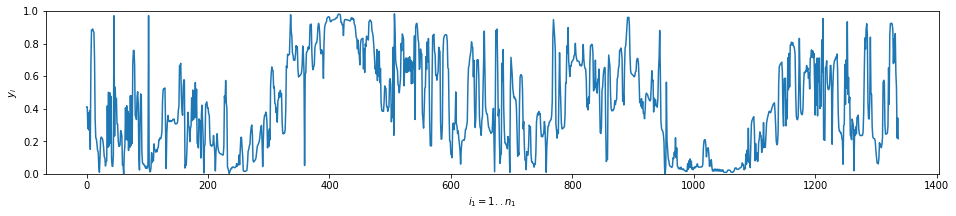

IntDer, Conv {'derivative': 148.99176, 'smoothness': 0.2271677}
Layer 1


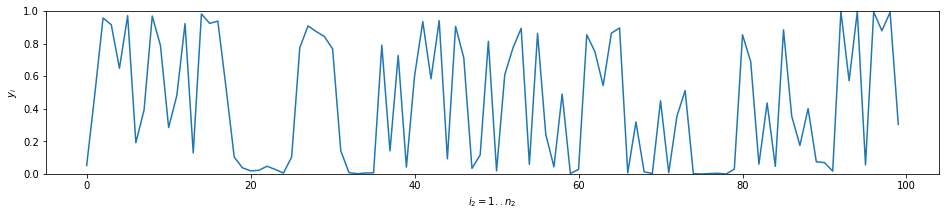

IntDer, Conv {'derivative': 88.30951, 'smoothness': 0.43453303}
Layer 2


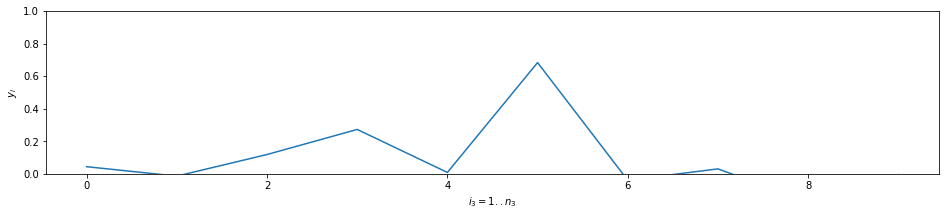

IntDer, Conv {'derivative': 68.86137, 'smoothness': 0.0}
True ans #0 5


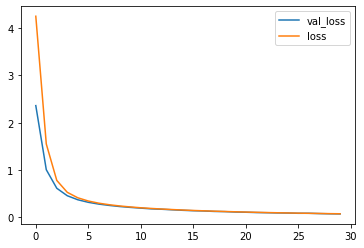

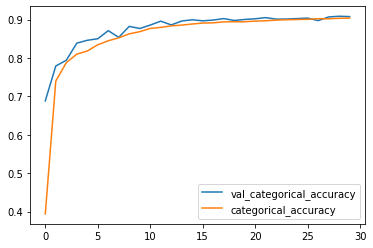

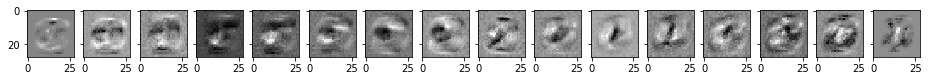

{'val_acc': 0.9077000021934509, 'train_acc': 0.9037500023841858, 'val_loss': 0.07453470975160599, 'train_loss': 0.0775616254657507}
Layer 0


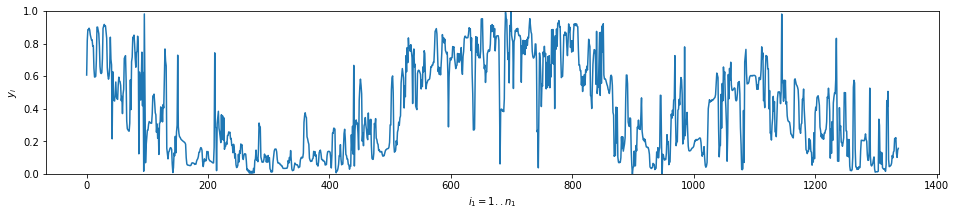

IntDer, Conv {'derivative': 146.81743, 'smoothness': 0.21612594}
Layer 1


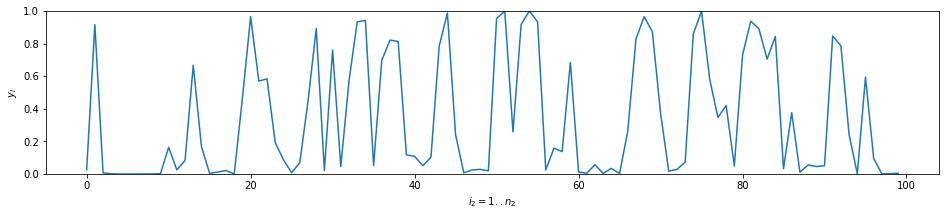

IntDer, Conv {'derivative': 91.01088, 'smoothness': 0.44466186}
Layer 2


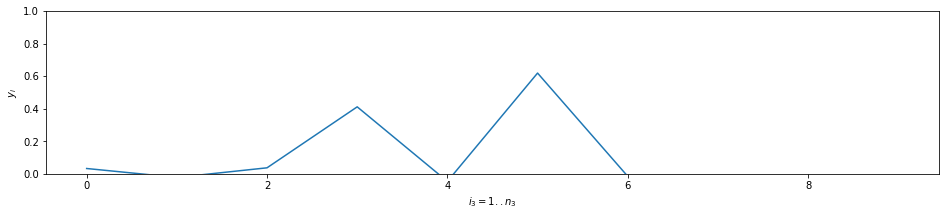

IntDer, Conv {'derivative': 73.225204, 'smoothness': 0.0}
True ans #0 5


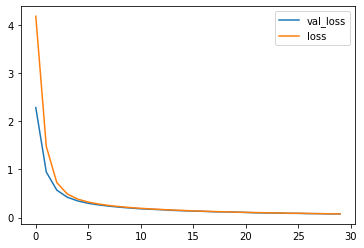

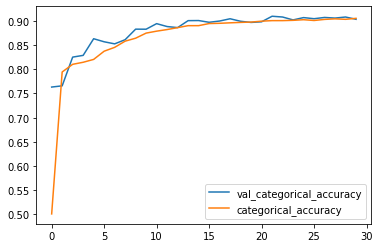

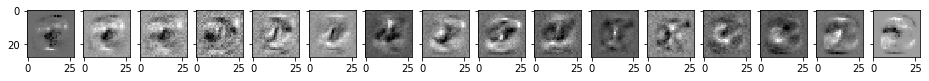

{'val_acc': 0.9033999979496002, 'train_acc': 0.9053833325703938, 'val_loss': 0.07815424203872681, 'train_loss': 0.0761151401946942}
Layer 0


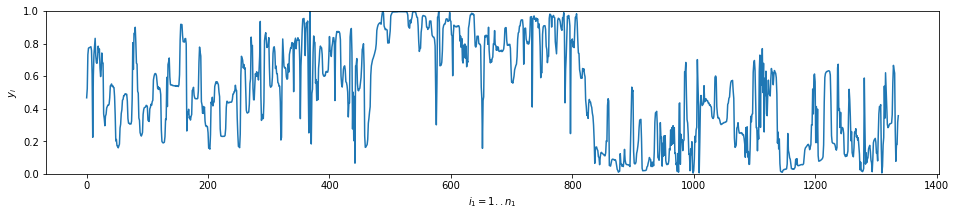

IntDer, Conv {'derivative': 150.6871, 'smoothness': 0.2189146}
Layer 1


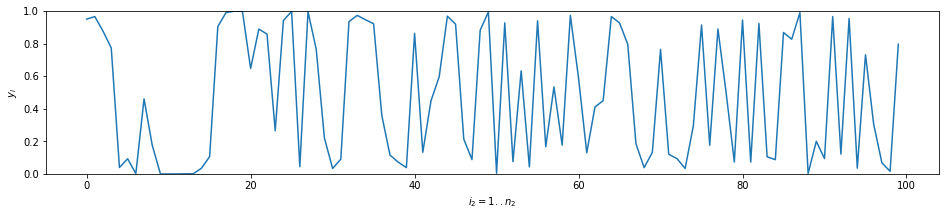

IntDer, Conv {'derivative': 92.185776, 'smoothness': 0.4615242}
Layer 2


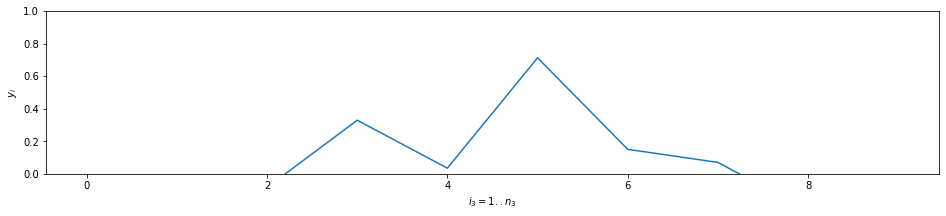

IntDer, Conv {'derivative': 68.04184, 'smoothness': 0.0}
True ans #0 5


 90%|█████████ | 9/10 [53:04<07:20, 440.97s/it]

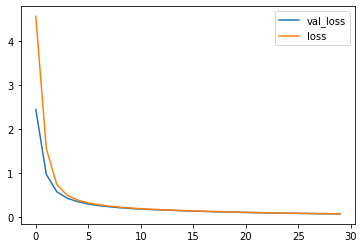

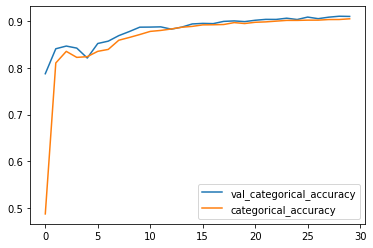

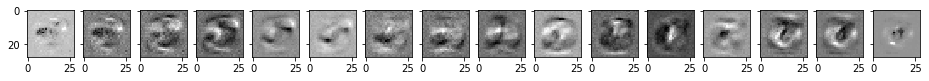

{'val_acc': 0.9100000023841858, 'train_acc': 0.9049000014861425, 'val_loss': 0.07289903610944748, 'train_loss': 0.07530031390488148}
Layer 0


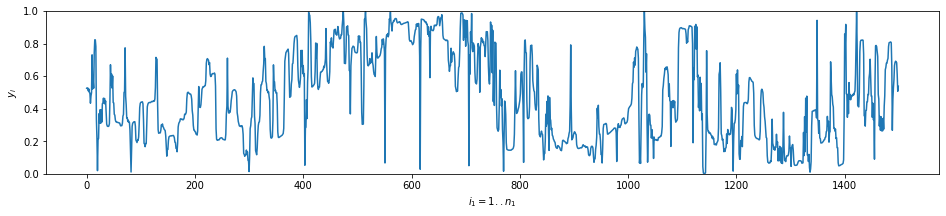

IntDer, Conv {'derivative': 160.2421, 'smoothness': 0.20336005}
Layer 1


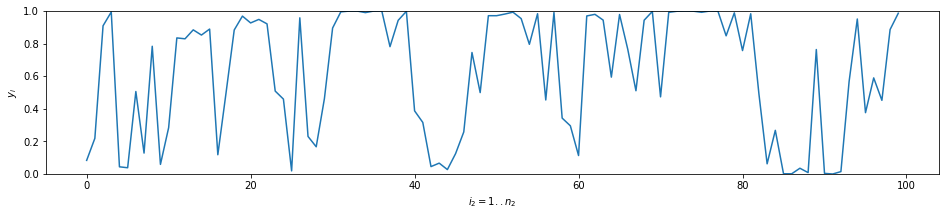

IntDer, Conv {'derivative': 87.483185, 'smoothness': 0.43507785}
Layer 2


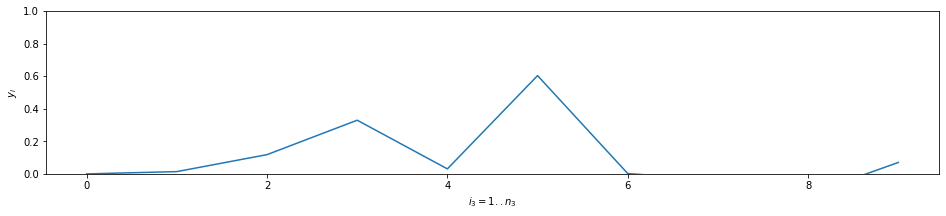

IntDer, Conv {'derivative': 68.96234, 'smoothness': 0.0}
True ans #0 5


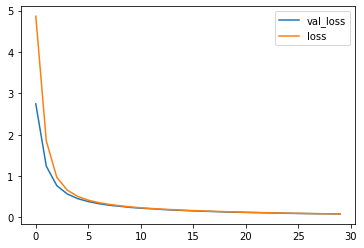

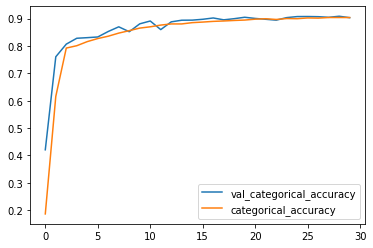

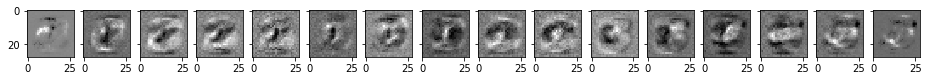

{'val_acc': 0.9032000064849853, 'train_acc': 0.9036666691303253, 'val_loss': 0.08408259004354476, 'train_loss': 0.08348892430464426}
Layer 0


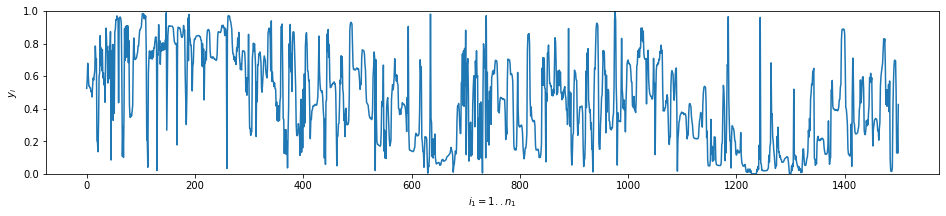

IntDer, Conv {'derivative': 164.69528, 'smoothness': 0.21651666}
Layer 1


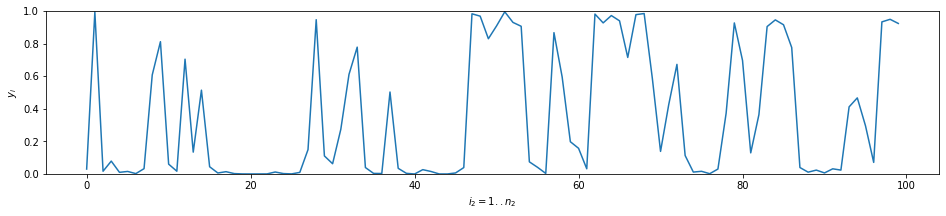

IntDer, Conv {'derivative': 104.06251, 'smoothness': 0.53546983}
Layer 2


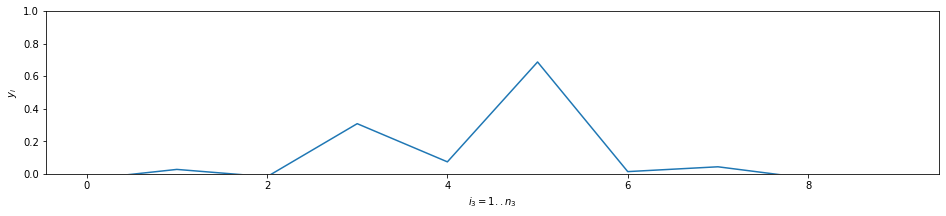

IntDer, Conv {'derivative': 70.536896, 'smoothness': 0.0}
True ans #0 5


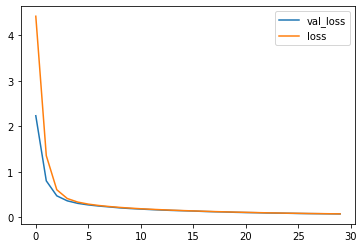

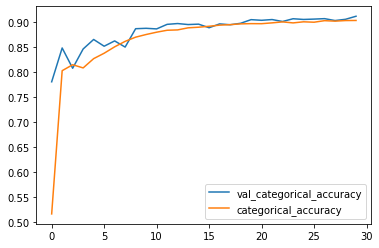

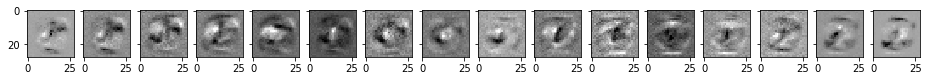

{'val_acc': 0.9119999945163727, 'train_acc': 0.9035833309094111, 'val_loss': 0.07208839878439903, 'train_loss': 0.07366785618166129}
Layer 0


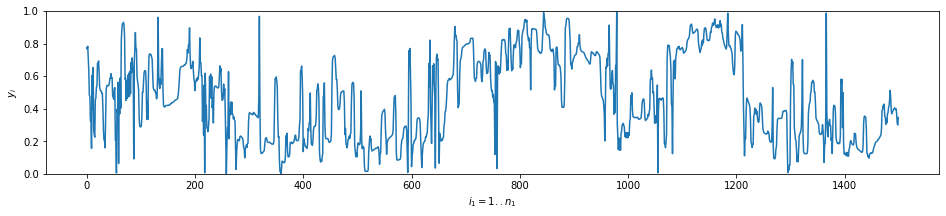

IntDer, Conv {'derivative': 158.27615, 'smoothness': 0.20748472}
Layer 1


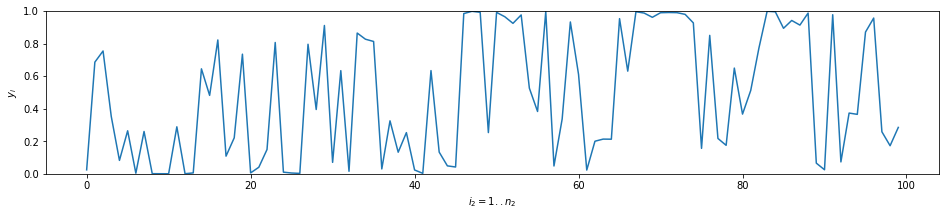

IntDer, Conv {'derivative': 77.725266, 'smoothness': 0.38932228}
Layer 2


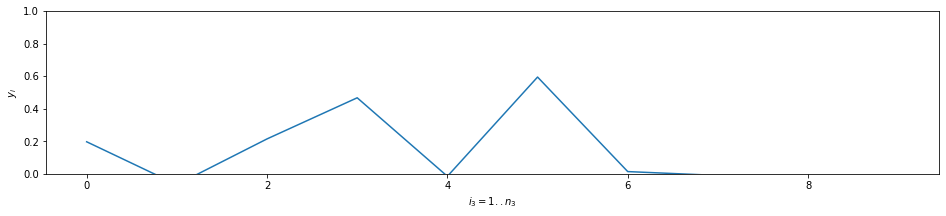

IntDer, Conv {'derivative': 67.71724, 'smoothness': 0.0}
True ans #0 5


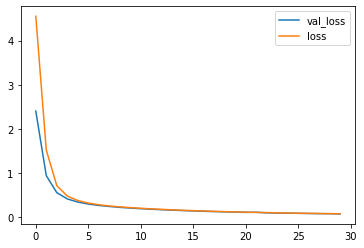

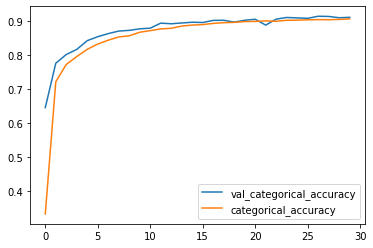

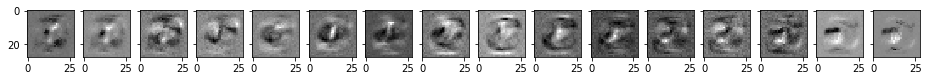

{'val_acc': 0.9112999975681305, 'train_acc': 0.9067833354075749, 'val_loss': 0.07532066404819489, 'train_loss': 0.07902821339666843}
Layer 0


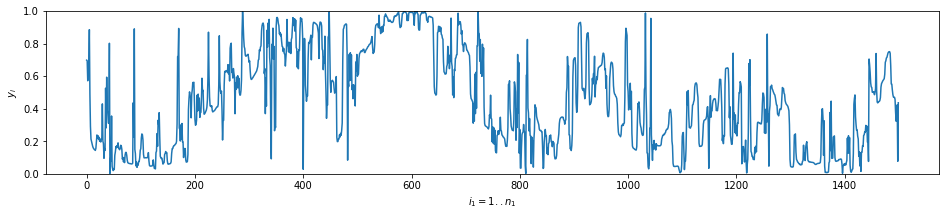

IntDer, Conv {'derivative': 156.27907, 'smoothness': 0.18041706}
Layer 1


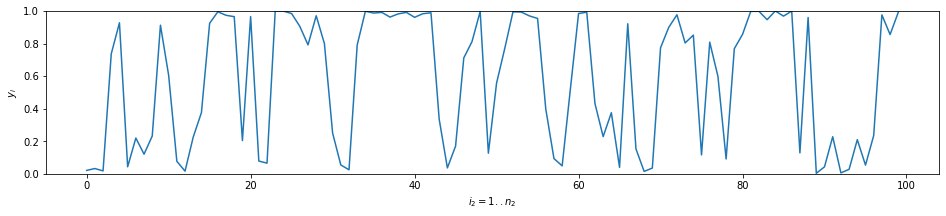

IntDer, Conv {'derivative': 94.92832, 'smoothness': 0.47473323}
Layer 2


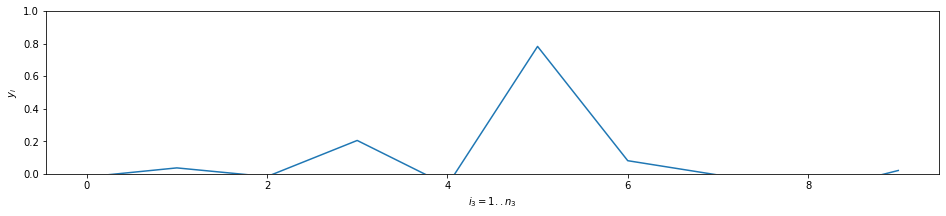

IntDer, Conv {'derivative': 67.67921, 'smoothness': 0.0}
True ans #0 5


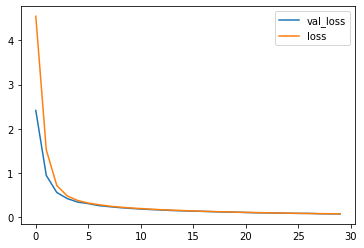

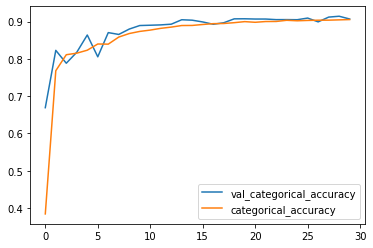

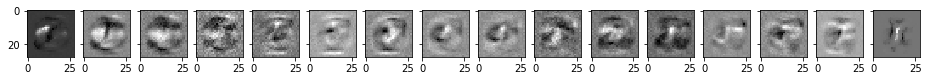

{'val_acc': 0.9067999958992005, 'train_acc': 0.9052833338578542, 'val_loss': 0.07353759631514549, 'train_loss': 0.07562677065531413}
Layer 0


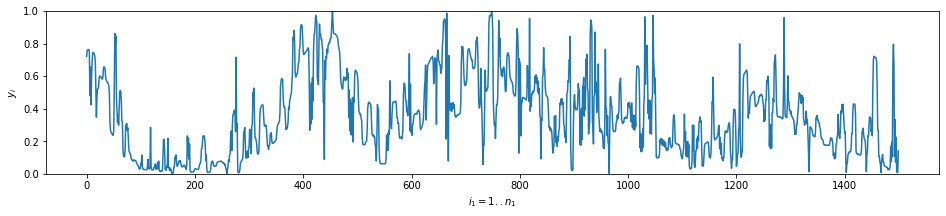

IntDer, Conv {'derivative': 161.10828, 'smoothness': 0.20129094}
Layer 1


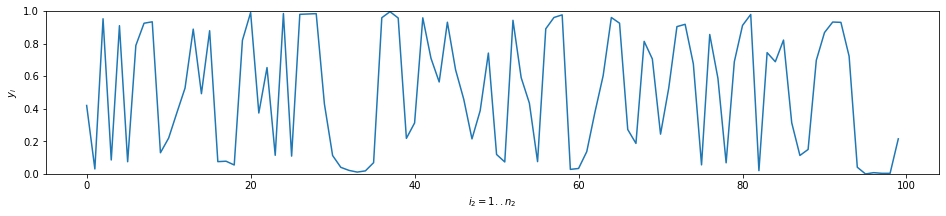

IntDer, Conv {'derivative': 84.30757, 'smoothness': 0.41620412}
Layer 2


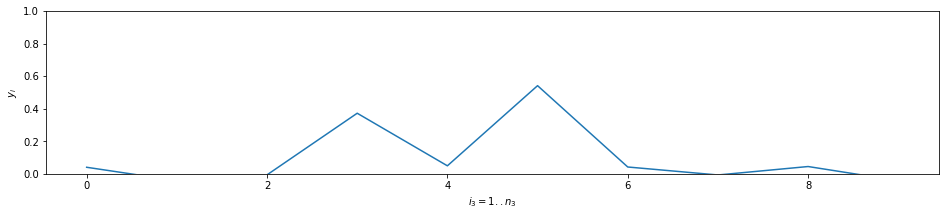

IntDer, Conv {'derivative': 69.125916, 'smoothness': 0.0}
True ans #0 5


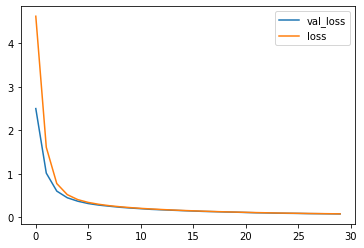

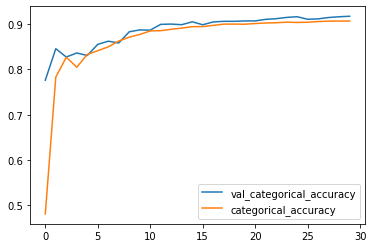

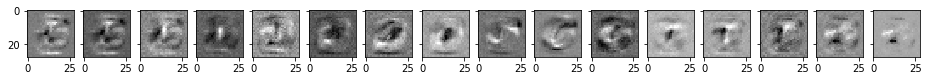

{'val_acc': 0.9175000011920929, 'train_acc': 0.9068833311398824, 'val_loss': 0.07726607024669647, 'train_loss': 0.07900062215824923}
Layer 0


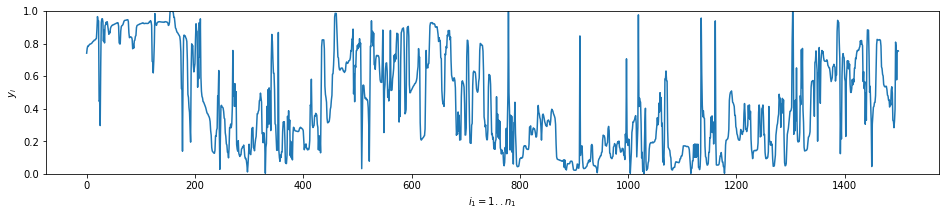

IntDer, Conv {'derivative': 160.02347, 'smoothness': 0.19734558}
Layer 1


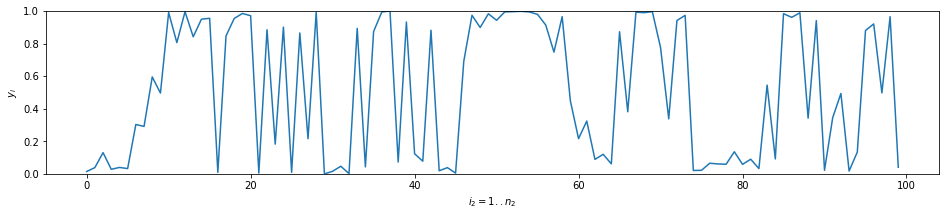

IntDer, Conv {'derivative': 98.1628, 'smoothness': 0.4985267}
Layer 2


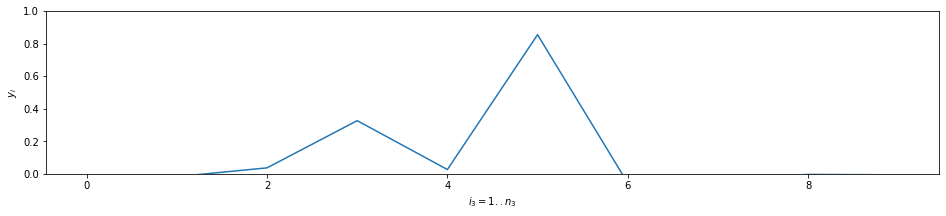

IntDer, Conv {'derivative': 70.407715, 'smoothness': 0.0}
True ans #0 5


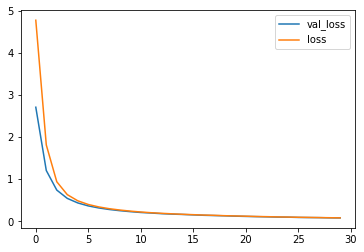

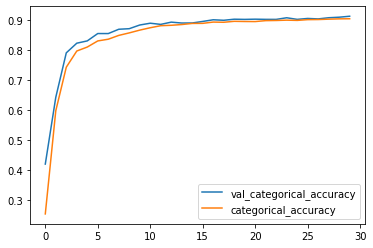

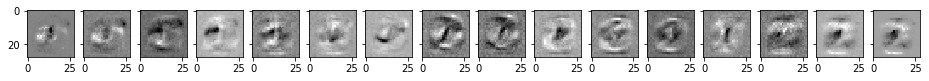

{'val_acc': 0.9134999990463257, 'train_acc': 0.9050999989112218, 'val_loss': 0.08219433873891831, 'train_loss': 0.08384120923777422}
Layer 0


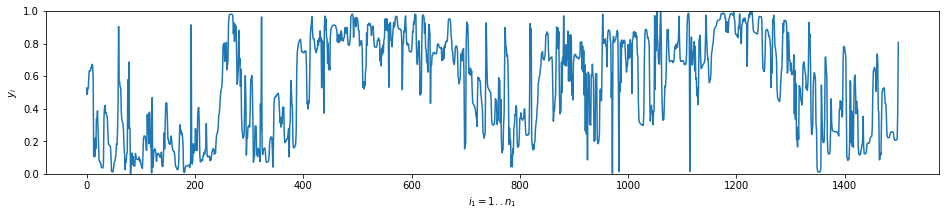

IntDer, Conv {'derivative': 162.59511, 'smoothness': 0.21670653}
Layer 1


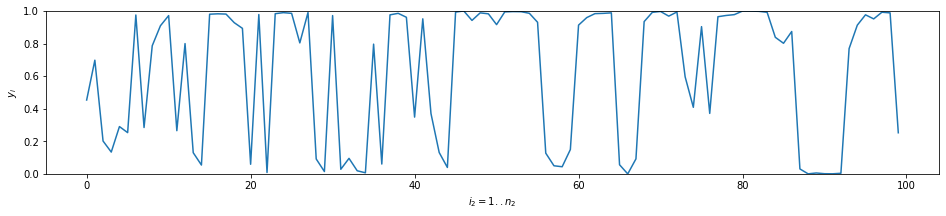

IntDer, Conv {'derivative': 112.46236, 'smoothness': 0.59464574}
Layer 2


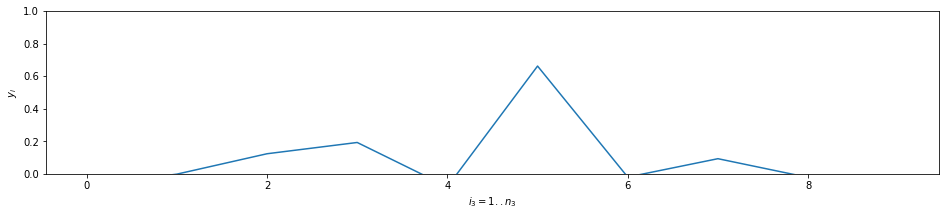

IntDer, Conv {'derivative': 68.56019, 'smoothness': 0.0}
True ans #0 5


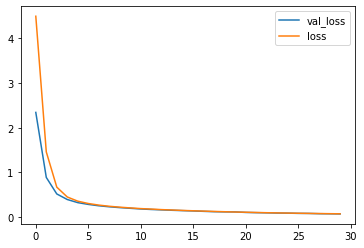

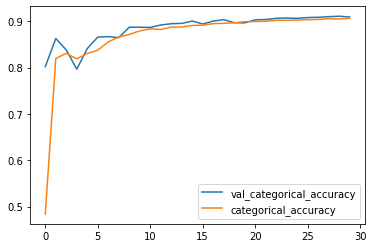

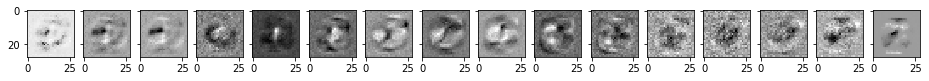

{'val_acc': 0.9092000007629395, 'train_acc': 0.9065000027418136, 'val_loss': 0.07424269691109657, 'train_loss': 0.07683971263468266}
Layer 0


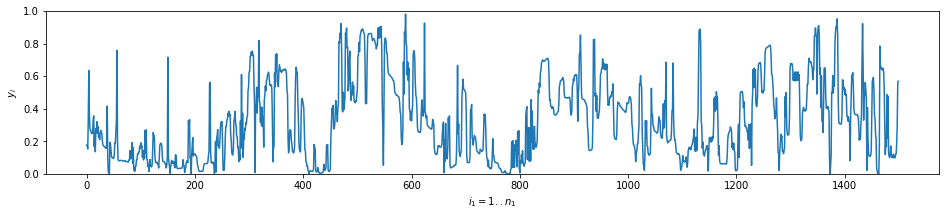

IntDer, Conv {'derivative': 163.75648, 'smoothness': 0.23826799}
Layer 1


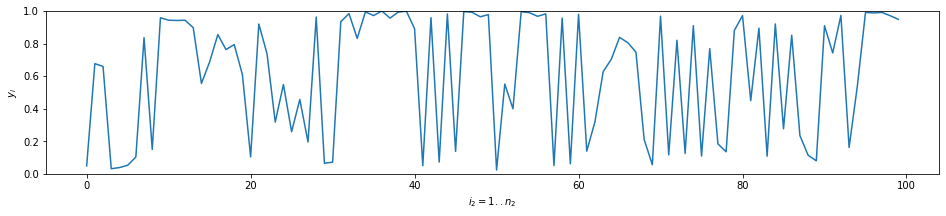

IntDer, Conv {'derivative': 80.27092, 'smoothness': 0.37988773}
Layer 2


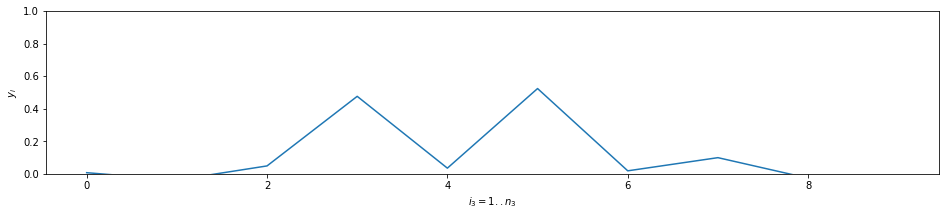

IntDer, Conv {'derivative': 67.923904, 'smoothness': 0.0}
True ans #0 5


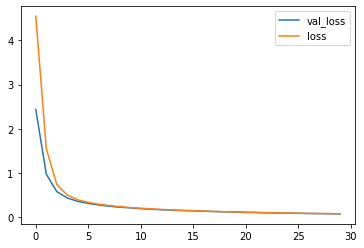

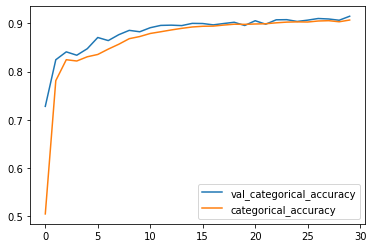

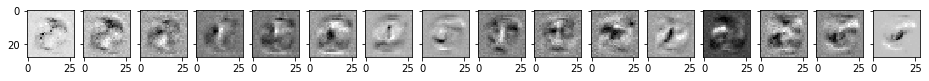

{'val_acc': 0.9149999976158142, 'train_acc': 0.9071166704098383, 'val_loss': 0.07400818988680839, 'train_loss': 0.07685452625155449}
Layer 0


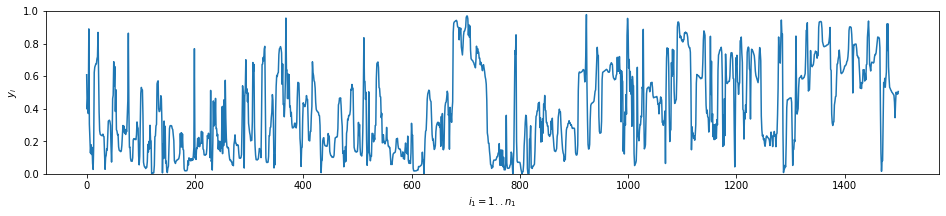

IntDer, Conv {'derivative': 162.21362, 'smoothness': 0.22618216}
Layer 1


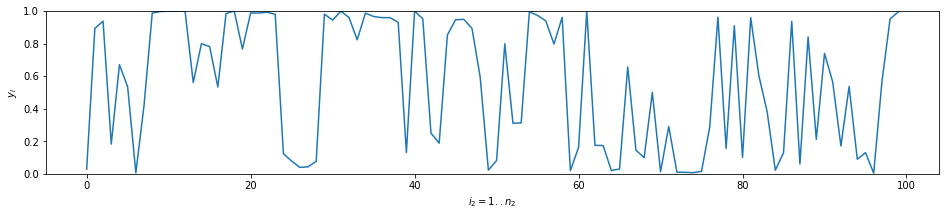

IntDer, Conv {'derivative': 79.060394, 'smoothness': 0.37460268}
Layer 2


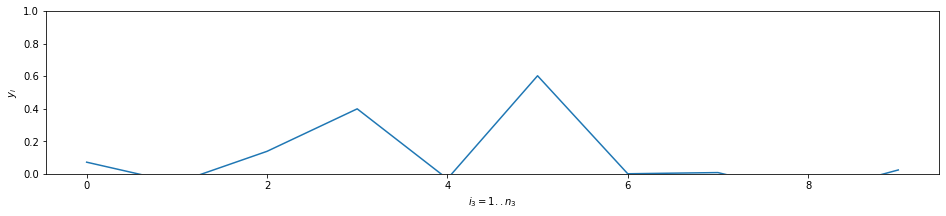

IntDer, Conv {'derivative': 69.94801, 'smoothness': 0.0}
True ans #0 5


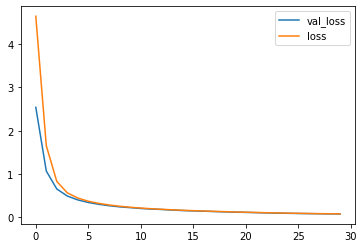

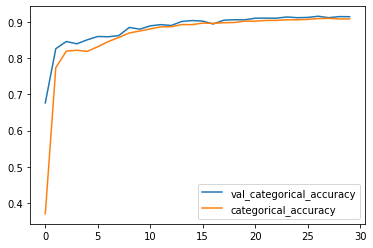

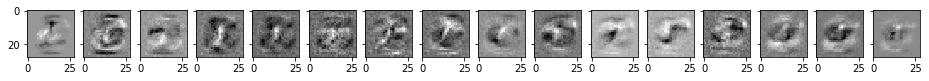

{'val_acc': 0.913700008392334, 'train_acc': 0.9074166655540467, 'val_loss': 0.07826799228787422, 'train_loss': 0.07913125020762285}
Layer 0


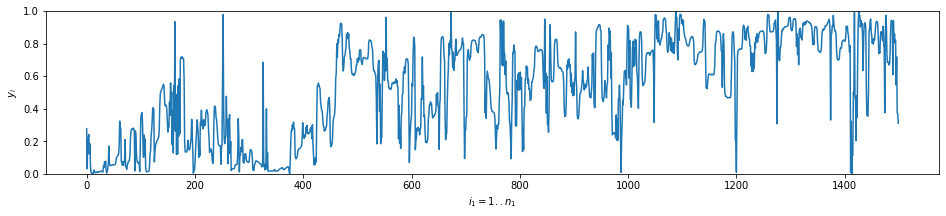

IntDer, Conv {'derivative': 161.9743, 'smoothness': 0.22911298}
Layer 1


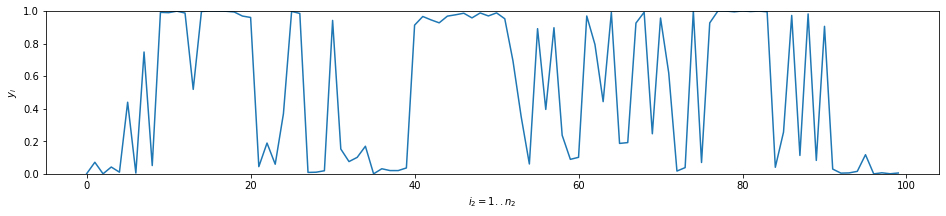

IntDer, Conv {'derivative': 90.88674, 'smoothness': 0.44755635}
Layer 2


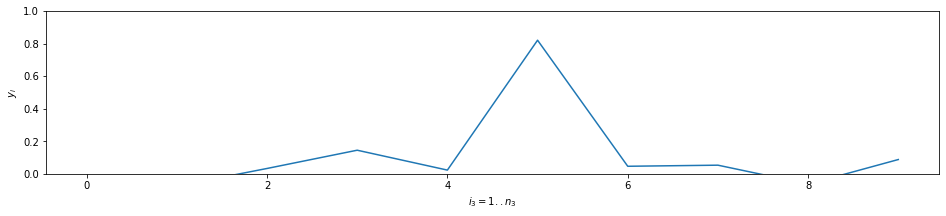

IntDer, Conv {'derivative': 74.54003, 'smoothness': 0.0}
True ans #0 5


100%|██████████| 10/10 [1:03:27<00:00, 380.72s/it]


In [28]:
# measuring...
results = get_results(Ns, repetitions, parameters, to_run)

In [29]:
pickle_w(results, "FaultTolerance-Continuity-FC-MNIST")

In [5]:
# filters at L1 look random when no regular/ization with continuity!

In [6]:
# loading results from a file
results = pickle_r("FaultTolerance-Continuity-FC-MNIST")

In [7]:
font = {'family' : 'normal',
        'weight' : 'normal',
        'size'   : 20}

matplotlib.rc('font', **font)

findfont: Font family ['normal'] not found. Falling back to DejaVu Sans.
findfont: Font family ['normal'] not found. Falling back to DejaVu Sans.


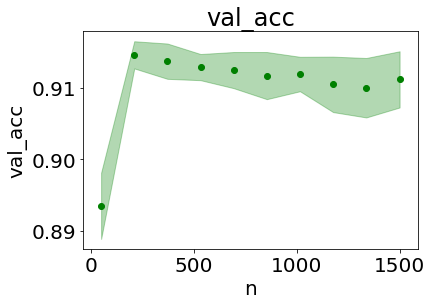

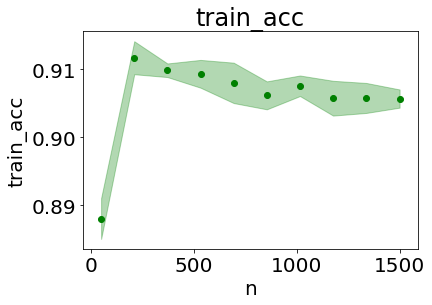

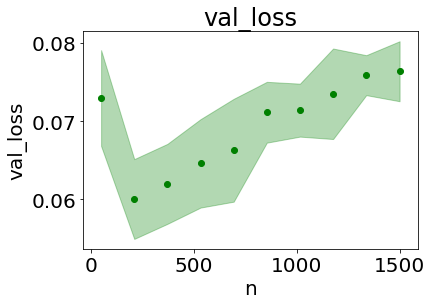

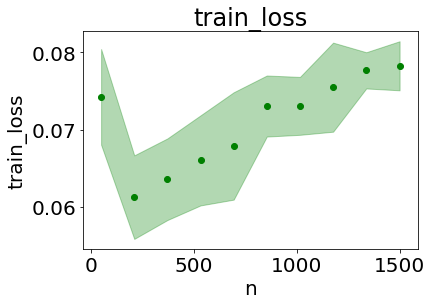

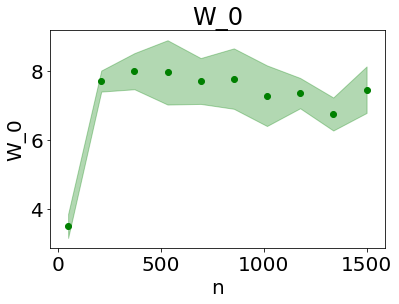

...

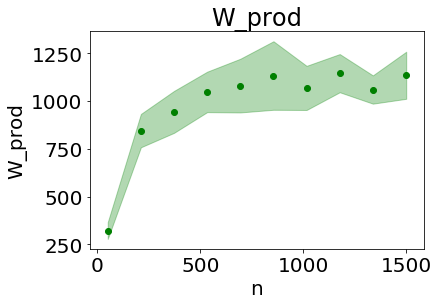

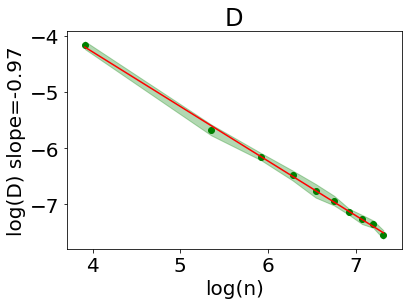

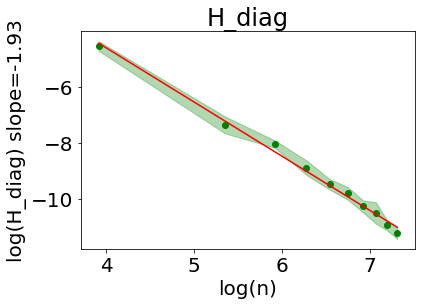

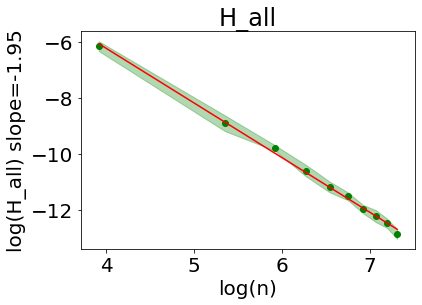

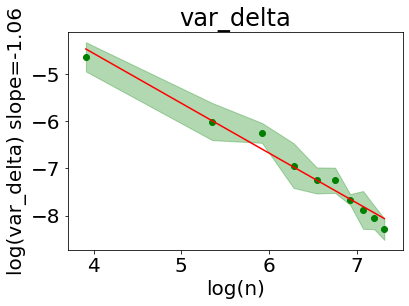

In [8]:
plot_results(Ns, results, name = 'FaultTolerance-Continuity-FC-MNIST')

Plotting VarDelta for the paper

In [14]:
font = {'family' : 'normal',
        'weight' : 'normal',
        'size'   : 15}
matplotlib.rc('font', **font)

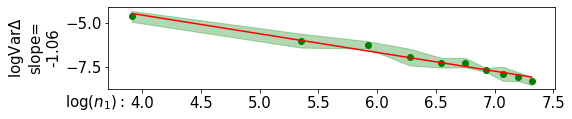

In [24]:
# obtaining the data
xs = Ns
key = 'var_delta'
slopes = {'var_delta': -1}
ys = get_arr(key, results)

# one of metrics for which we need a slope -> log scale + fitting a curve
if key in slopes:
    xs = np.log(xs)
    ys = np.log(ys)

# mean/std
ys_mean = np.mean(ys, axis=1)
ys_std = np.std(ys, axis=1)

# plotting mean/std
plt.figure(figsize=(8,1.5))
plt.fill_between(xs, ys_mean - ys_std, ys_mean +
                 ys_std, alpha=0.3, color='green')
plt.scatter(xs, ys_mean, color='green')

# one of metrics for which we need a slope -> log scale + fitting a curve
if key in slopes:
    # get desired slope (-1/-2)
    slope = slopes[key]

    # fitting the curve
#            fcn = partial(line_1_bias, coeff = slope)
    fcn = line_1_bias

    C = curve_fit(fcn, xs, ys_mean)[0]

    plt.plot(xs, fcn(xs, *C), color='red')

    plt.xlabel('$\log(n_1):$')
    plt.ylabel('logVar$\Delta$\nslope=\n%.2f' % (C[1]))
else:
    plt.xlabel('n')
    plt.ylabel('%s' % key)

cur_axes = plt.gca()
cur_axes.axes.get_xaxis().set_label_coords(-0.03,-0.05)
    
#plt.title('%s' % (key))
plt.savefig('figures/FaultTolerance-Continuity-FC-MNIST.pdf', bbox_inches='tight')
plt.show()